<a href="https://colab.research.google.com/github/BrainConnection/Dynamical_Decoupling_Project/blob/main/5.%201Q%20DD%20(12).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Environment Setting



In [1]:
!pip install qutip
!pip install numpy
!pip install matplotlib
!pip install scipy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.0/28.0 MB 18.8 MB/s eta 0:00:00


In [2]:
from qutip import *
import numpy as np
import matplotlib.pyplot as plt
import scipy.interpolate
from scipy.optimize import curve_fit

# CP CPMG UDD XY4 XY8 XY16 Sequence

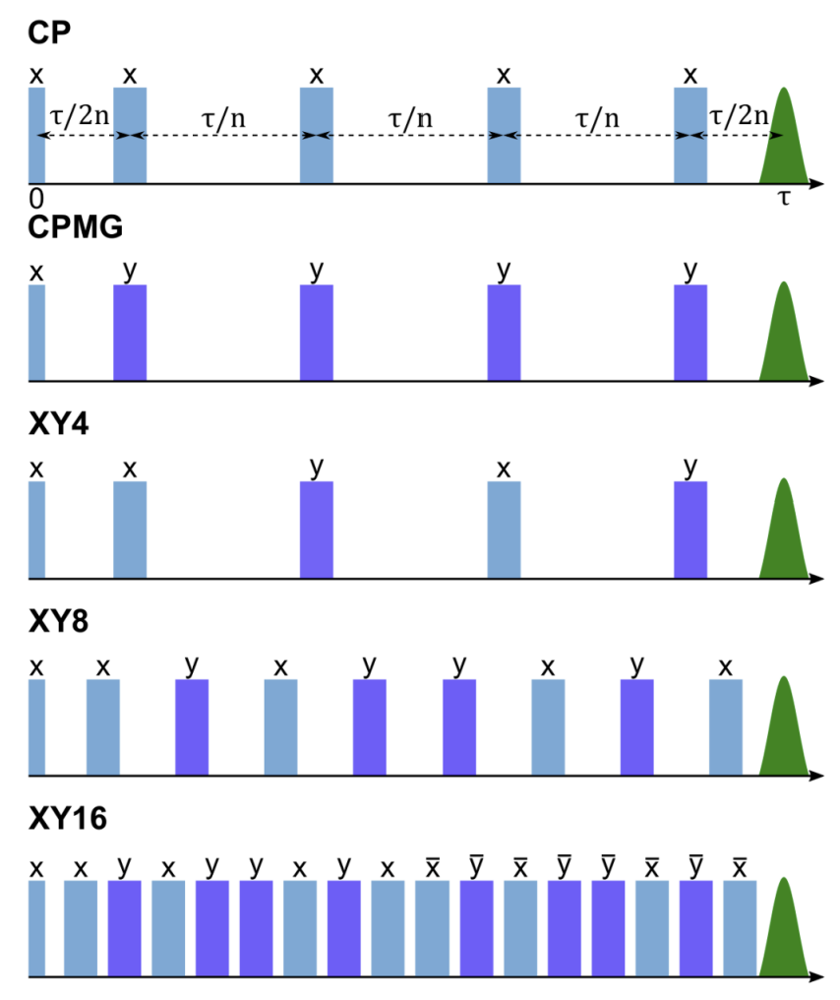

In [3]:
# Modulate each pulse timing (Equivalent Spacing)
# pulse list
# skip pi/2 pulse at T_srt, T_end
# pi pulse at pulse time list

def Pulse_Timing(T_srt, T_end, N):

    T = T_end - T_srt
    Seq_list = []
    for i in range(N):
      Seq_list.append(T_srt + (2*i+1)*T/(2*N))

    Seq = np.array(Seq_list)

    return Seq


# Modulate each pulse timing (Sinusoidal Spacing)
# pulse list
# skip pi/2 pulse at T_srt, T_end
# pi pulse at pulse time list

def Pulse_Timing_UDD(T_srt, T_end, N):

    T = T_end - T_srt
    Seq_list = []

    shift = 0
    for i in range(N):
      shift = shift + T * np.sin(np.pi/(2*(N+2))) * np.sin(np.pi*(i+1)/(N+2)) / np.cos(np.pi/(2*(N+2)))
      Seq_list.append(T_srt + shift)

    Seq = np.array(Seq_list)

    return Seq

In [4]:
# Single Square Pulse Envolope

def Single_pulse_env(t, B, T_cent):

    return B * (t > T_cent-0.5*np.pi/B) * (t < T_cent+0.5*np.pi/B)


# Single Square Pulse (lab frame)

def Single_pulse(t, B, Omega_qd, T_cent, Phi_qd):

    return Single_pulse_env(t, B, T_cent) * np.cos(Omega_qd * t + Phi_qd)

In [5]:
# time-dependent coefficient for resonator drive

def Hrd_rotating_frame(t, args):
    """
    Envelope function for the readout drive
    """
    A = args['A'] # amplitude of the readout drive
    T_srt = args['T_srt_r'] # duration of the readout drive, in units of ns
    T_end = args['T_end_r'] # duration of the readout drive, in units of ns

    return A * (T_srt <= t) * (t <= T_end)


def Hrd_lab_frame(t, args):
    omega_rd = args['Omega_rd']
    return Hrd_rotating_frame(t, args) * np.cos(omega_rd * t)

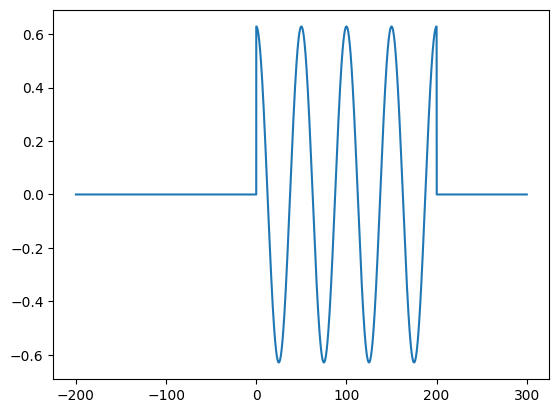

In [6]:
# resonator drive pulse simulation

tlist = np.linspace(-200, 300, 10000)
plt.figure()
plt.plot(tlist, Hrd_lab_frame(tlist, {'A': 2*np.pi*0.1, 'T_srt_r': 0, 'T_end_r': 200, 'Omega_rd': 2*np.pi*0.02}))

## CP CPMG UDD Sequence

In [7]:
# CP (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)
# N_seq (number of pulse)

def CP_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    N = args['N_seq']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing(T_srt, T_end, N)
    pulse = 0

    for T_cent in Seq:
      pulse = pulse + Single_pulse(t, B, Omega_qd, T_cent, 0)

    return pulse

In [8]:
# CPMG (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)
# N_seq (number of pulse)

def CPMG_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    N = args['N_seq']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing(T_srt, T_end, N)
    pulse = 0

    for T_cent in Seq:
      pulse = pulse + Single_pulse(t, B, Omega_qd, T_cent, 0.5*np.pi)

    return pulse

In [9]:
# CPMG (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)
# N_seq (number of pulse)

def UDD_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    N = args['N_seq']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing_UDD(T_srt, T_end, N)
    pulse = 0

    for T_cent in Seq:
      pulse = pulse + Single_pulse(t, B, Omega_qd, T_cent, 0.5*np.pi)

    return pulse

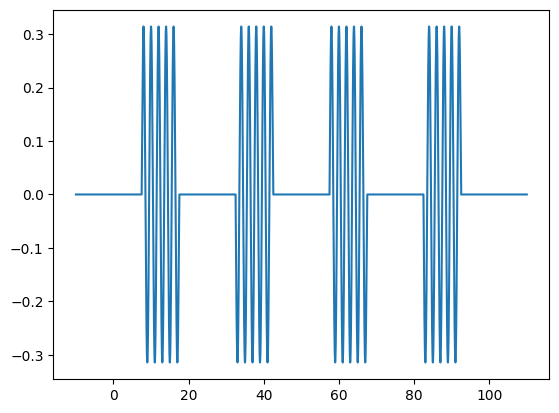

In [10]:
# qubit drive pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, CP_lab_frame(tlist, {'B': 2*np.pi*0.05, 'T_srt_q': 0, 'T_end_q': 100, 'N_seq': 4, 'Omega_qd': 2*np.pi*0.5}))

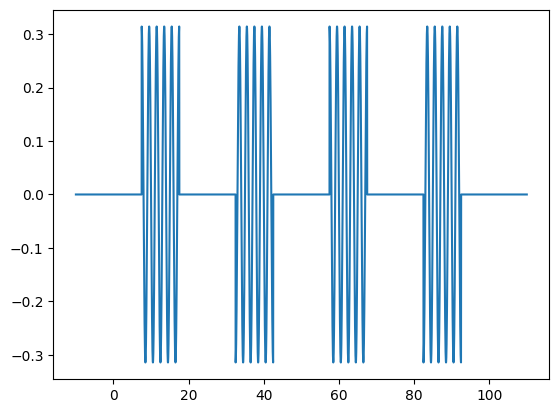

In [11]:
# qubit drive pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, CPMG_lab_frame(tlist, {'B': 2*np.pi*0.05, 'T_srt_q': 0, 'T_end_q': 100, 'N_seq': 4, 'Omega_qd': 2*np.pi*0.5}))

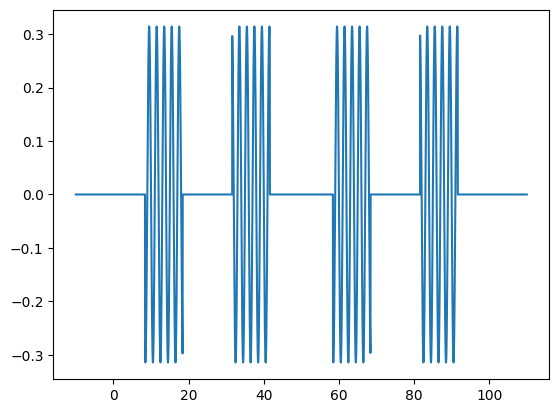

In [12]:
# qubit drive pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, UDD_lab_frame(tlist, {'B': 2*np.pi*0.05, 'T_srt_q': 0, 'T_end_q': 100, 'N_seq': 4, 'Omega_qd': 2*np.pi*0.5}))

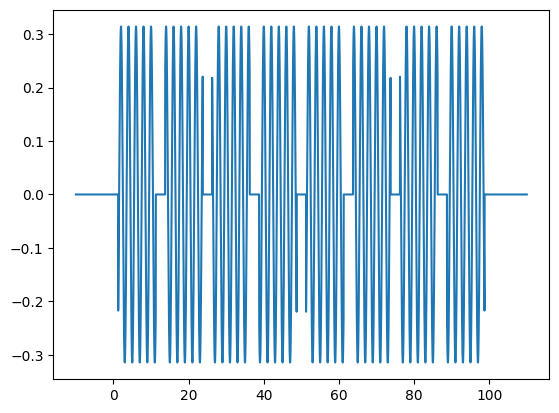

In [13]:
# qubit drive pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, CP_lab_frame(tlist, {'B': 2*np.pi*0.05, 'T_srt_q': 0, 'T_end_q': 100, 'N_seq': 8, 'Omega_qd': 2*np.pi*0.5}))

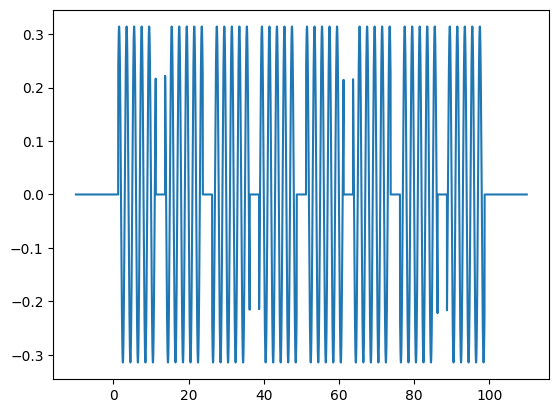

In [14]:
# qubit drive pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, CPMG_lab_frame(tlist, {'B': 2*np.pi*0.05, 'T_srt_q': 0, 'T_end_q': 100, 'N_seq': 8, 'Omega_qd': 2*np.pi*0.5}))

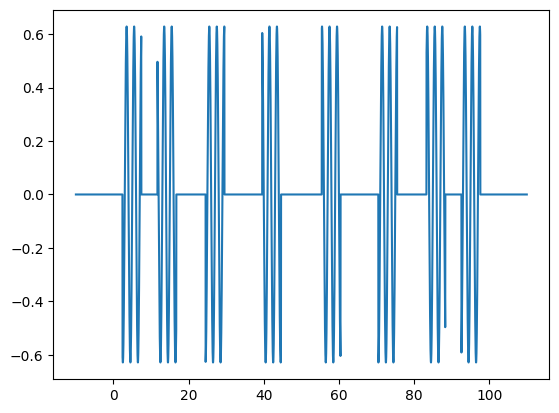

In [15]:
# qubit drive pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, UDD_lab_frame(tlist, {'B': 2*np.pi*0.1, 'T_srt_q': 0, 'T_end_q': 100, 'N_seq': 8, 'Omega_qd': 2*np.pi*0.5}))

## XY4 XY8 XY16 Sequence

In [16]:
# XY4 (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)

def XY4_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing(T_srt, T_end, 4)
    pulse = 0

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[0], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[1], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[2], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[3], 1.0*np.pi)

    return pulse

In [17]:
# XY8 (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)

def XY8_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing(T_srt, T_end, 8)
    pulse = 0

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[0], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[1], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[2], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[3], 0.5*np.pi)

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[4], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[5], 1.0*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[6], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[7], 1.0*np.pi)

    return pulse

In [18]:
# XY16 (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)

def XY16_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing(T_srt, T_end, 16)
    pulse = 0

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[0], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[1], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[2], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[3], 0.5*np.pi)

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[4], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[5], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[6], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[7], 0)

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[8], np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[9], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[10], np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[11], 1.5*np.pi)

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[12], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[13], np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[14], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[15], np.pi)

    return pulse

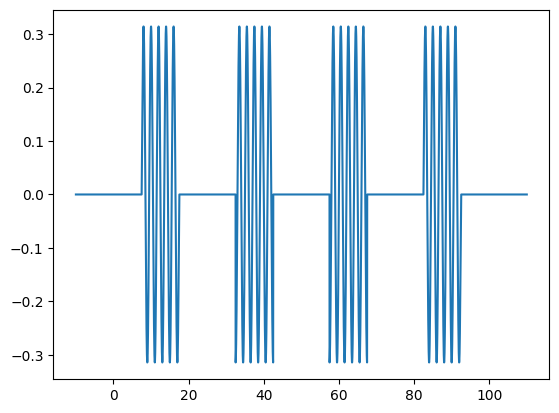

In [19]:
# qubit pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, XY4_lab_frame(tlist, {'B': 2*np.pi*0.05, 'T_srt_q': 0, 'T_end_q': 100, 'Omega_qd': 2*np.pi*0.5}))

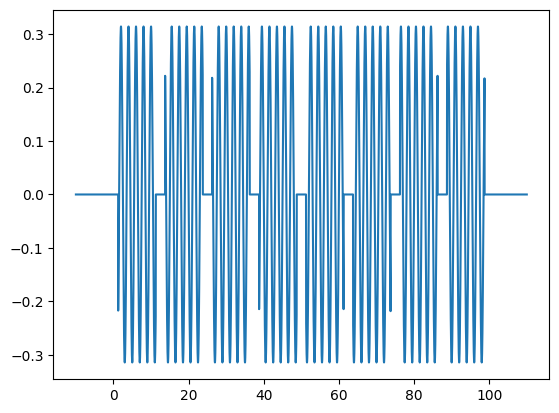

In [20]:
# qubit pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, XY8_lab_frame(tlist, {'B': 2*np.pi*0.05, 'T_srt_q': 0, 'T_end_q': 100, 'Omega_qd': 2*np.pi*0.5}))

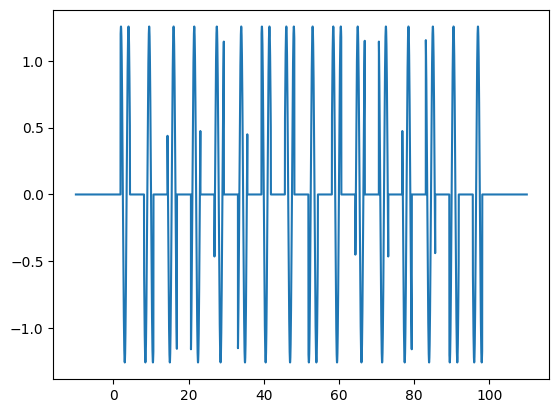

In [21]:
# qubit pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, XY16_lab_frame(tlist, {'B': 2*np.pi*0.2, 'T_srt_q': 0, 'T_end_q': 100, 'Omega_qd': 2*np.pi*0.5}))

## UDD4 UDD8 UDD16 Sequence

In [22]:
# UDD4 (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)

def UDD4_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing_UDD(T_srt, T_end, 4)
    pulse = 0

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[0], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[1], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[2], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[3], 0.5*np.pi)

    return pulse

In [23]:
# UDD8 (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)

def UDD8_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing_UDD(T_srt, T_end, 8)
    pulse = 0

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[0], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[1], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[2], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[3], 0.5*np.pi)

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[4], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[5], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[6], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[7], 0)

    return pulse

In [24]:
# UDD16 (lab frame)

# args

# B (qubit drive amplitude)
# Omega_qd (qubit drive frequency)
# T_srt (pulse start time)
# T_end (pulse end time)

def UDD16_lab_frame(t, args):

    Omega_qd = args['Omega_qd']
    T_srt = args['T_srt_q']
    T_end = args['T_end_q']
    B = args['B']

    # T_cent
    Seq = Pulse_Timing_UDD(T_srt, T_end, 16)
    pulse = 0

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[0], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[1], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[2], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[3], 0.5*np.pi)

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[4], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[5], 0)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[6], 0.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[7], 0)

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[8], np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[9], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[10], np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[11], 1.5*np.pi)

    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[12], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[13], np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[14], 1.5*np.pi)
    pulse = pulse + Single_pulse(t, B, Omega_qd, Seq[15], np.pi)

    return pulse

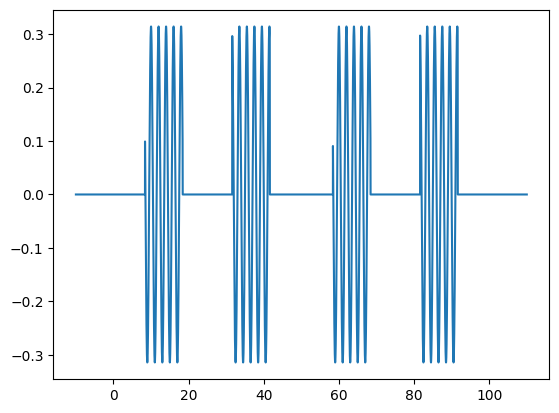

In [25]:
# qubit pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, UDD4_lab_frame(tlist, {'B': 2*np.pi*0.05, 'T_srt_q': 0, 'T_end_q': 100, 'Omega_qd': 2*np.pi*0.5}))

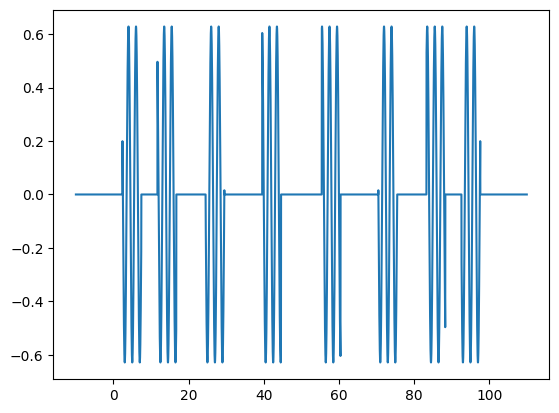

In [26]:
# qubit pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, UDD8_lab_frame(tlist, {'B': 2*np.pi*0.1, 'T_srt_q': 0, 'T_end_q': 100, 'Omega_qd': 2*np.pi*0.5}))

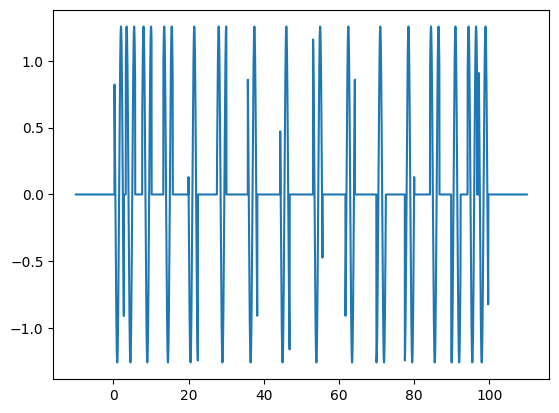

In [27]:
# qubit pulse simulation
tlist = np.linspace(-10, 110, 10000)
plt.figure()
plt.plot(tlist, UDD16_lab_frame(tlist, {'B': 2*np.pi*0.2, 'T_srt_q': 0, 'T_end_q': 100, 'Omega_qd': 2*np.pi*0.5}))

# Dynamical Decoupling Simulation

$ \omega_{qd} = \omega_q^b + \chi $

Evolution time 1000ns

Initial state $ \cos(\frac{1\pi}{4}) |0\rangle + e^{j\frac{1\pi}{4}} \sin(\frac{1\pi}{4}) |1\rangle $

In [ ]:
N = 5

omega_r = 2 * np.pi * 7.0     # resonator frequency in units of GHz
omega_q = 2 * np.pi * 6.0     # qubit frequency in units of GHz

g = 2 * np.pi * 0.1           # qubit-resonator coupling in units of GHz
kappa = 2 * np.pi * 0.01      # resonator linewidth in units of GHz

detune = omega_q-omega_r
chi = g*g/(detune)

omega_rd = omega_r            # qubit frequency in units of GHz
omega_qd = omega_q + chi      # qubit frequency in units of GHz

sx = sigmax()
sy = sigmay()
sz = sigmaz()
sp = basis(2,1)*basis(2,0).dag()
sm = basis(2,0)*basis(2,1).dag()
a = destroy(N)

sx_composite = tensor(sx, qeye(N))
sy_composite = tensor(sy, qeye(N))
sz_composite = tensor(sz, qeye(N))
sp_composite = tensor(sp, qeye(N))
number_composite = tensor(qeye(2), a.dag()*a)

op_list = [sx_composite, sy_composite, sz_composite, sp_composite, number_composite]

tlist = np.linspace(0, 1000, 10000)
T_end_q = 1000

cos = np.sqrt(0.5 + 0.5*5/np.sqrt(26))
sin = np.sqrt(0.5 - 0.5*5/np.sqrt(26))


psi_20 = tensor(basis(2,0), basis(N,0))
psi_21 = cos*tensor(basis(2,1), basis(N,0)) - sin*tensor(basis(2,0), basis(N,1))
psi_2s = np.cos(1*np.pi/4) * psi_20 + np.exp(1j*np.pi*1/4) * np.sin(1*np.pi/4) * psi_21


H0 = -0.5*omega_q*sz_composite + omega_r*number_composite + g*(tensor(sm, a.dag()) + tensor(sp, a))
H1 = tensor(qeye(2), a + a.dag())
H2 = sx_composite

A = 0.0002 * 2 * np.pi
B = 0.1 * 2 * np.pi

x_list = []
y_list = []
z_list = []

## Ramsey

In [ ]:
# Simulation

N_seq = 0

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))
print([x_rot[0], y_rot[0], result.expect[2][0]])

0.003717177536670283
[0.7036655234717203, -0.7036655234717201, 0.00970966215454011]


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

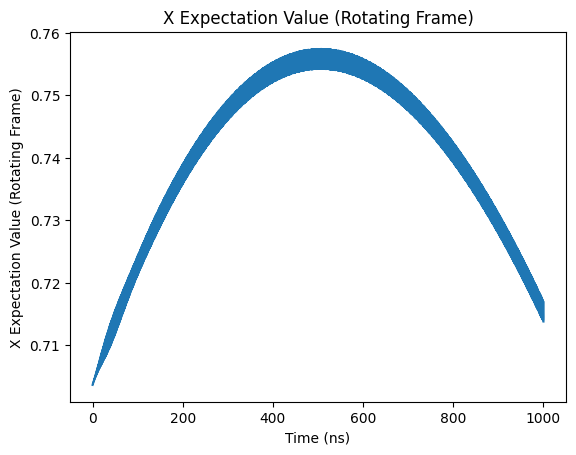

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

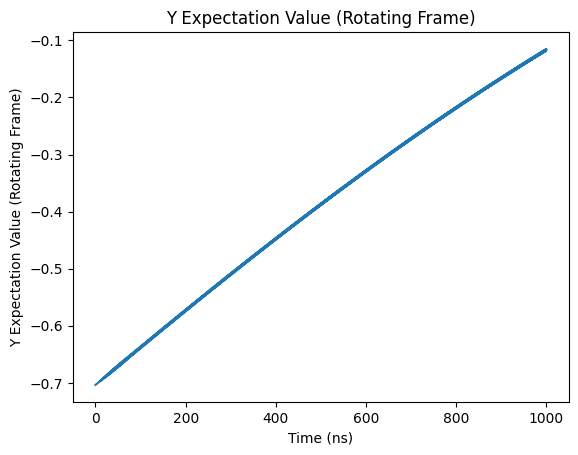

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

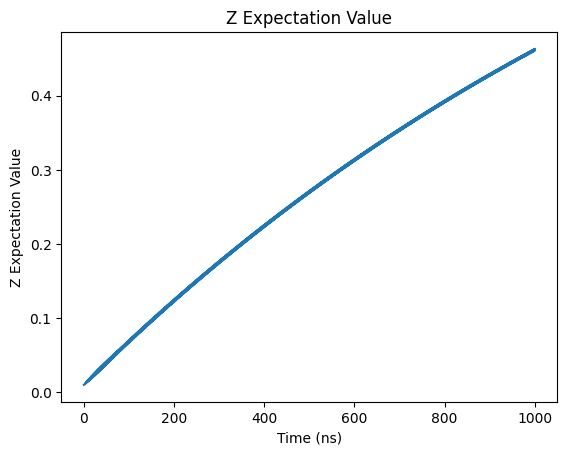

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

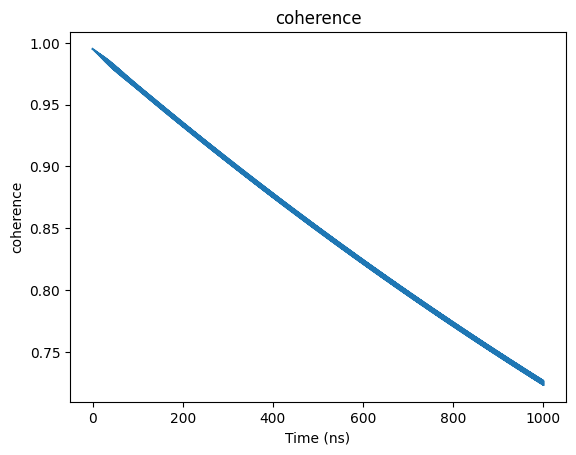

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

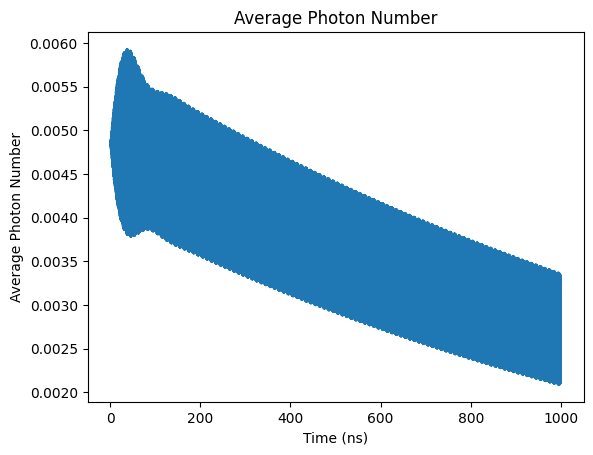

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

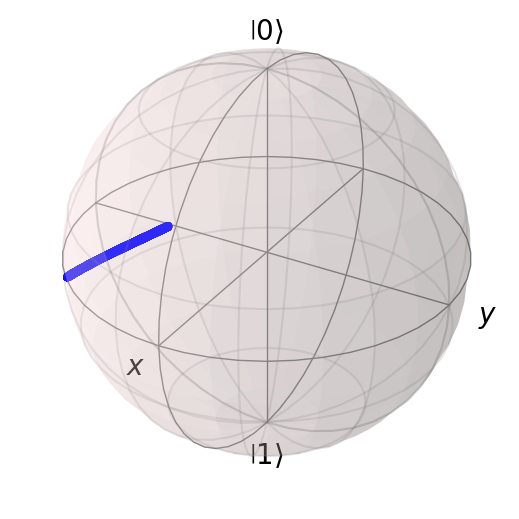

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=2)

In [ ]:
# Simulation

N_seq = 2

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004901348248049989


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

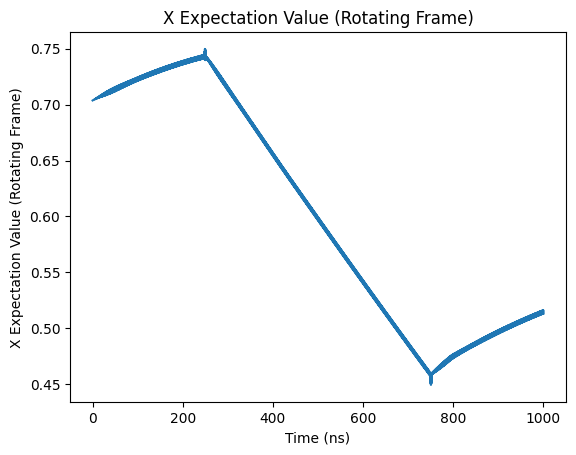

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

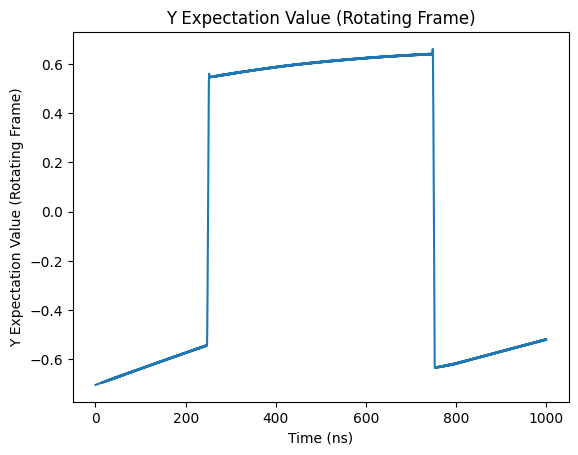

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

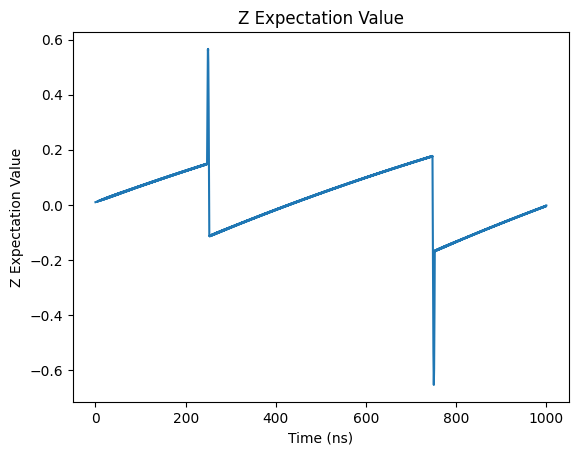

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

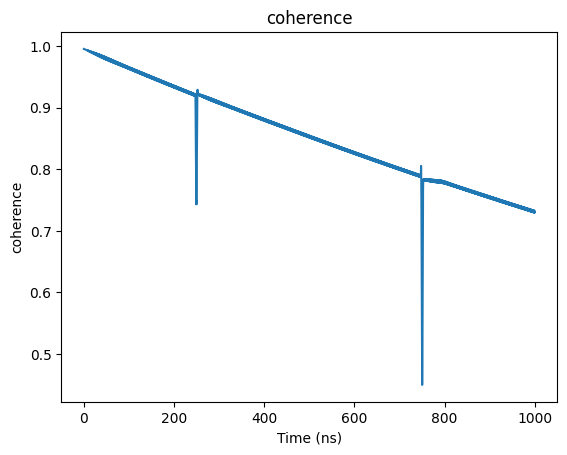

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

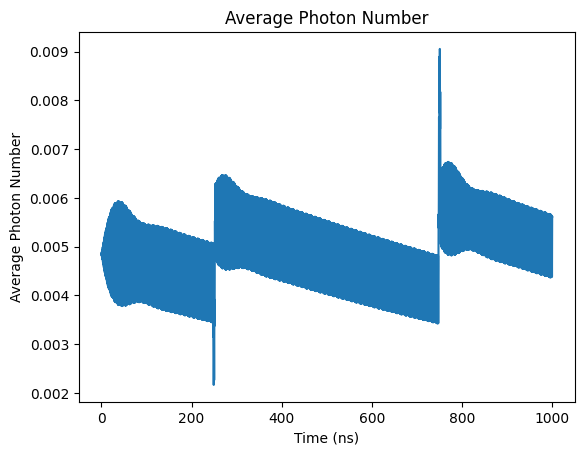

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

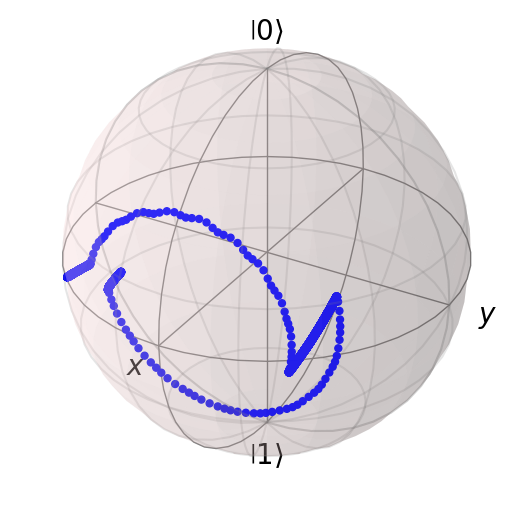

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=4)

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.0049977507870186365


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

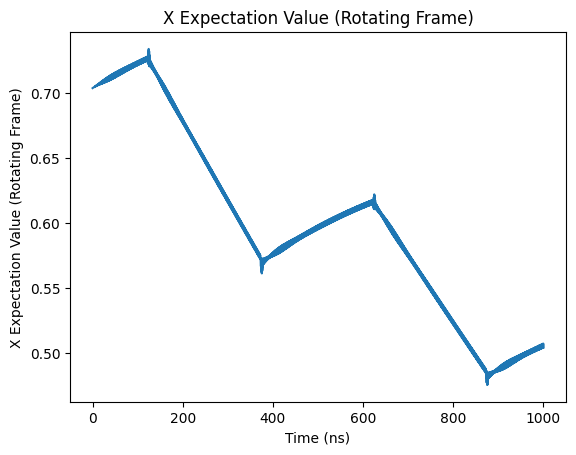

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

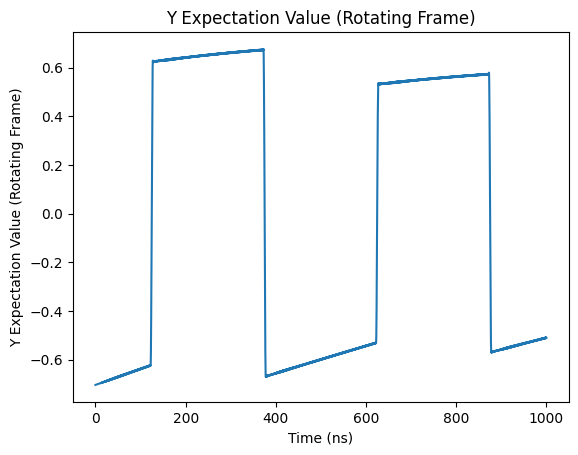

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

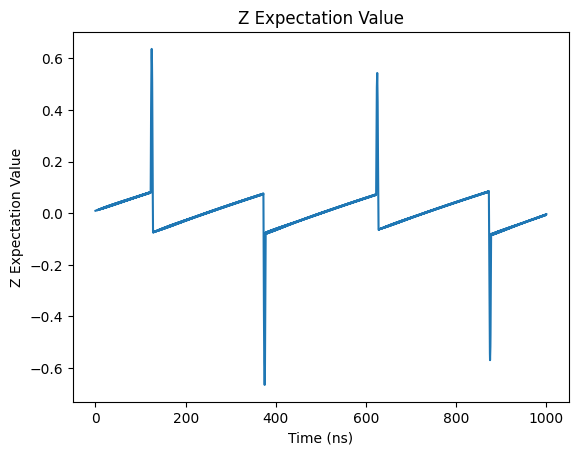

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

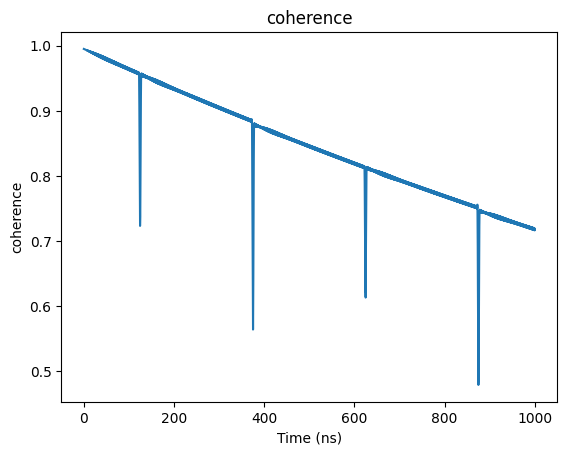

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

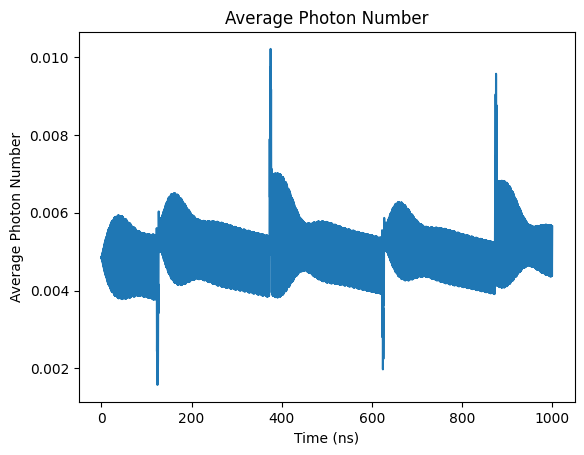

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

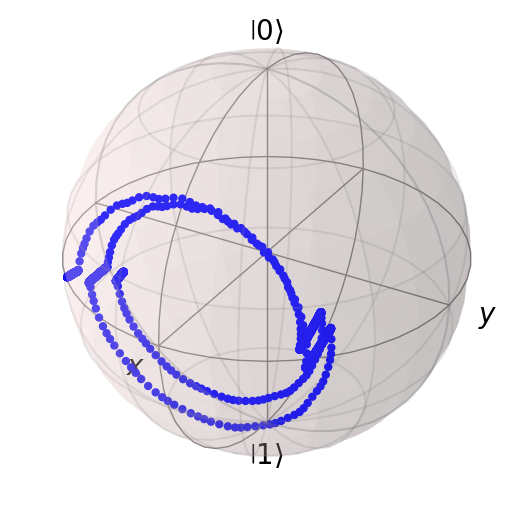

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY4

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY4_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004888346066705892


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

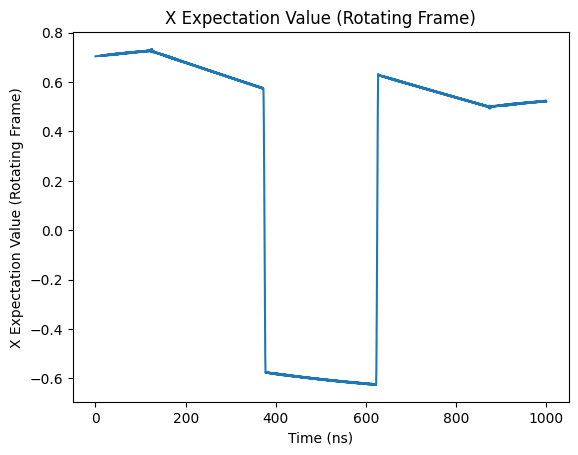

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

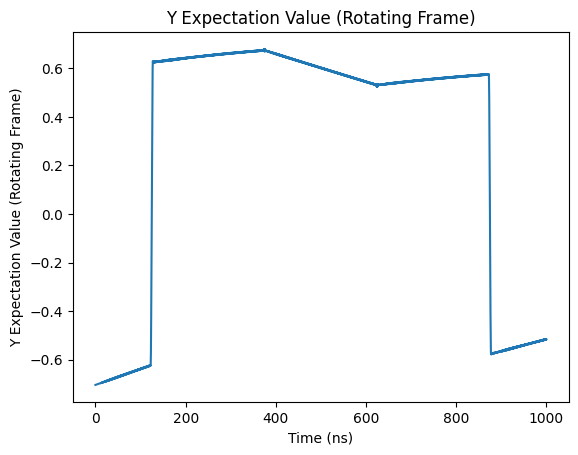

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

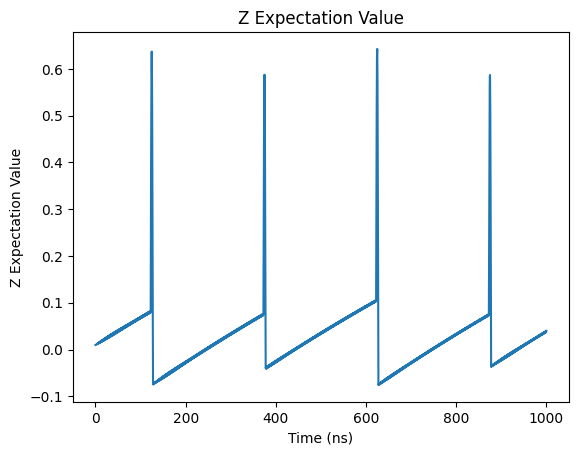

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

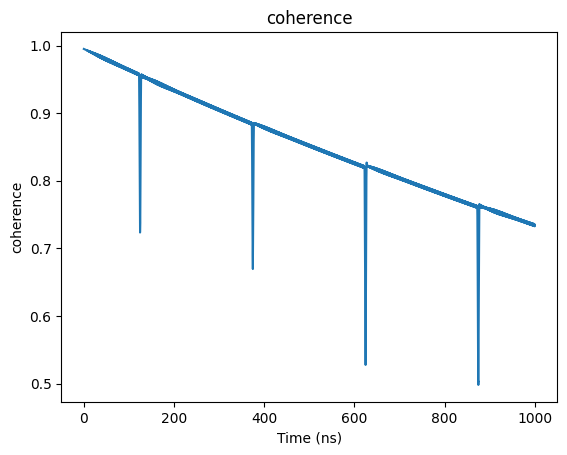

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

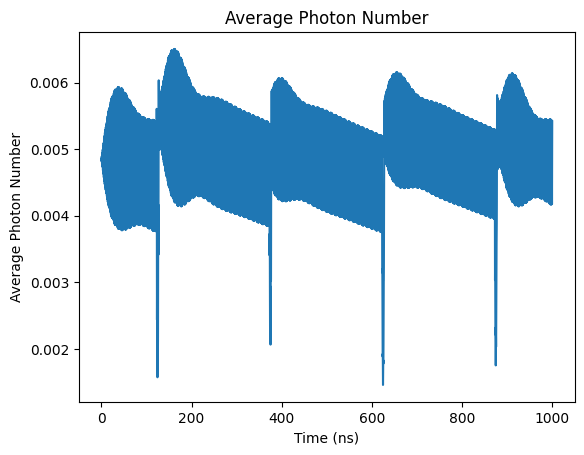

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

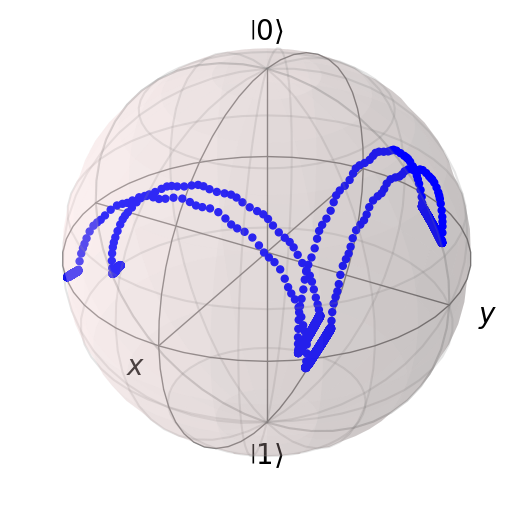

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=8)

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005014388519857962


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

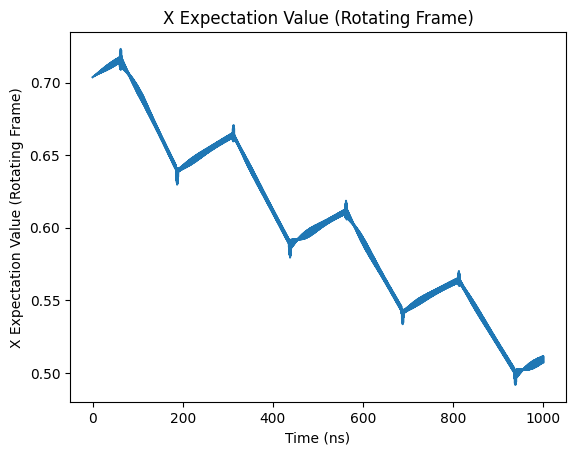

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

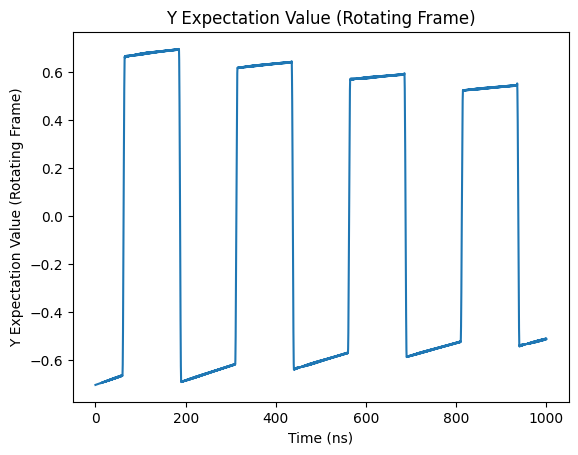

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

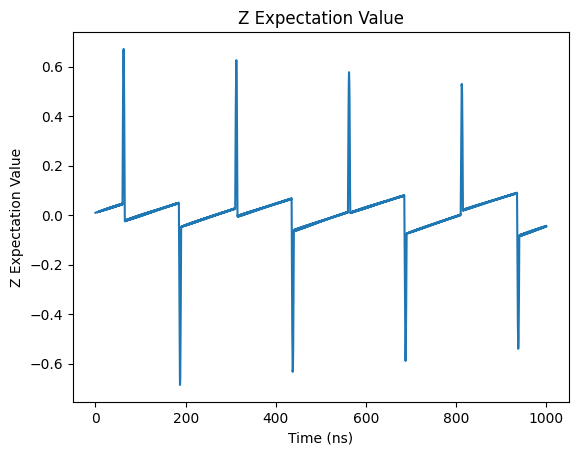

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

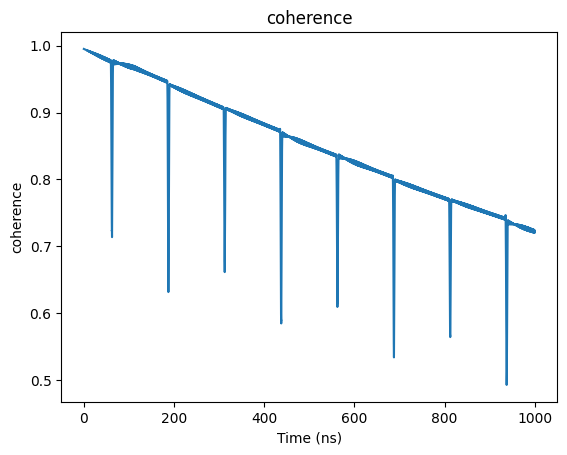

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

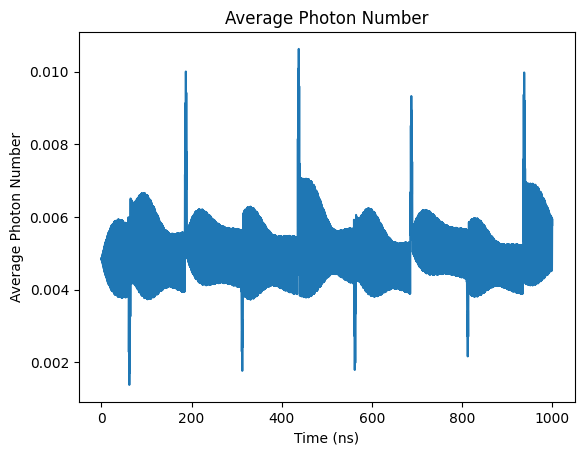

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

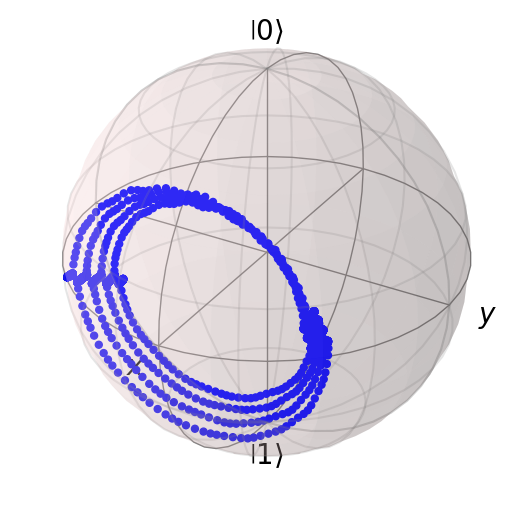

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY8

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY8_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.0049874173069571785


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

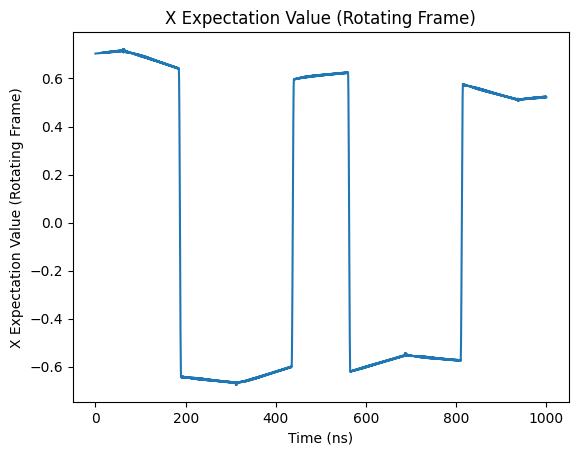

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

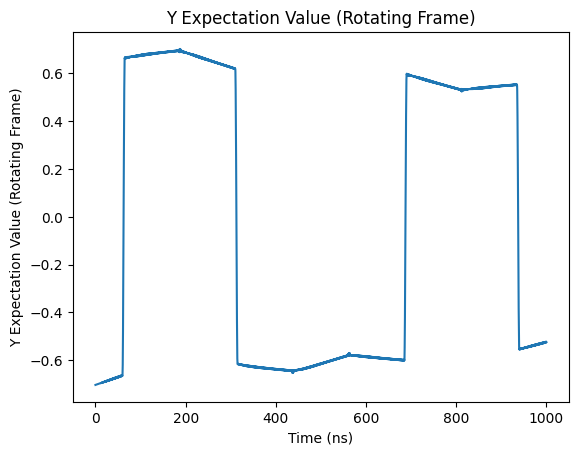

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

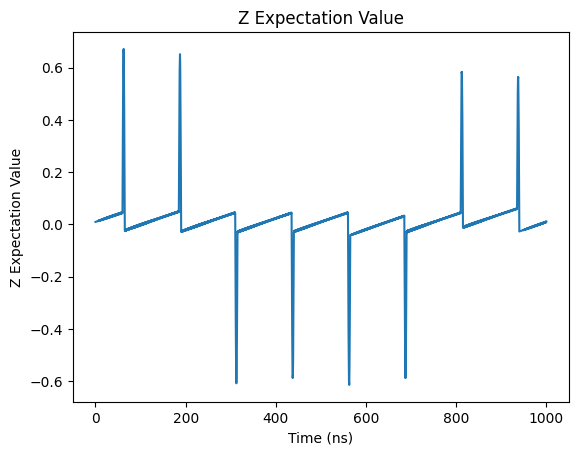

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

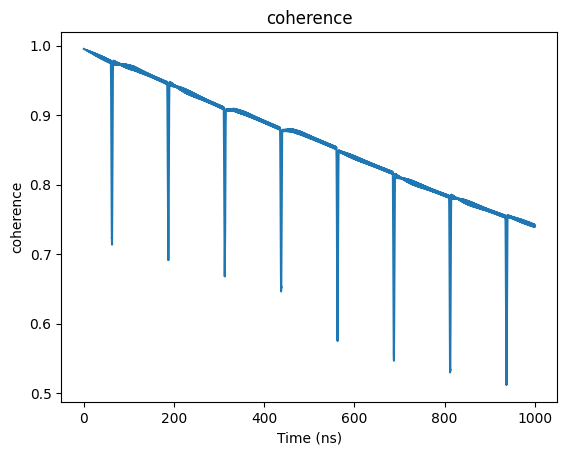

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

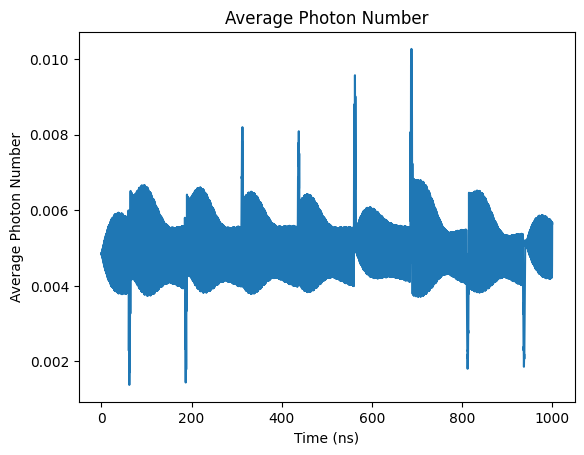

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

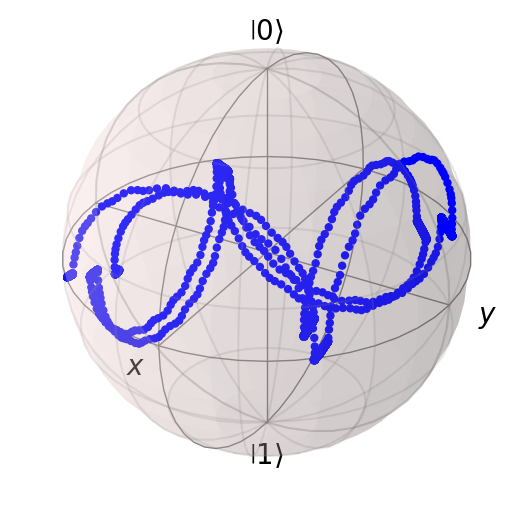

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=16)

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005095915429961026


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

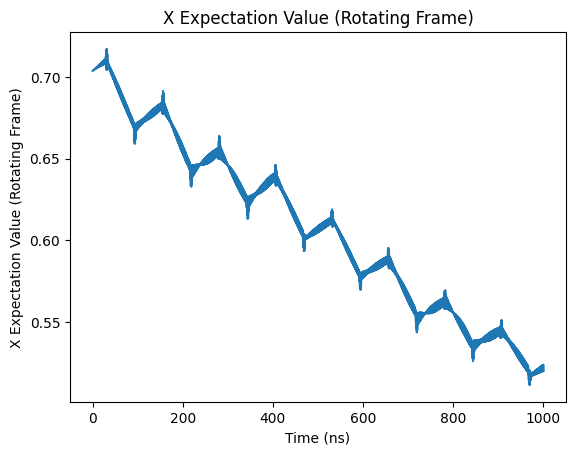

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

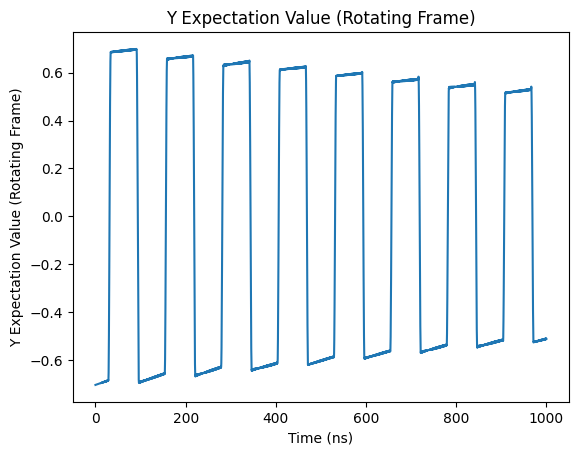

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

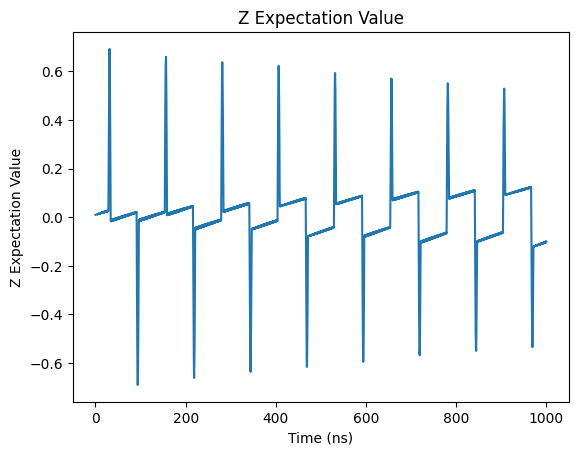

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

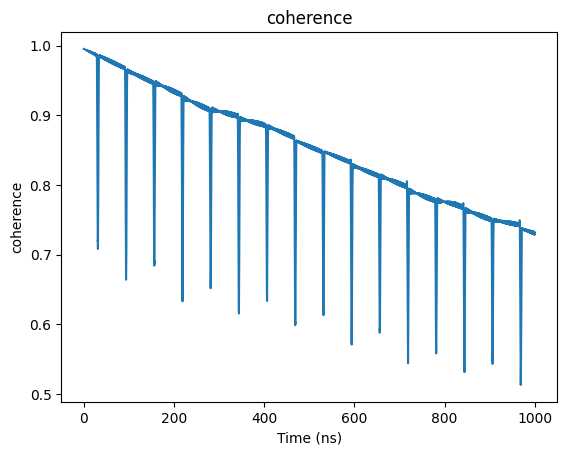

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

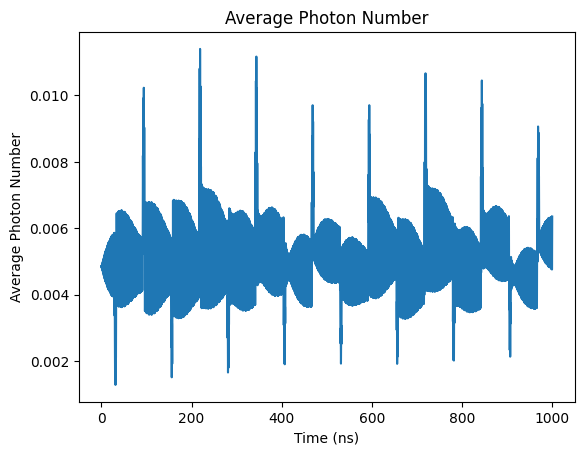

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

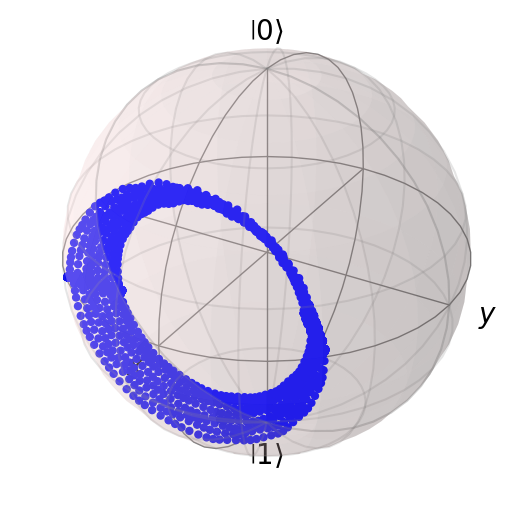

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY16

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY16_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005043462077576565


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

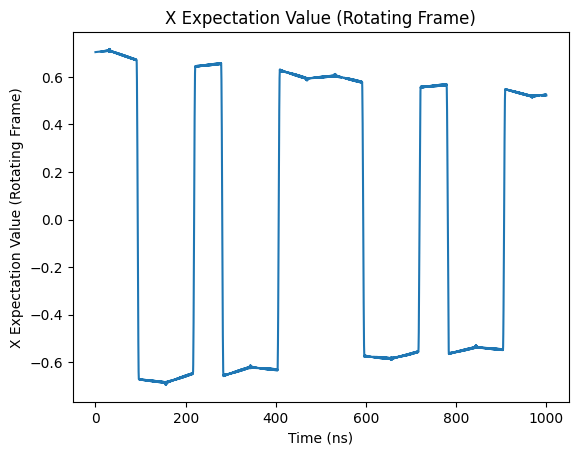

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

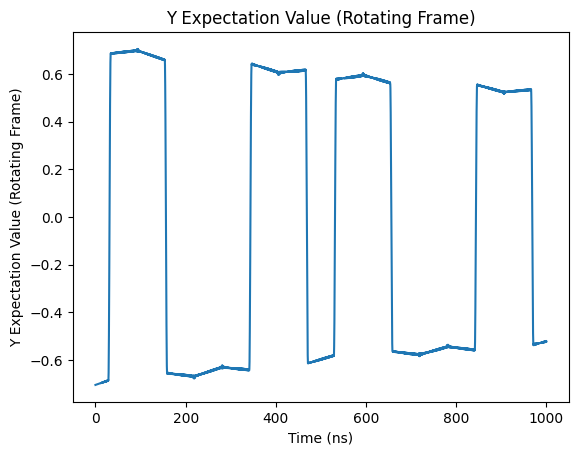

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

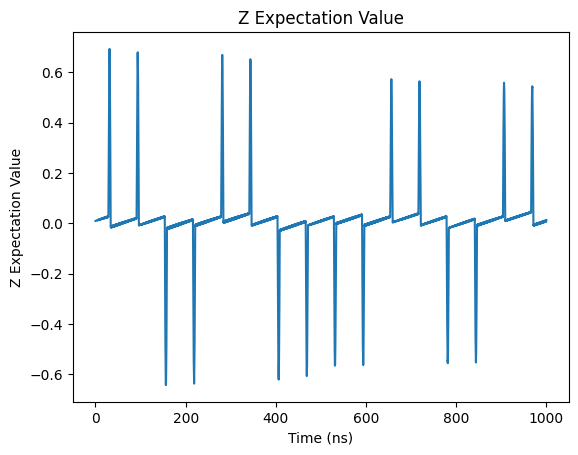

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

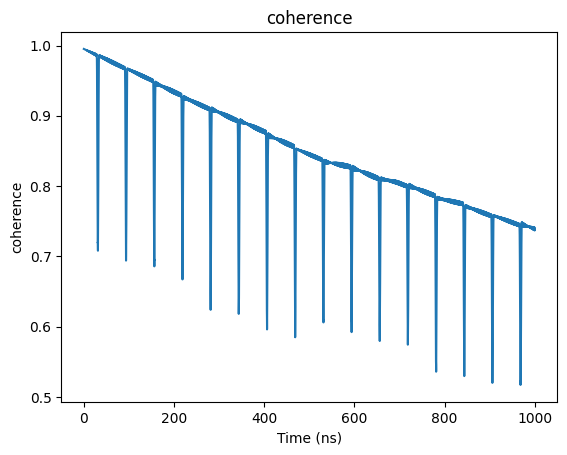

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

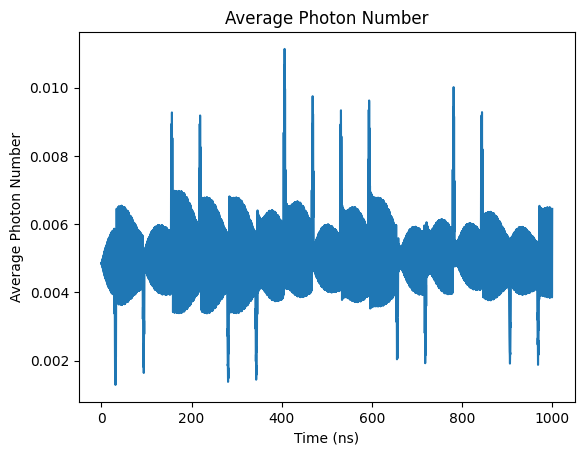

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

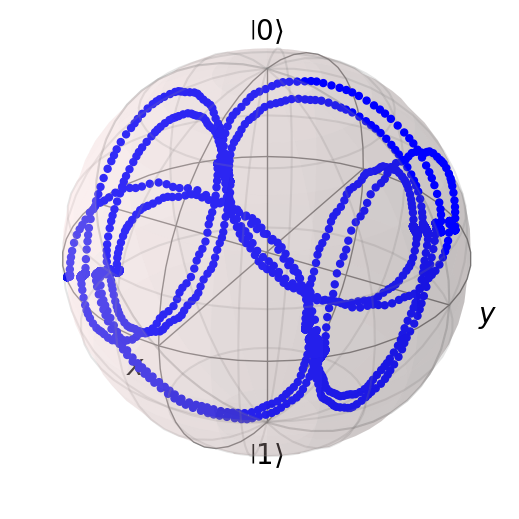

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## Print Coherence & Z

In [ ]:
x_list

[0.7154506302542908,
 0.5147298550794599,
 0.5059261694755997,
 0.5226684861823755,
 0.5094549933151135,
 0.5232160502633276,
 0.5218117568353267,
 0.5238293505887375]

In [ ]:
y_list

[-0.11678183947648564,
 -0.5190780586187611,
 -0.5098907981103397,
 -0.5158180170698008,
 -0.511981978554815,
 -0.5245076056982235,
 -0.5113059876918202,
 -0.5213745282072402]

In [ ]:
z_list

[0.46181378122678735,
 -0.003968027507974087,
 -0.005393126589680382,
 0.03850334099381814,
 -0.04468756464477326,
 0.009528176604887653,
 -0.10174726503953517,
 0.00979123680413025]

# Dynamical Decoupling Simulation

$ \omega_{qd} = \omega_q^b + \chi $

Evolution time 1000ns

Initial state $ \cos(\frac{1\pi}{4}) |0\rangle + e^{j\frac{2\pi}{4}} \sin(\frac{1\pi}{4}) |1\rangle $

In [ ]:
N = 5

omega_r = 2 * np.pi * 7.0     # resonator frequency in units of GHz
omega_q = 2 * np.pi * 6.0     # qubit frequency in units of GHz

g = 2 * np.pi * 0.1           # qubit-resonator coupling in units of GHz
kappa = 2 * np.pi * 0.01      # resonator linewidth in units of GHz

detune = omega_q-omega_r
chi = g*g/(detune)

omega_rd = omega_r            # qubit frequency in units of GHz
omega_qd = omega_q + chi      # qubit frequency in units of GHz

sx = sigmax()
sy = sigmay()
sz = sigmaz()
sp = basis(2,1)*basis(2,0).dag()
sm = basis(2,0)*basis(2,1).dag()
a = destroy(N)

sx_composite = tensor(sx, qeye(N))
sy_composite = tensor(sy, qeye(N))
sz_composite = tensor(sz, qeye(N))
sp_composite = tensor(sp, qeye(N))
number_composite = tensor(qeye(2), a.dag()*a)

op_list = [sx_composite, sy_composite, sz_composite, sp_composite, number_composite]

tlist = np.linspace(0, 1000, 10000)
T_end_q = 1000

cos = np.sqrt(0.5 + 0.5*5/np.sqrt(26))
sin = np.sqrt(0.5 - 0.5*5/np.sqrt(26))


psi_20 = tensor(basis(2,0), basis(N,0))
psi_21 = cos*tensor(basis(2,1), basis(N,0)) - sin*tensor(basis(2,0), basis(N,1))
psi_2s = np.cos(1*np.pi/4) * psi_20 + np.exp(1j*np.pi*2/4) * np.sin(1*np.pi/4) * psi_21


H0 = -0.5*omega_q*sz_composite + omega_r*number_composite + g*(tensor(sm, a.dag()) + tensor(sp, a))
H1 = tensor(qeye(2), a + a.dag())
H2 = sx_composite

A = 0.0002 * 2 * np.pi
B = 0.1 * 2 * np.pi

x_list = []
y_list = []
z_list = []

## Ramsey

In [ ]:
# Simulation

N_seq = 0

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))
print([x_rot[0], y_rot[0], result.expect[2][0]])

0.0037172070555832036
[6.093434216144547e-17, -0.9951333266680702, 0.009709662154540055]


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

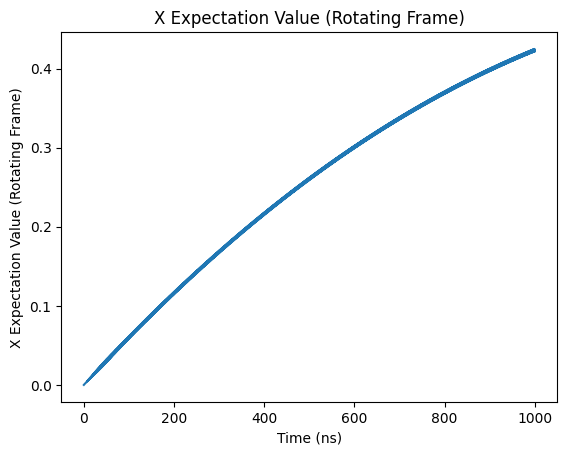

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

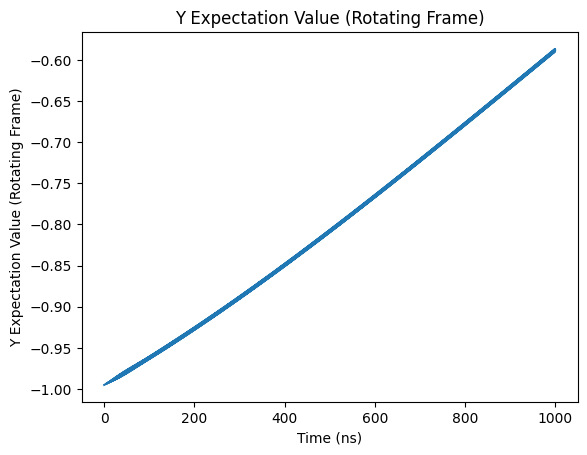

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

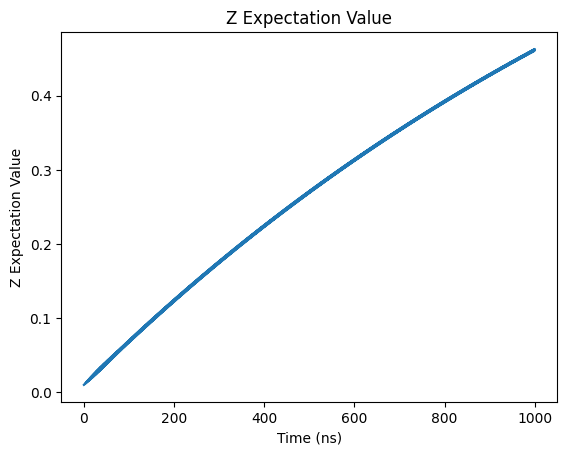

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

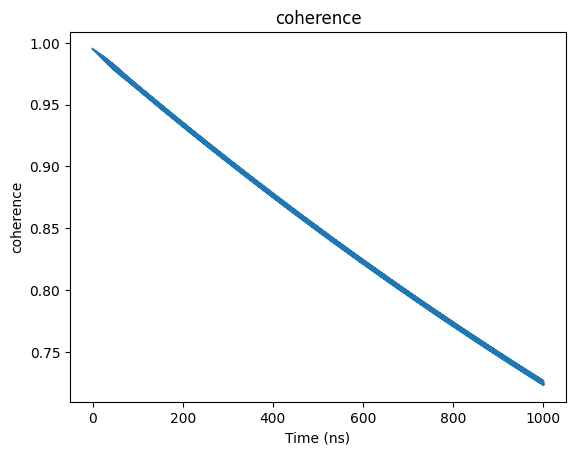

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

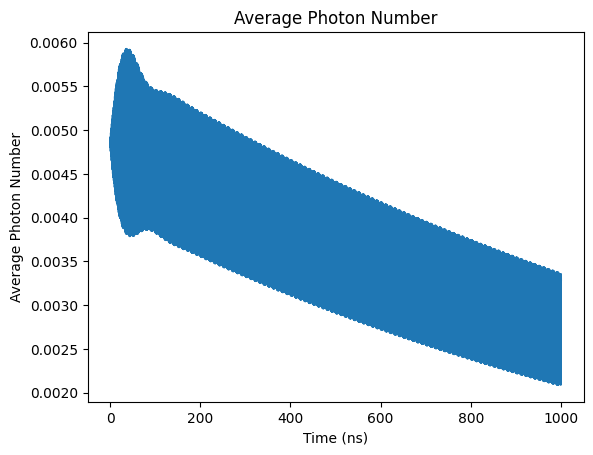

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

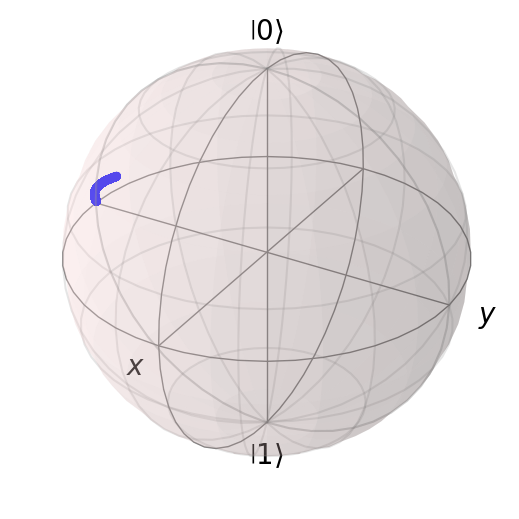

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=2)

In [ ]:
# Simulation

N_seq = 2

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004896548749772568


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

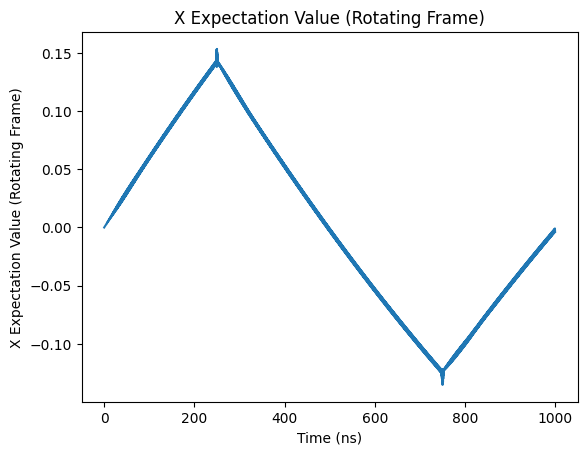

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

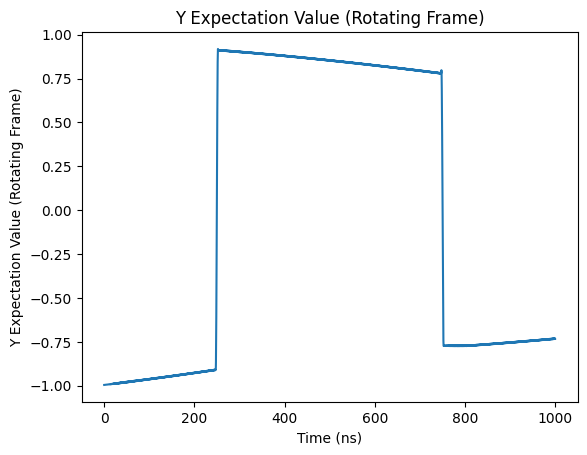

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

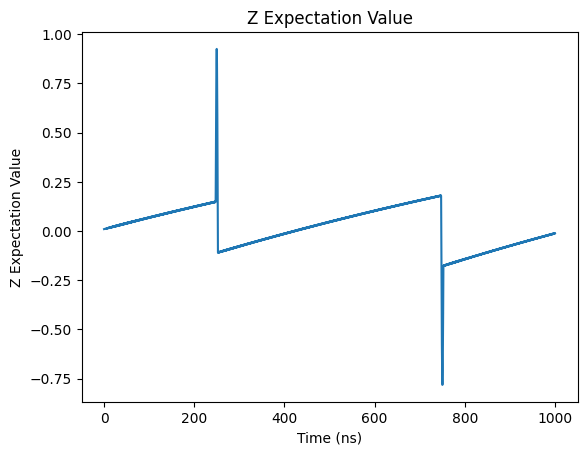

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

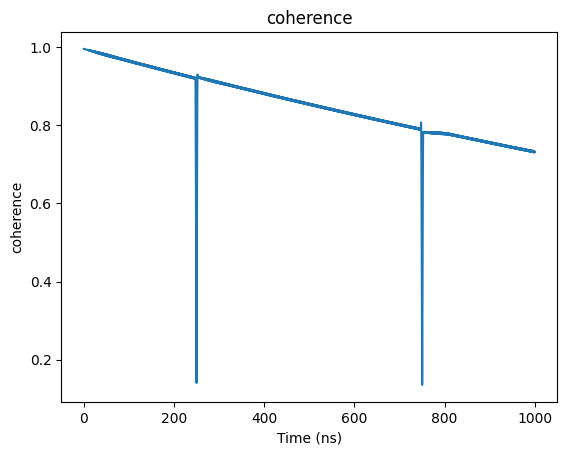

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

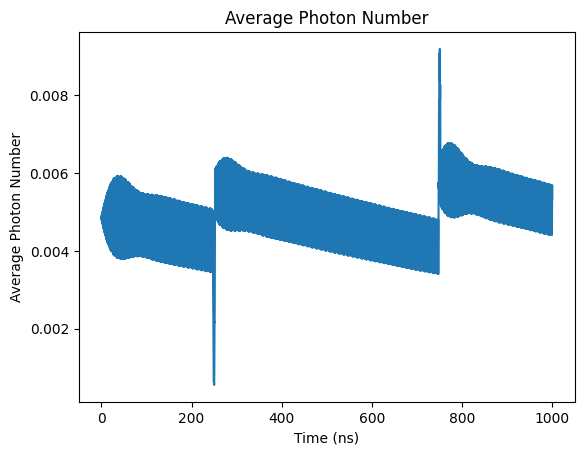

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

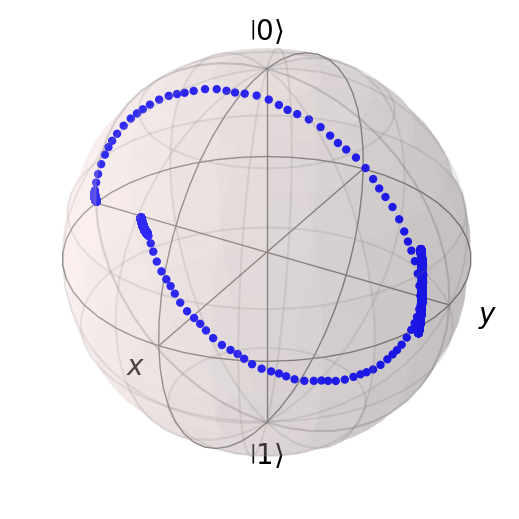

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=4)

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004948393154300467


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

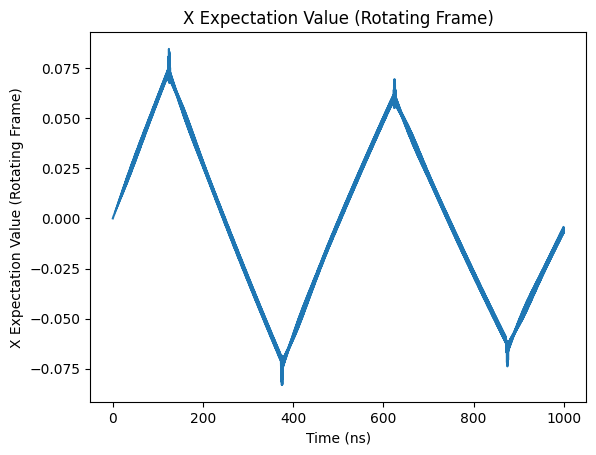

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

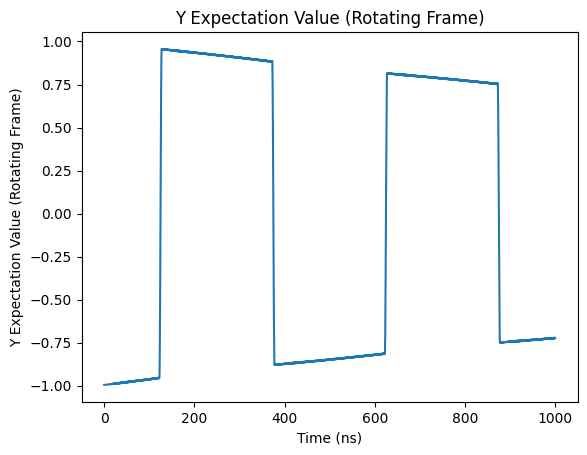

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

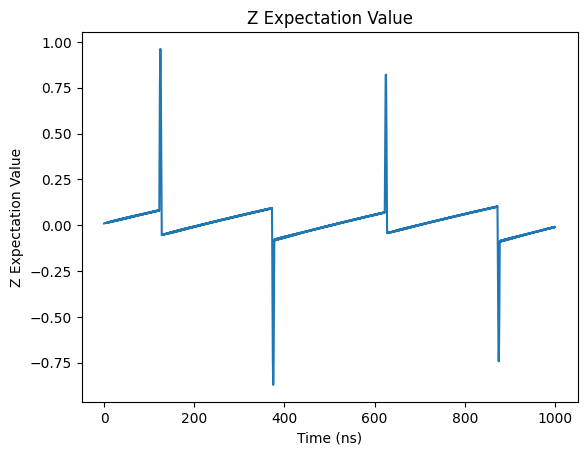

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

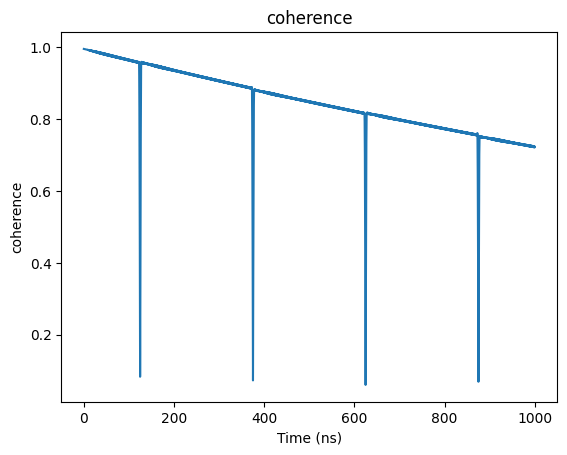

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

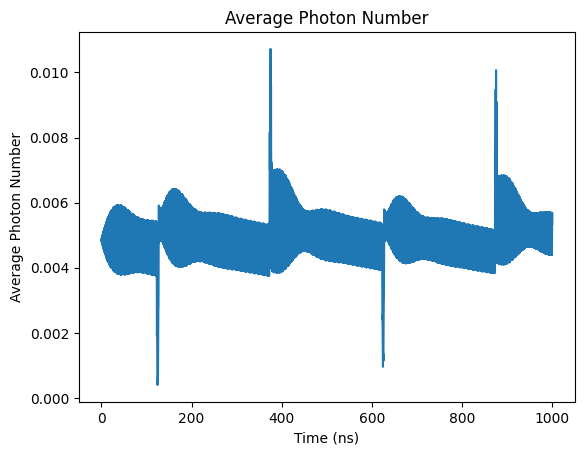

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

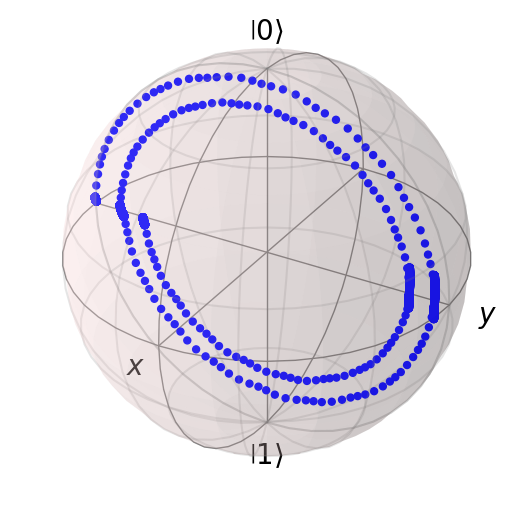

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY4

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY4_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004908637436593761


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

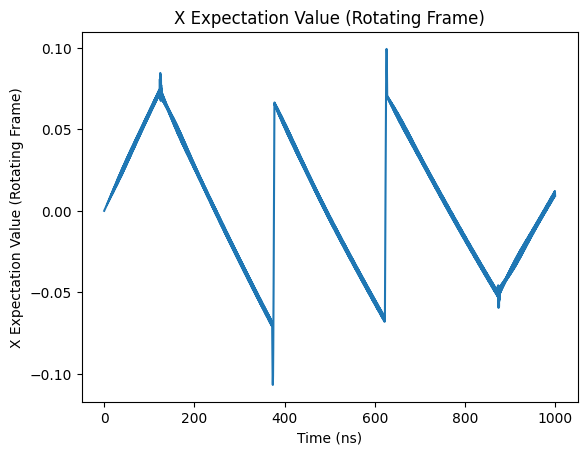

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

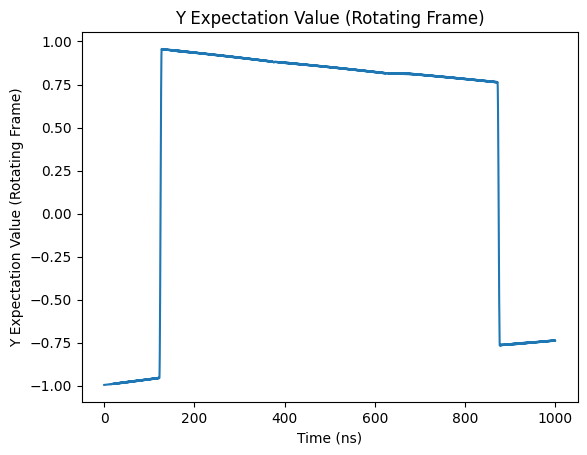

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

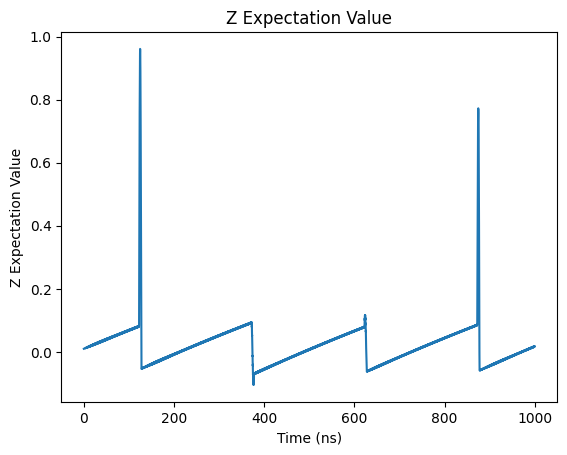

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

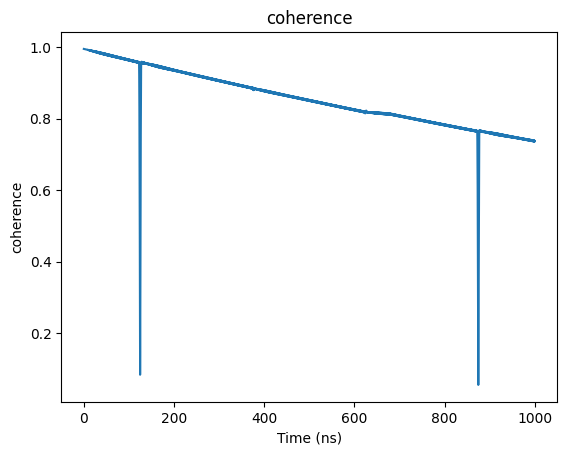

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

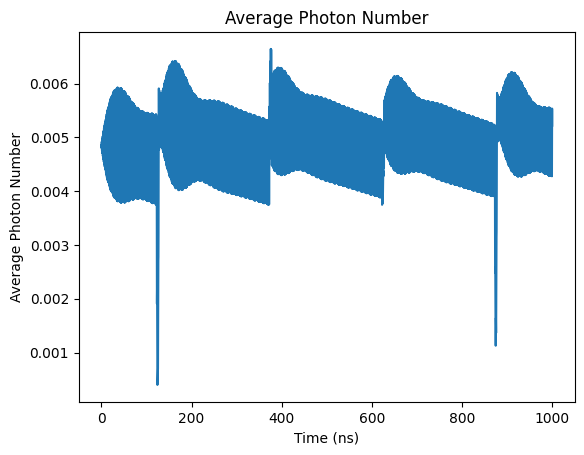

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

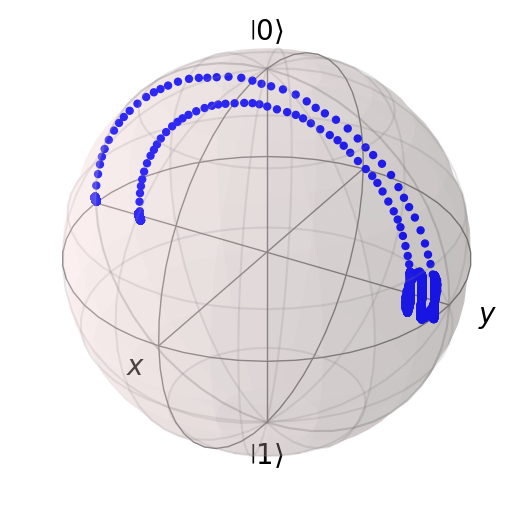

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=8)

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004981778804516715


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

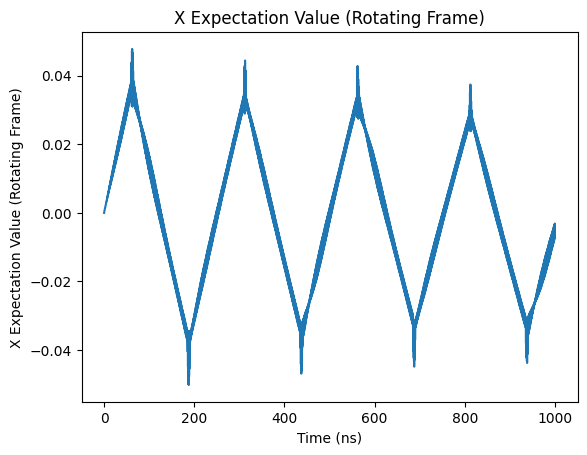

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

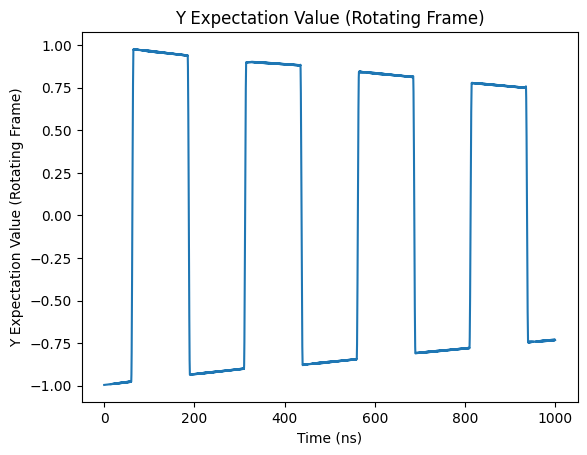

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

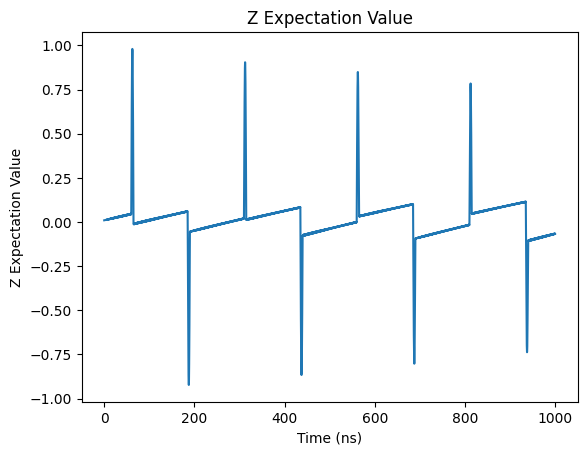

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

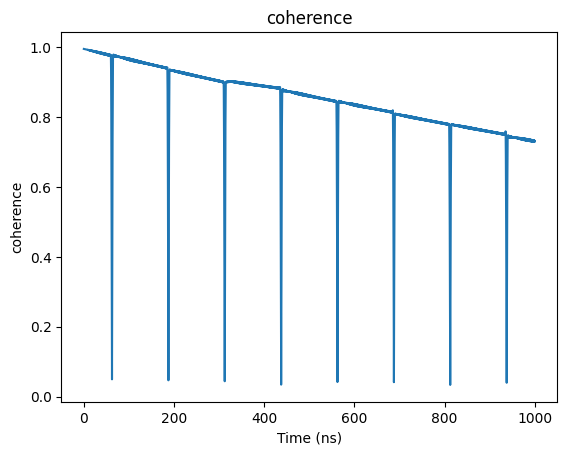

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

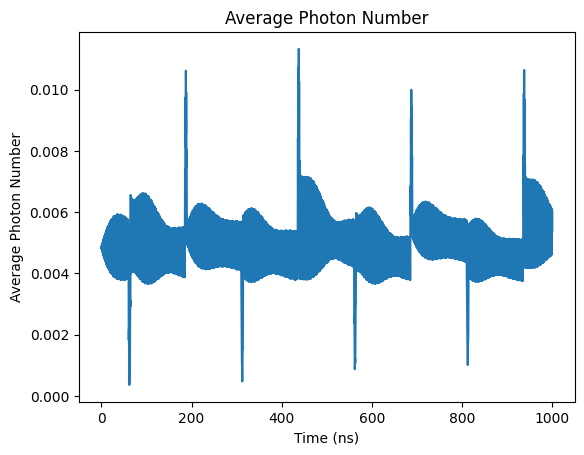

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

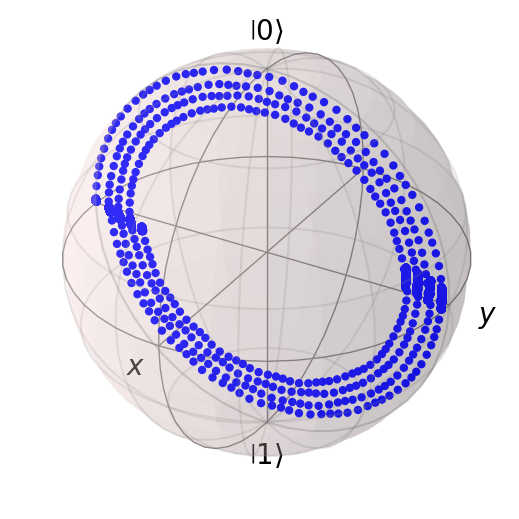

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY8

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY8_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004985305347923199


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

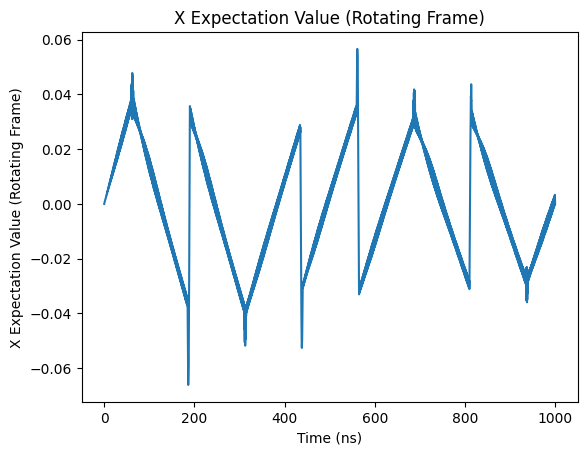

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

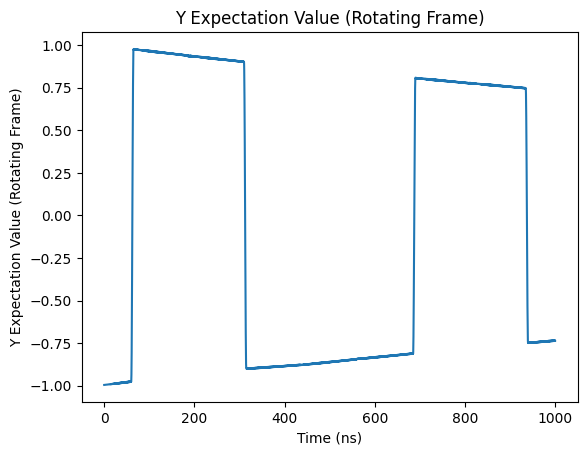

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

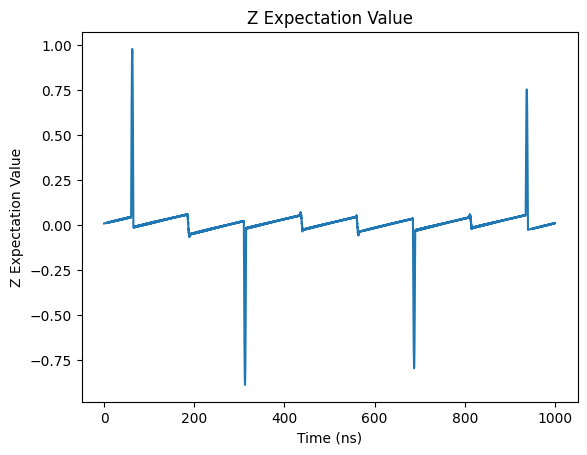

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

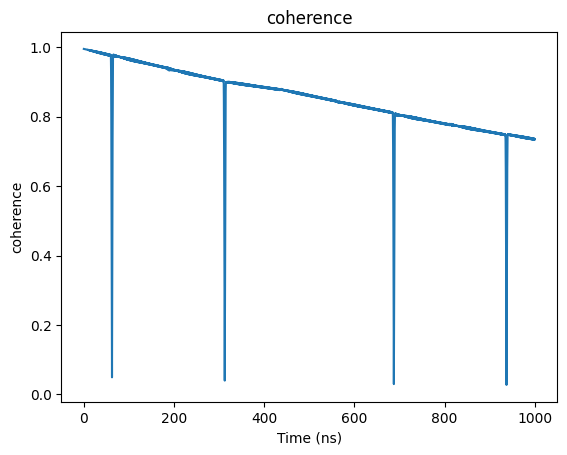

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

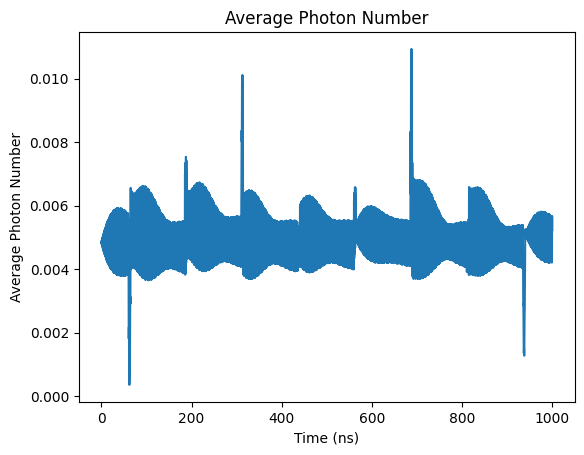

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

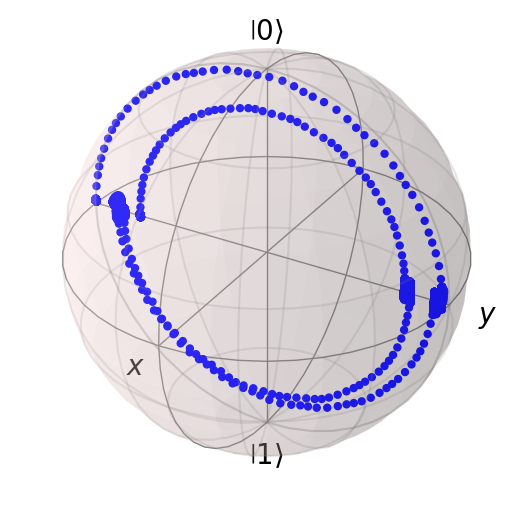

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=16)

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005049147500131477


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

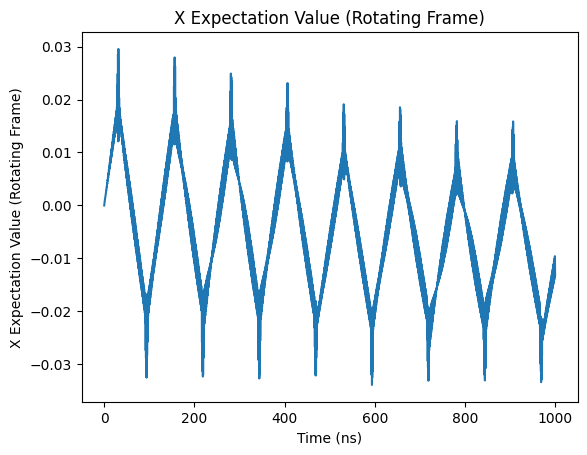

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

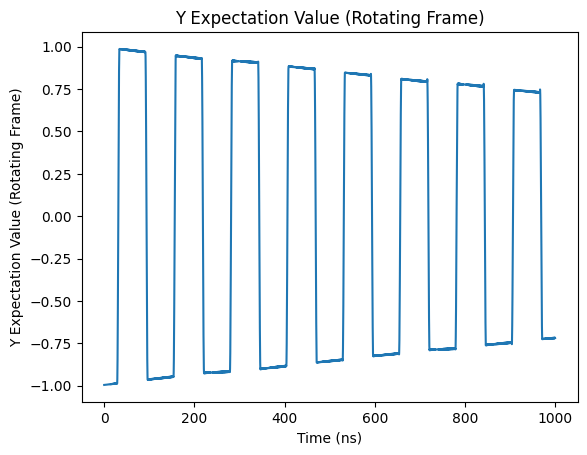

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

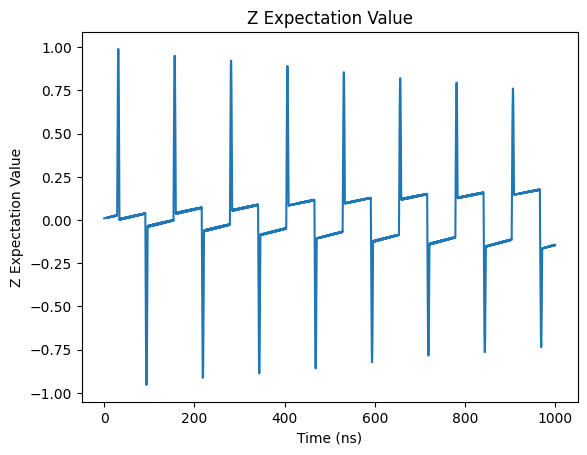

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

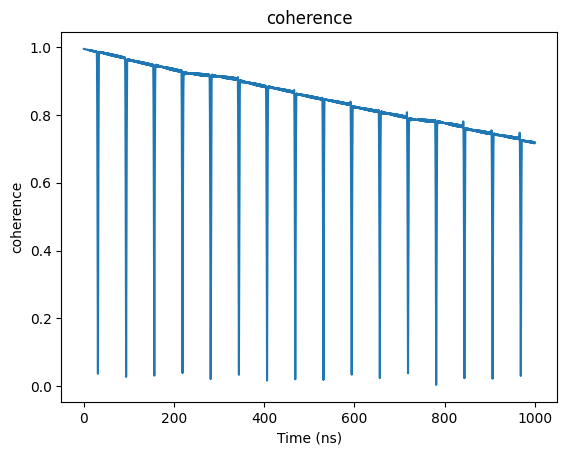

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

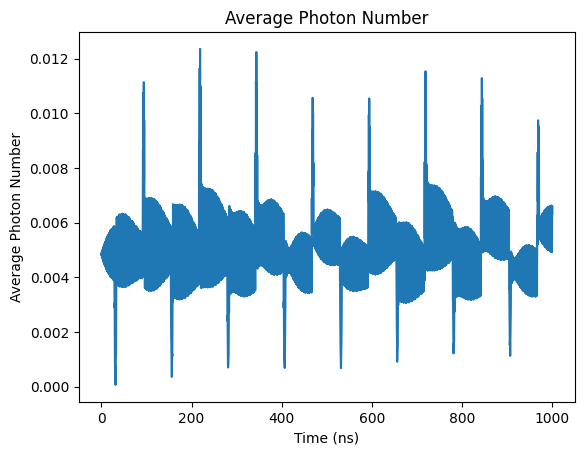

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

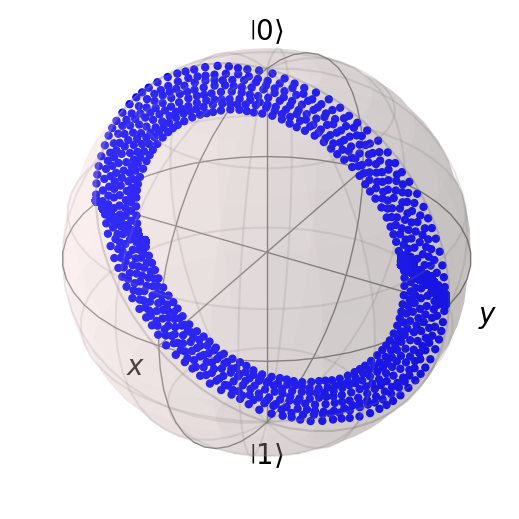

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY16

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY16_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005045385384022502


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

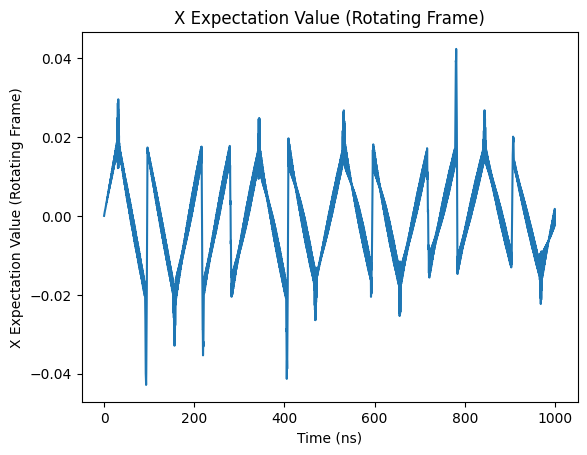

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

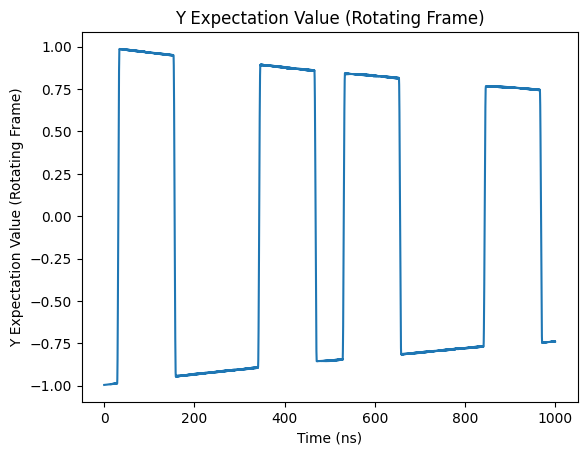

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

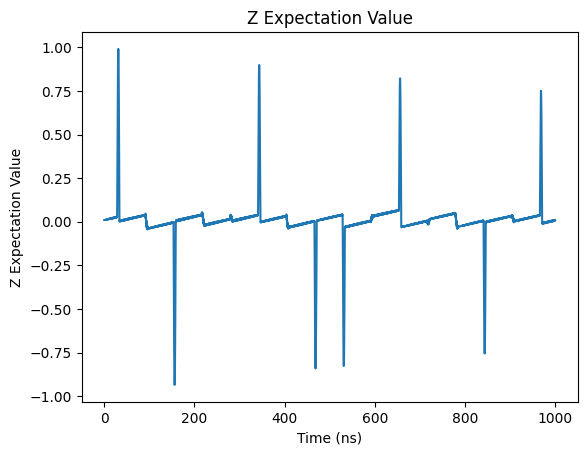

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

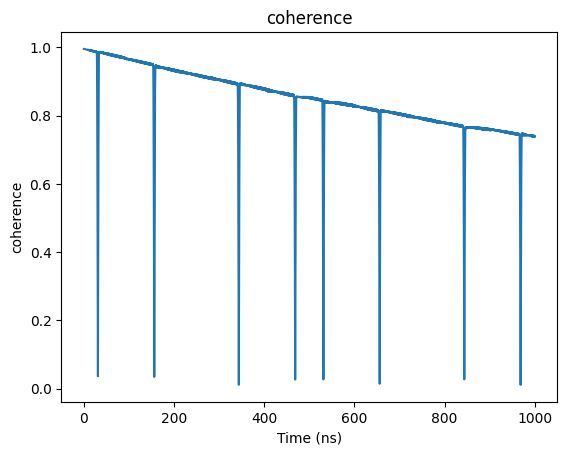

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

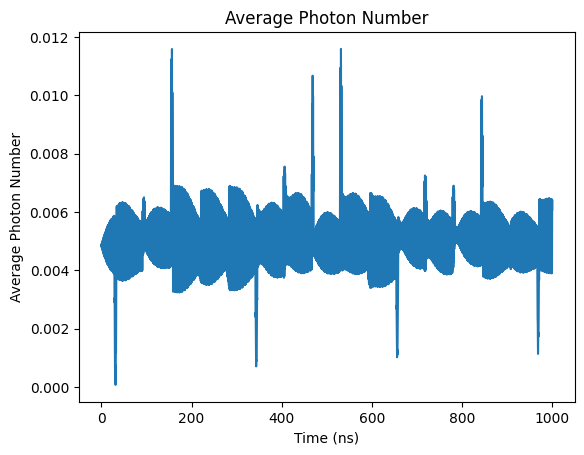

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

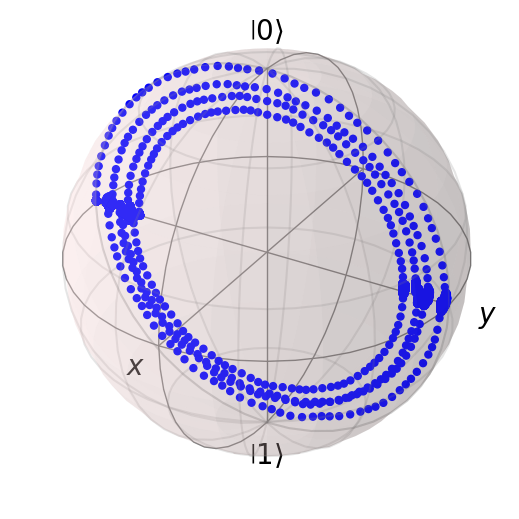

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## Print Coherence & Z

In [ ]:
x_list

[0.423312943419656,
 -0.0023884211186266124,
 -0.005806000549240397,
 0.010610407446271918,
 -0.0052222807063316695,
 0.0015932068728931371,
 -0.011494229960755085,
 -0.00030626412975286394]

In [ ]:
y_list

[-0.5884804098356632,
 -0.7318273153549444,
 -0.7227126402991348,
 -0.7371551271434352,
 -0.7310731830317031,
 -0.735022065270816,
 -0.7182783937938038,
 -0.7387472664527064]

In [ ]:
z_list

[0.4618168955684733,
 -0.012008766279929898,
 -0.009865114006988819,
 0.01695853167058682,
 -0.06660827170592046,
 0.011081215138507393,
 -0.14439628712771135,
 0.008184928130579285]

# Dynamical Decoupling Simulation

$ \omega_{qd} = \omega_q^b + \chi $

Evolution time 1000ns

Initial state $ \cos(\frac{1\pi}{4}) |0\rangle + e^{j\frac{3\pi}{4}} \sin(\frac{1\pi}{4}) |1\rangle $

In [ ]:
N = 5

omega_r = 2 * np.pi * 7.0     # resonator frequency in units of GHz
omega_q = 2 * np.pi * 6.0     # qubit frequency in units of GHz

g = 2 * np.pi * 0.1           # qubit-resonator coupling in units of GHz
kappa = 2 * np.pi * 0.01      # resonator linewidth in units of GHz

detune = omega_q-omega_r
chi = g*g/(detune)

omega_rd = omega_r            # qubit frequency in units of GHz
omega_qd = omega_q + chi      # qubit frequency in units of GHz

sx = sigmax()
sy = sigmay()
sz = sigmaz()
sp = basis(2,1)*basis(2,0).dag()
sm = basis(2,0)*basis(2,1).dag()
a = destroy(N)

sx_composite = tensor(sx, qeye(N))
sy_composite = tensor(sy, qeye(N))
sz_composite = tensor(sz, qeye(N))
sp_composite = tensor(sp, qeye(N))
number_composite = tensor(qeye(2), a.dag()*a)

op_list = [sx_composite, sy_composite, sz_composite, sp_composite, number_composite]

tlist = np.linspace(0, 1000, 10000)
T_end_q = 1000

cos = np.sqrt(0.5 + 0.5*5/np.sqrt(26))
sin = np.sqrt(0.5 - 0.5*5/np.sqrt(26))


psi_20 = tensor(basis(2,0), basis(N,0))
psi_21 = cos*tensor(basis(2,1), basis(N,0)) - sin*tensor(basis(2,0), basis(N,1))
psi_2s = np.cos(1*np.pi/4) * psi_20 + np.exp(1j*np.pi*3/4) * np.sin(1*np.pi/4) * psi_21


H0 = -0.5*omega_q*sz_composite + omega_r*number_composite + g*(tensor(sm, a.dag()) + tensor(sp, a))
H1 = tensor(qeye(2), a + a.dag())
H2 = sx_composite

A = 0.0002 * 2 * np.pi
B = 0.1 * 2 * np.pi

x_list = []
y_list = []
z_list = []

## Ramsey

In [ ]:
# Simulation

N_seq = 0

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))
print([x_rot[0], y_rot[0], result.expect[2][0]])

0.0037172297306602643
[-0.7036655234717201, -0.7036655234717203, 0.00970966215454011]


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

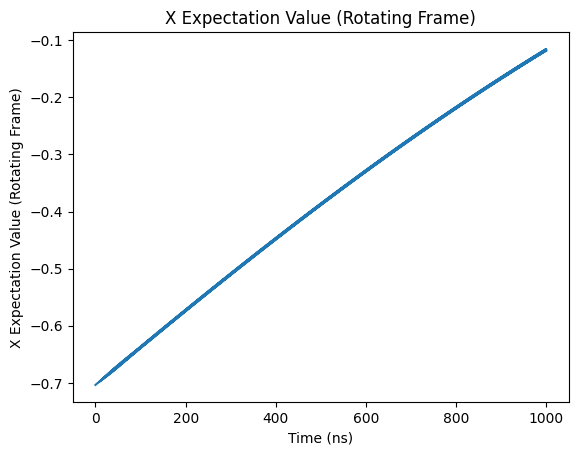

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

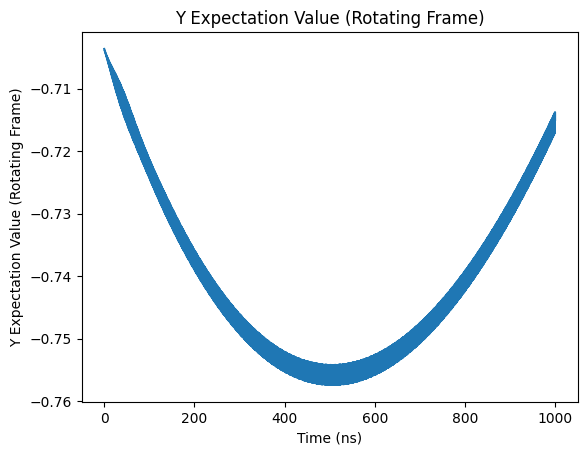

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

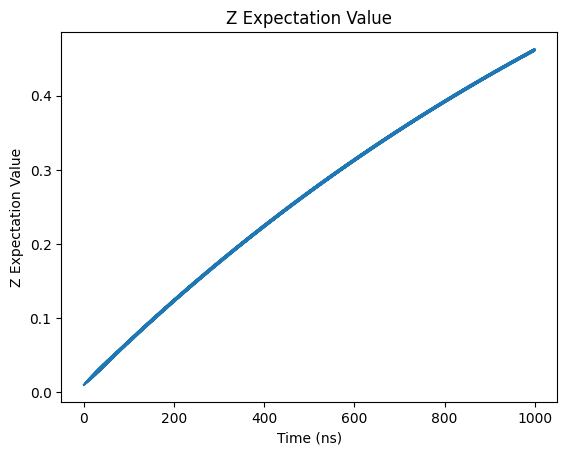

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

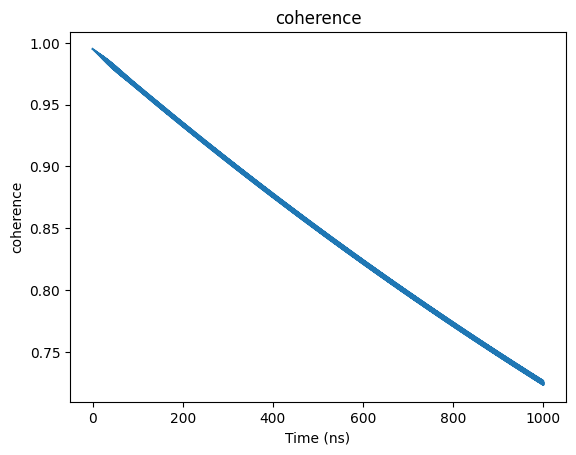

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

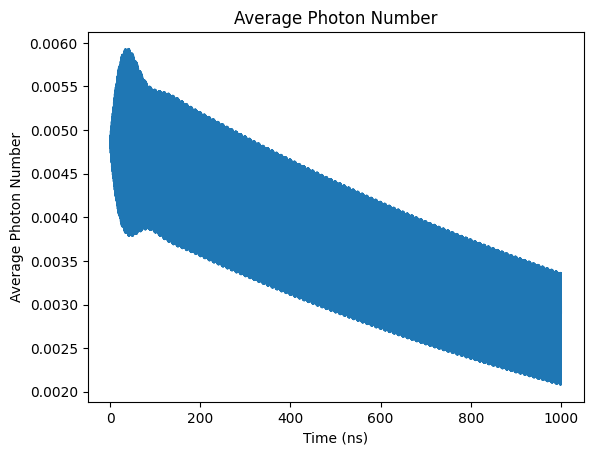

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

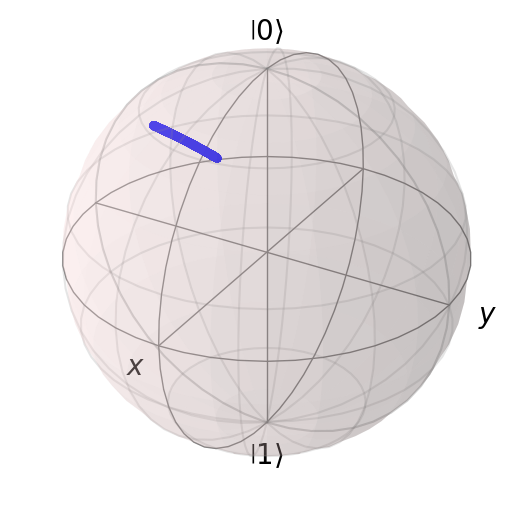

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=2)

In [ ]:
# Simulation

N_seq = 2

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004897251895771991


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

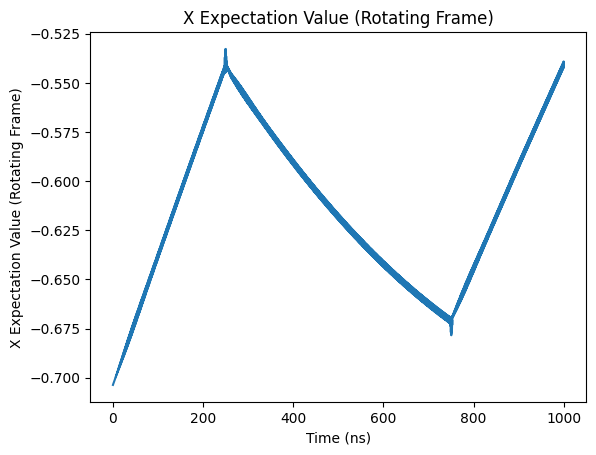

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

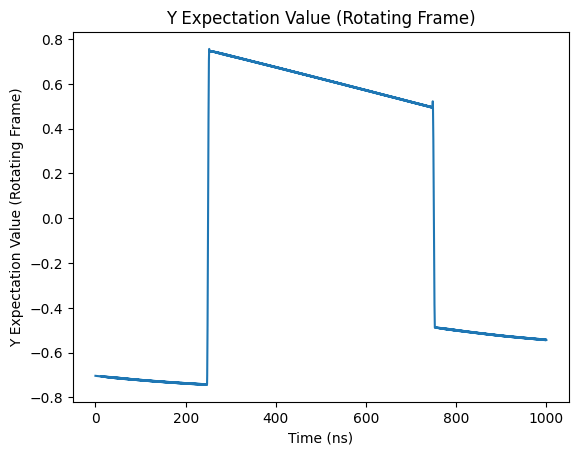

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

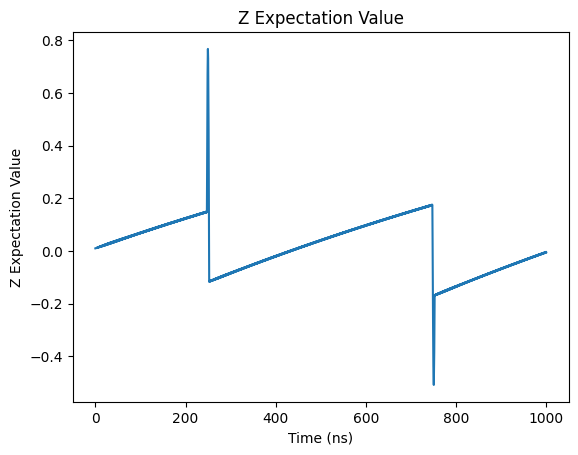

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

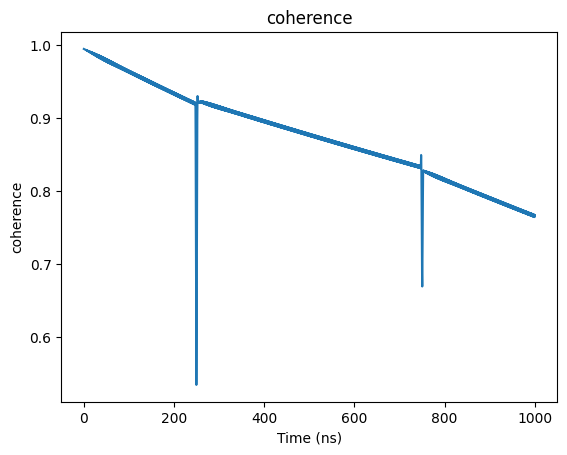

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

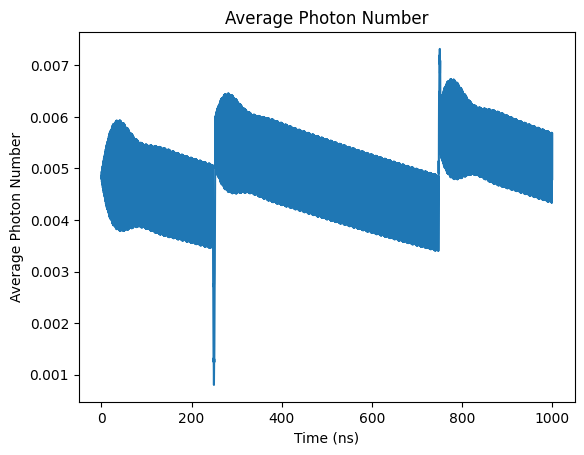

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

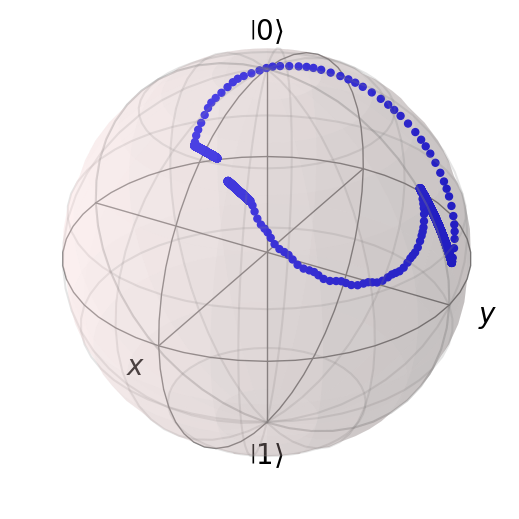

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=4)

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.0049005104323648465


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

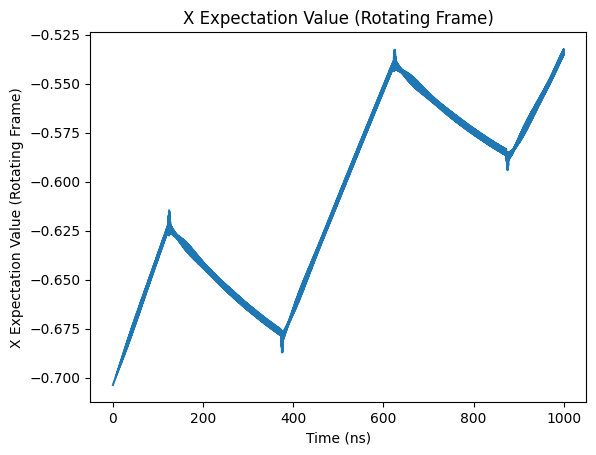

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

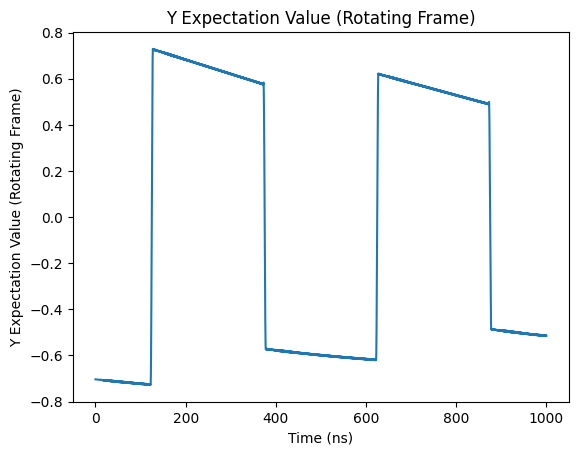

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

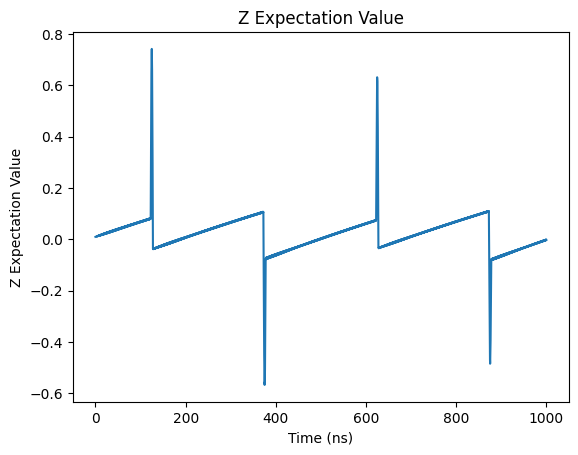

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

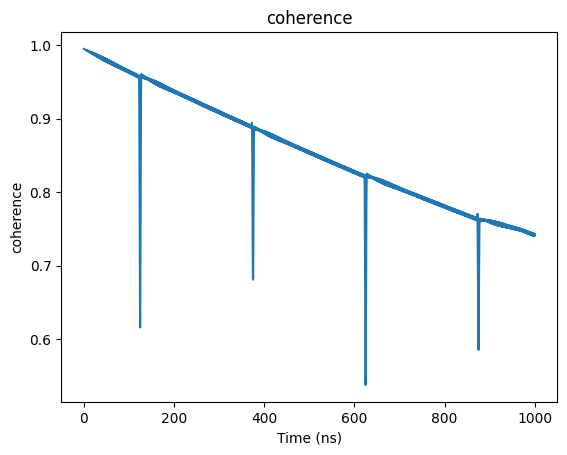

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

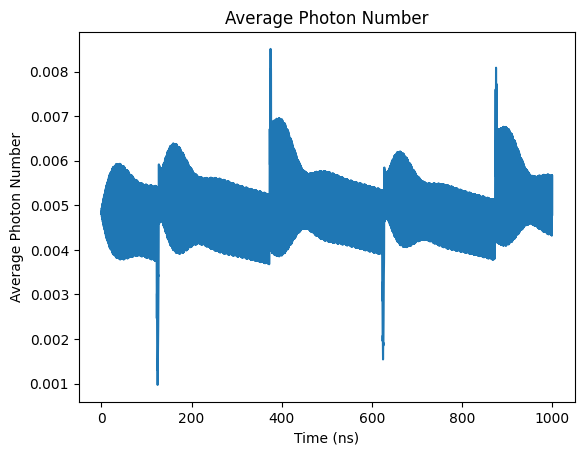

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

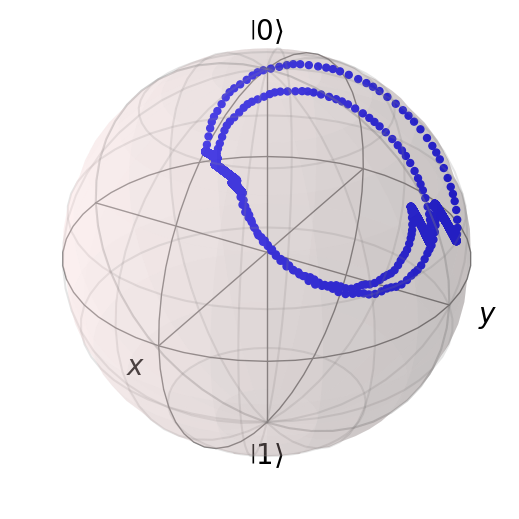

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY4

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY4_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004949976020289732


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

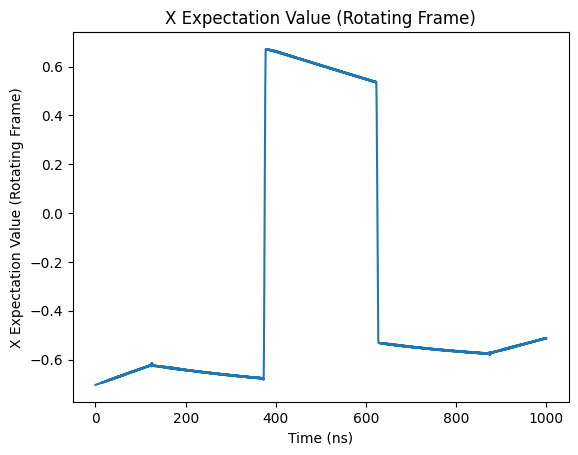

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

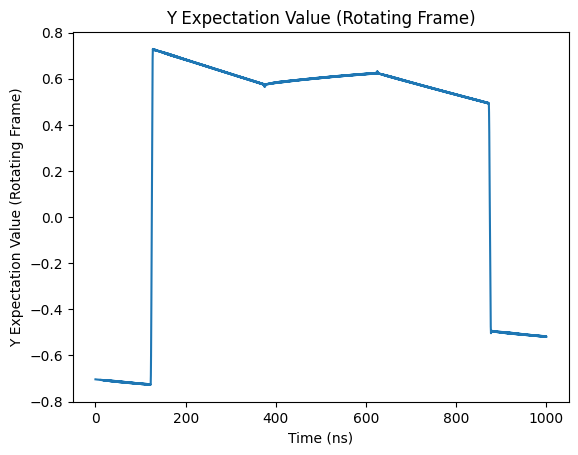

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

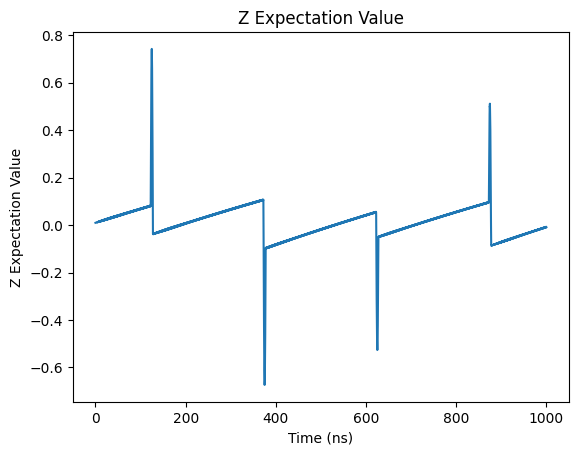

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

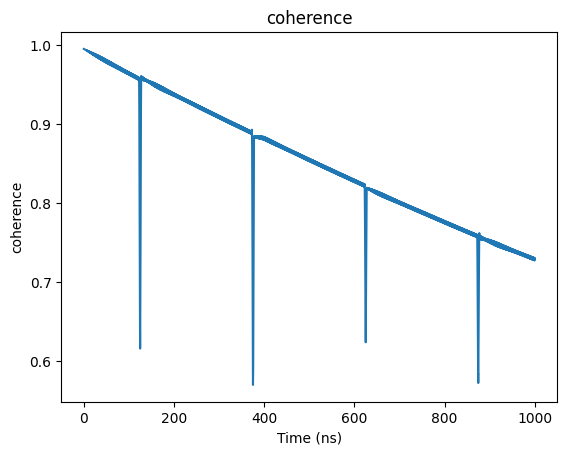

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

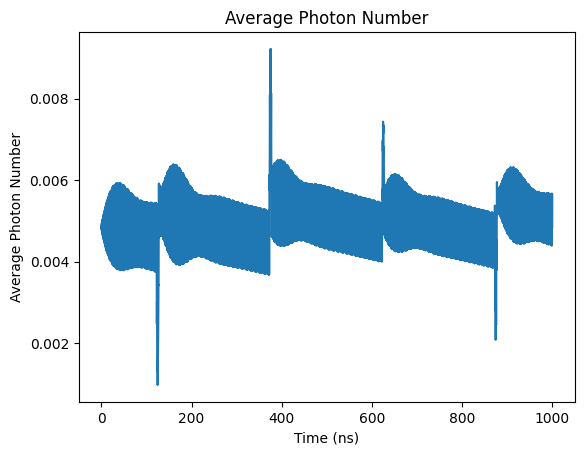

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

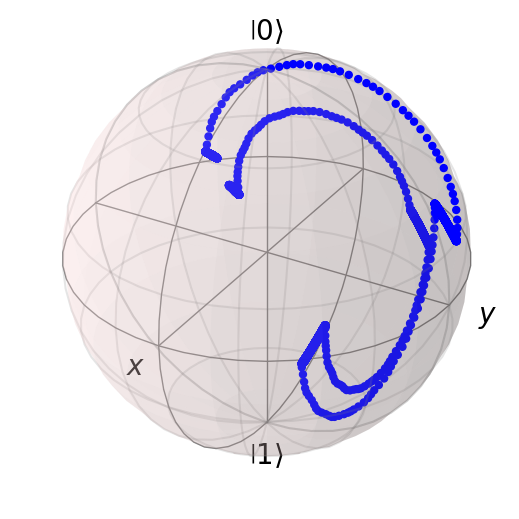

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=8)

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004950167009188221


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

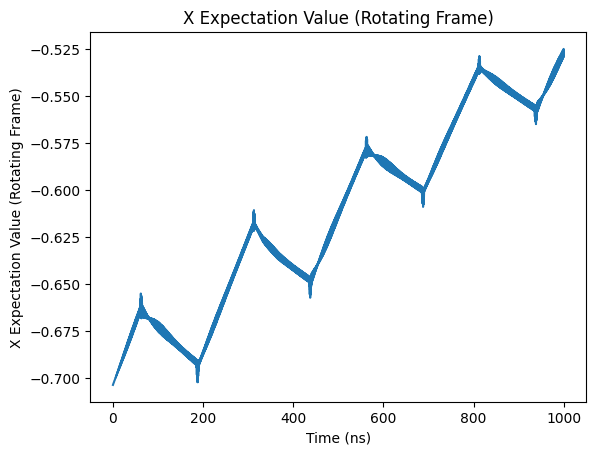

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

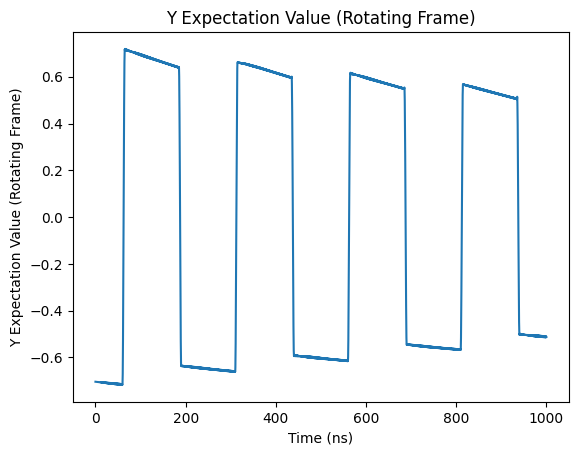

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

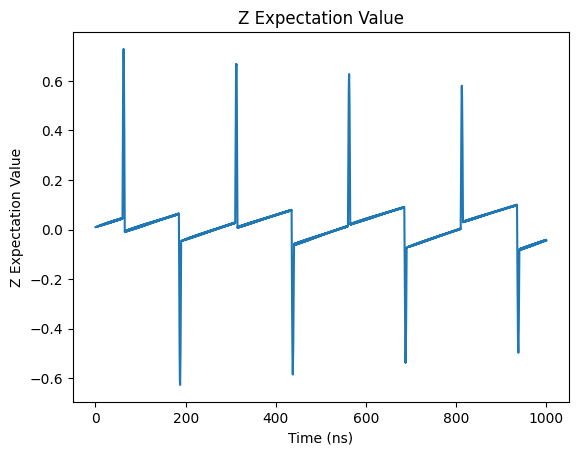

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

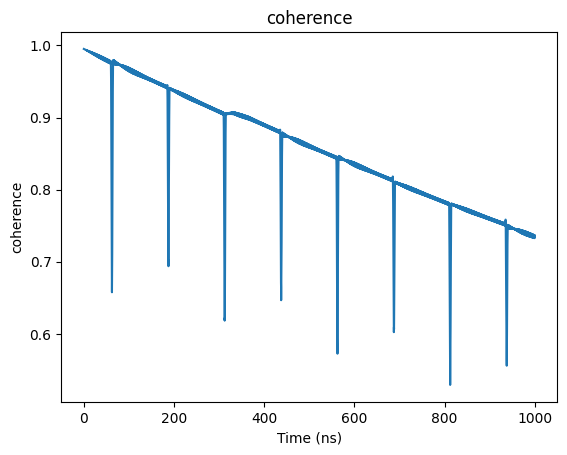

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

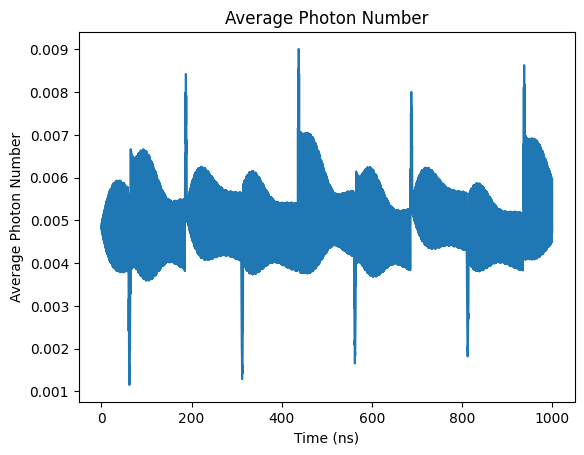

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

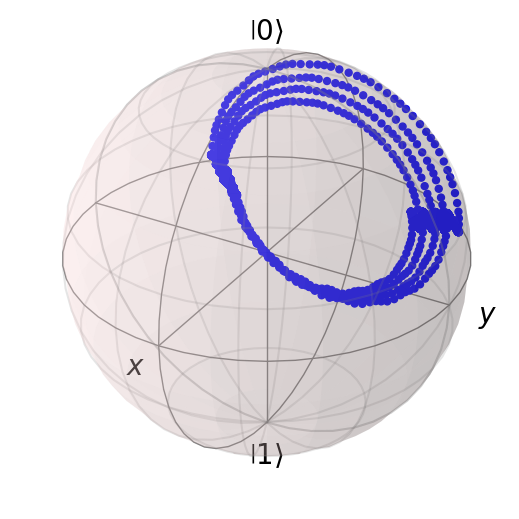

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY8

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY8_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004983039153089399


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

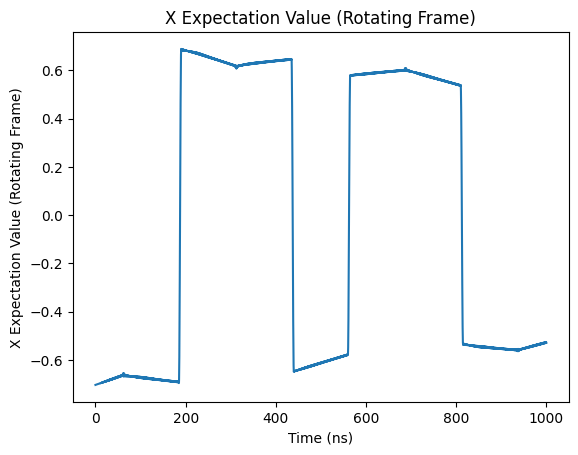

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

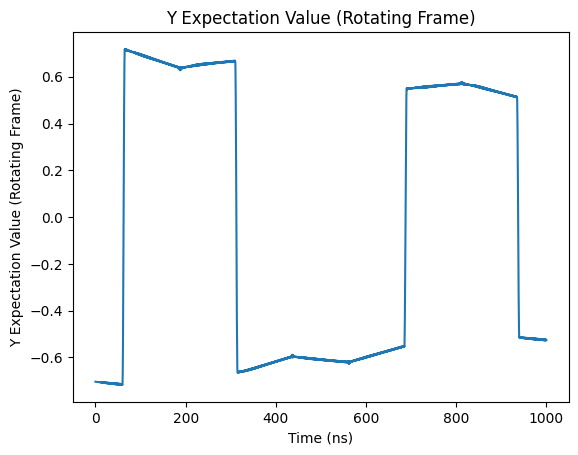

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

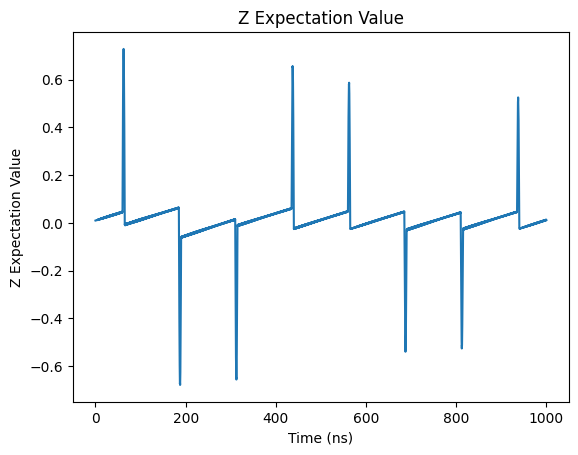

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

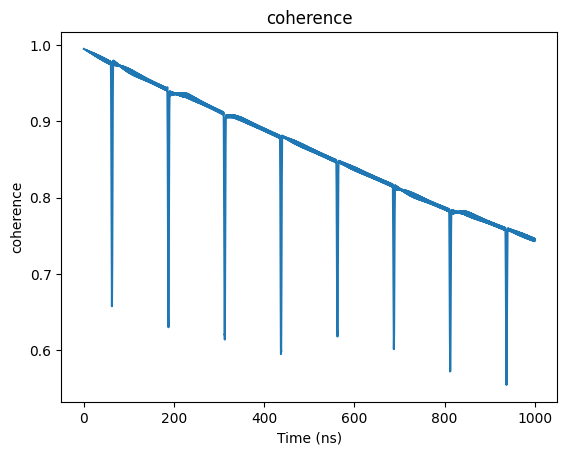

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

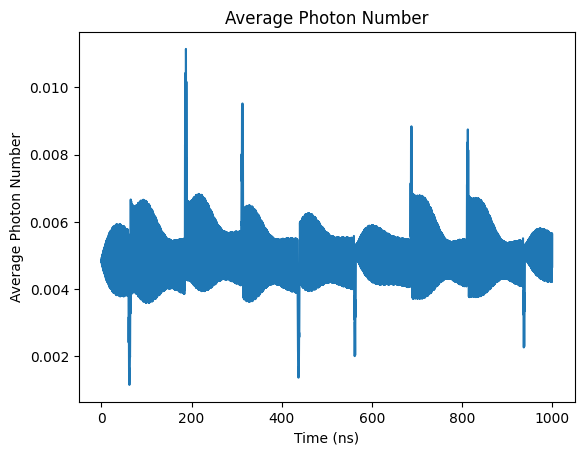

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

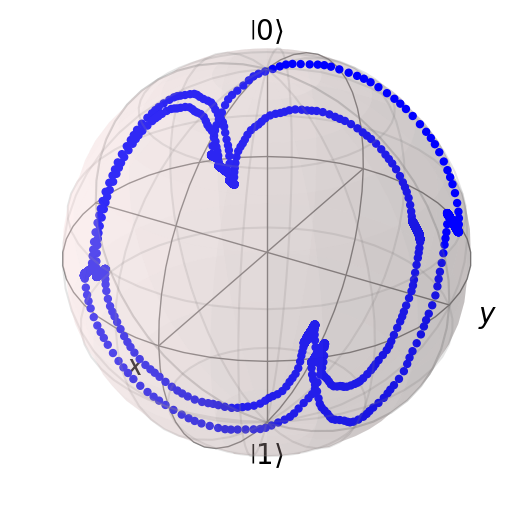

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=16)

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005003759161870984


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

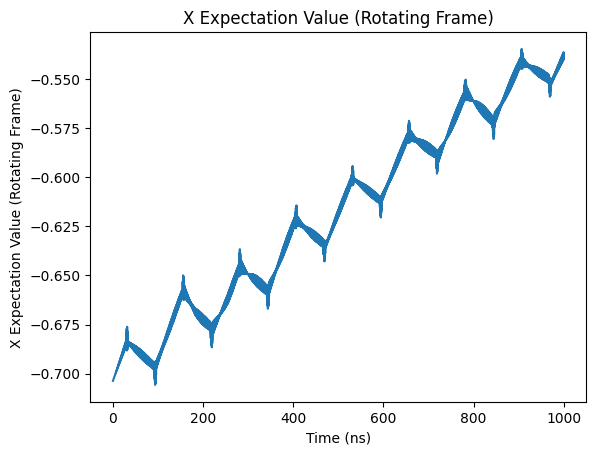

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

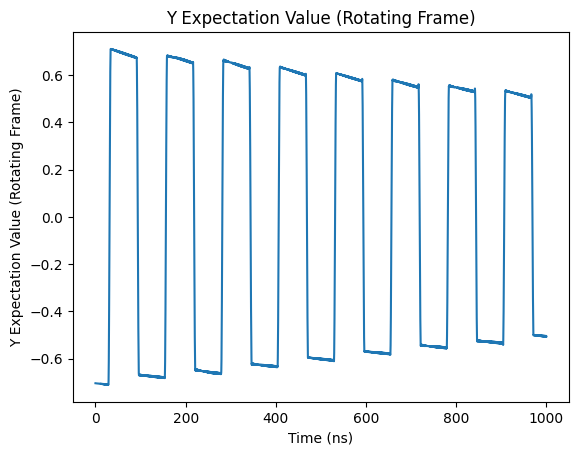

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

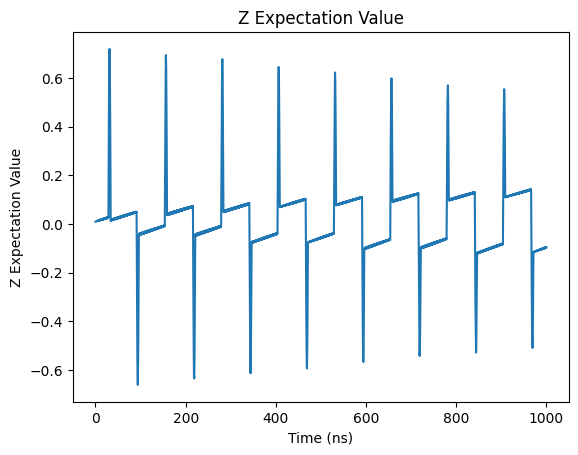

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

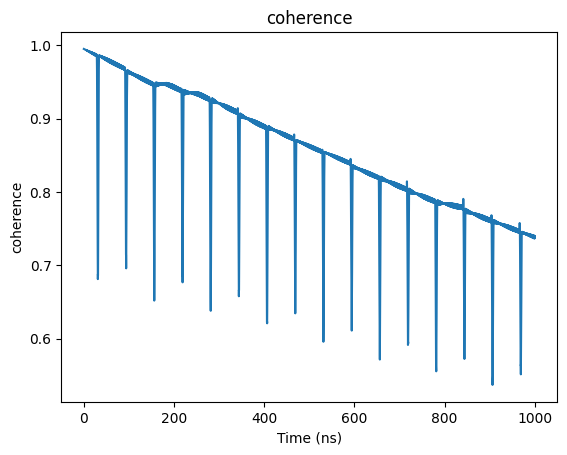

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

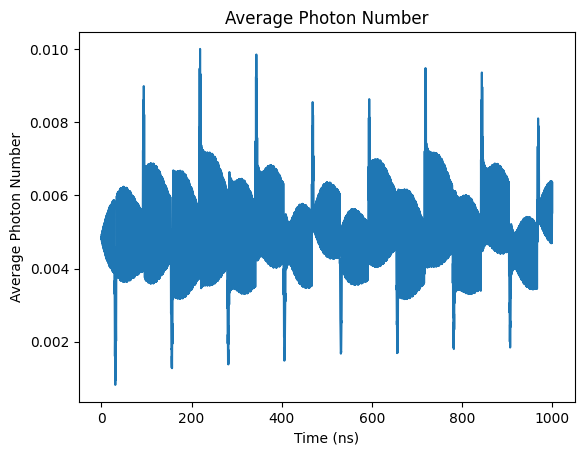

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

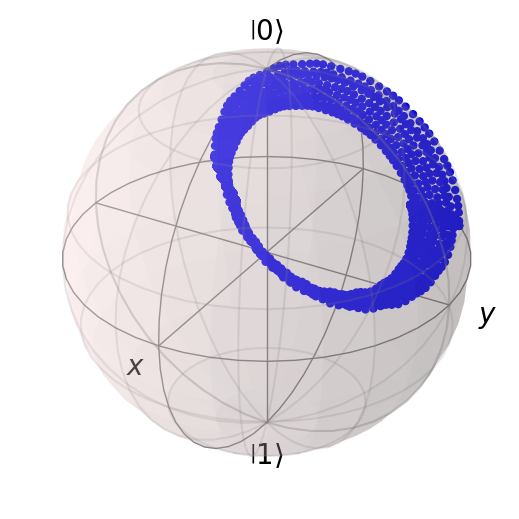

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY16

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY16_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005046876949942005


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

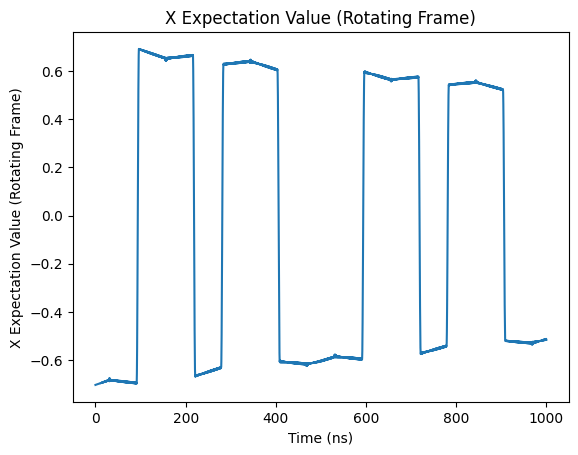

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

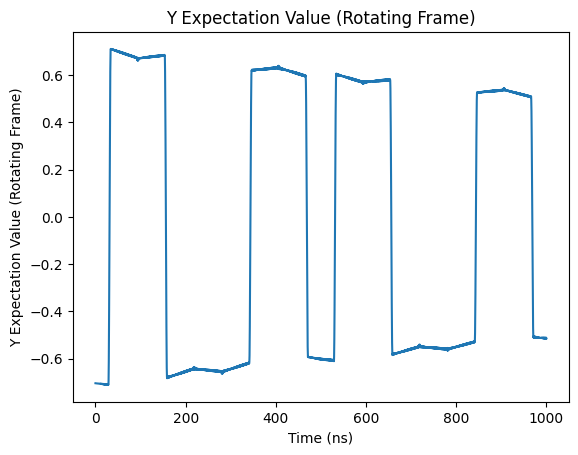

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

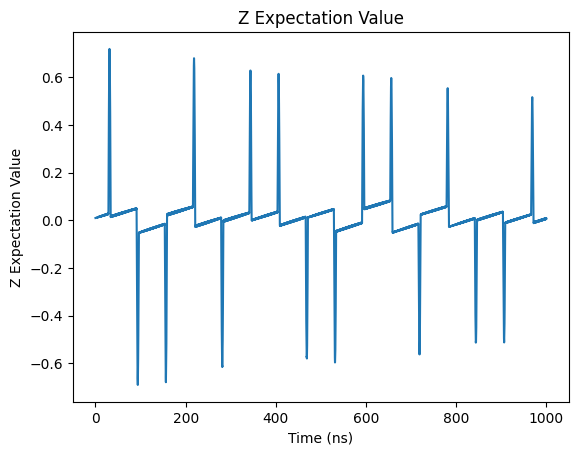

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

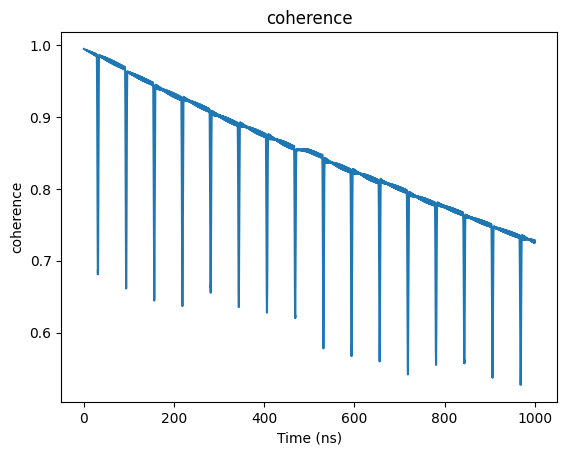

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

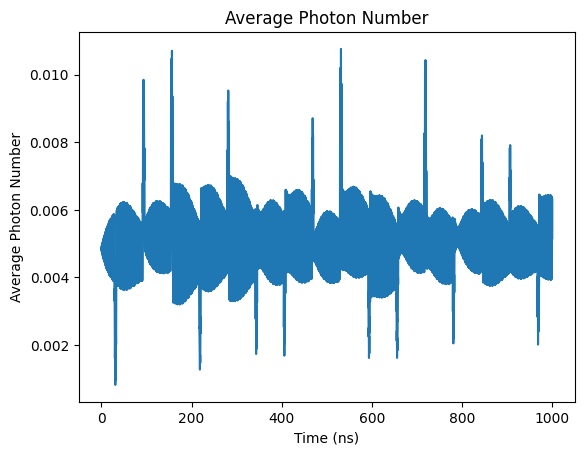

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

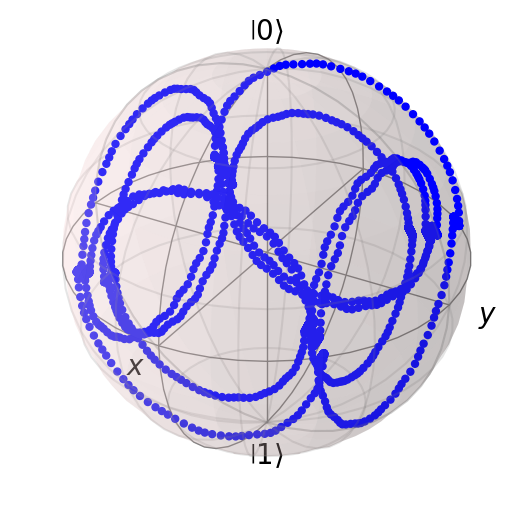

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## Print Coherence & Z

In [ ]:
x_list

[-0.11679314053736656,
 -0.540649296129949,
 -0.5338768305834263,
 -0.5122387192511845,
 -0.527095990338484,
 -0.5276342474873893,
 -0.5382967517374831,
 -0.5143863046751054]

In [ ]:
y_list

[-0.7154467077191357,
 -0.5431955735470273,
 -0.5146266365880554,
 -0.5183900723483555,
 -0.5119159113003965,
 -0.5253471704623696,
 -0.5053678745936876,
 -0.5133766323697111]

In [ ]:
z_list

[0.46181456829631323,
 -0.005069143610131317,
 -0.002123987872094065,
 -0.008390505595096734,
 -0.04290651028593011,
 0.011978559656185803,
 -0.09638706426257566,
 0.007217397992132701]

# Dynamical Decoupling Simulation

$ \omega_{qd} = \omega_q^b + \chi $

Evolution time 1000ns

Initial state $ \cos(\frac{1\pi}{4}) |0\rangle + e^{j\frac{4\pi}{4}} \sin(\frac{1\pi}{4}) |1\rangle $

In [ ]:
N = 5

omega_r = 2 * np.pi * 7.0     # resonator frequency in units of GHz
omega_q = 2 * np.pi * 6.0     # qubit frequency in units of GHz

g = 2 * np.pi * 0.1           # qubit-resonator coupling in units of GHz
kappa = 2 * np.pi * 0.01      # resonator linewidth in units of GHz

detune = omega_q-omega_r
chi = g*g/(detune)

omega_rd = omega_r            # qubit frequency in units of GHz
omega_qd = omega_q + chi      # qubit frequency in units of GHz

sx = sigmax()
sy = sigmay()
sz = sigmaz()
sp = basis(2,1)*basis(2,0).dag()
sm = basis(2,0)*basis(2,1).dag()
a = destroy(N)

sx_composite = tensor(sx, qeye(N))
sy_composite = tensor(sy, qeye(N))
sz_composite = tensor(sz, qeye(N))
sp_composite = tensor(sp, qeye(N))
number_composite = tensor(qeye(2), a.dag()*a)

op_list = [sx_composite, sy_composite, sz_composite, sp_composite, number_composite]

tlist = np.linspace(0, 500, 5000)
T_end_q = 500

cos = np.sqrt(0.5 + 0.5*5/np.sqrt(26))
sin = np.sqrt(0.5 - 0.5*5/np.sqrt(26))


psi_20 = tensor(basis(2,0), basis(N,0))
psi_21 = cos*tensor(basis(2,1), basis(N,0)) - sin*tensor(basis(2,0), basis(N,1))
psi_2s = np.cos(1*np.pi/4) * psi_20 + np.exp(1j*np.pi*4/4) * np.sin(1*np.pi/4) * psi_21


H0 = -0.5*omega_q*sz_composite + omega_r*number_composite + g*(tensor(sm, a.dag()) + tensor(sp, a))
H1 = tensor(qeye(2), a + a.dag())
H2 = sx_composite

A = 0.0002 * 2 * np.pi
B = 0.1 * 2 * np.pi

x_list = []
y_list = []
z_list = []

## Ramsey

In [ ]:
# Simulation

N_seq = 0

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))
print([x_rot[0], y_rot[0], result.expect[2][0]])

0.004267884323586519
[-0.9951333266680702, -1.2186868432289094e-16, 0.009709662154540055]


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

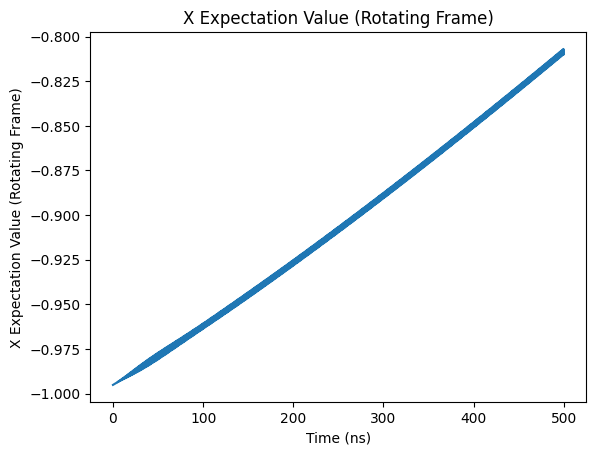

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

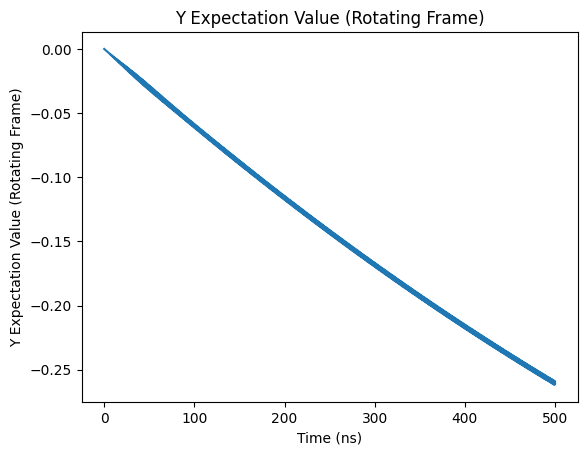

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

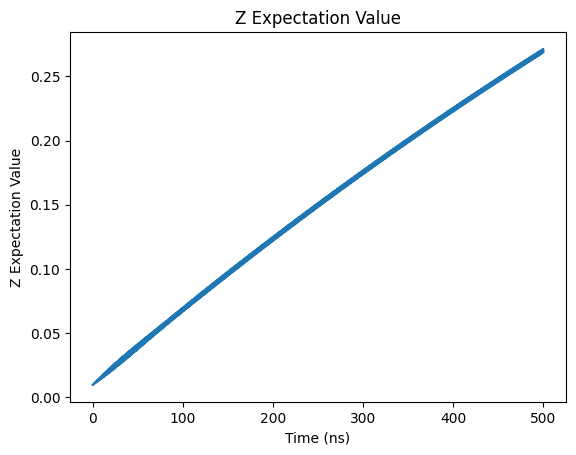

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

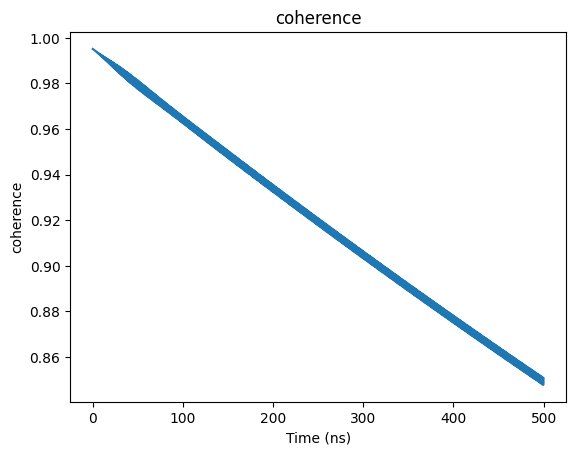

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

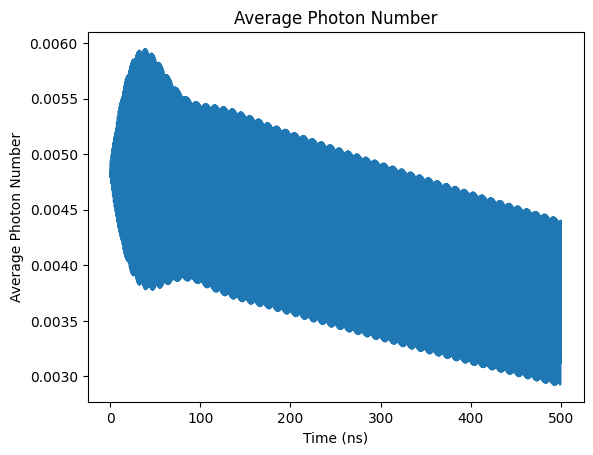

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

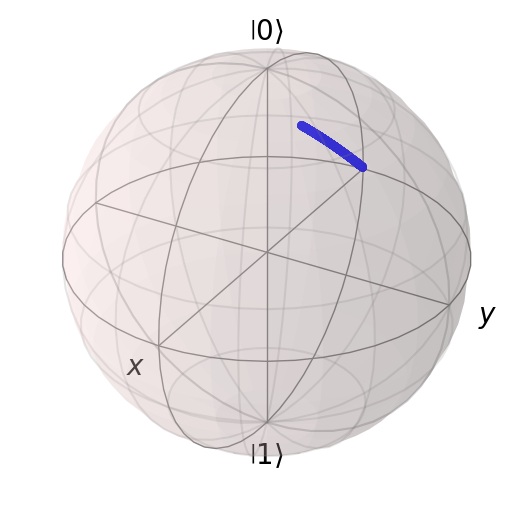

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=2)

In [ ]:
# Simulation

N_seq = 2

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004877792063555626


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

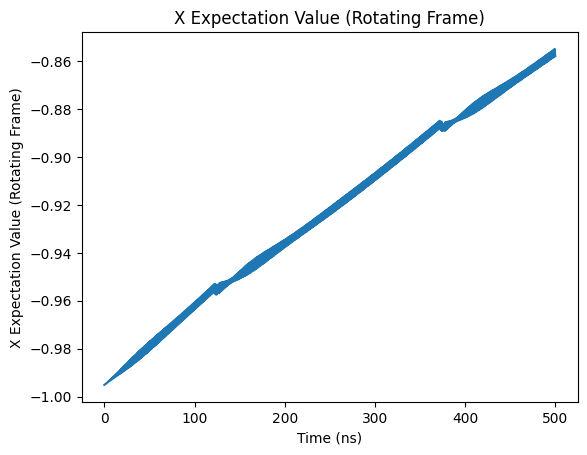

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

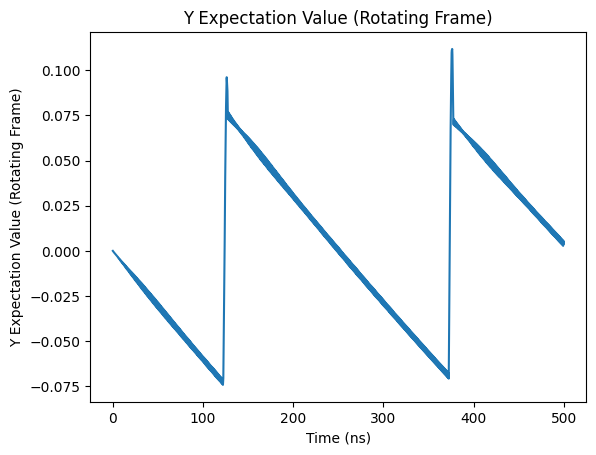

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

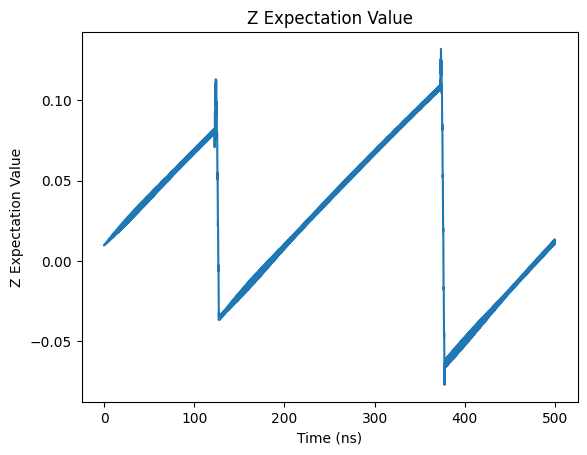

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

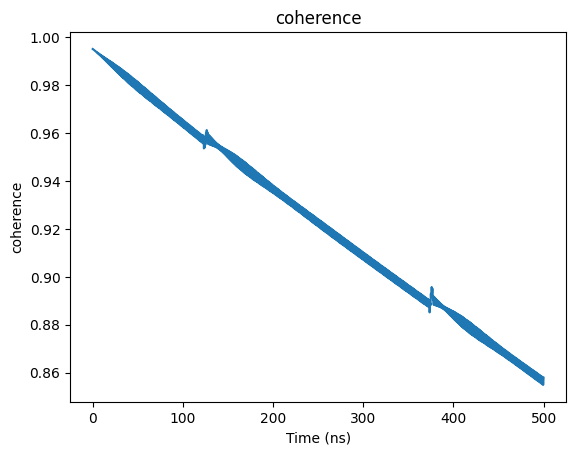

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

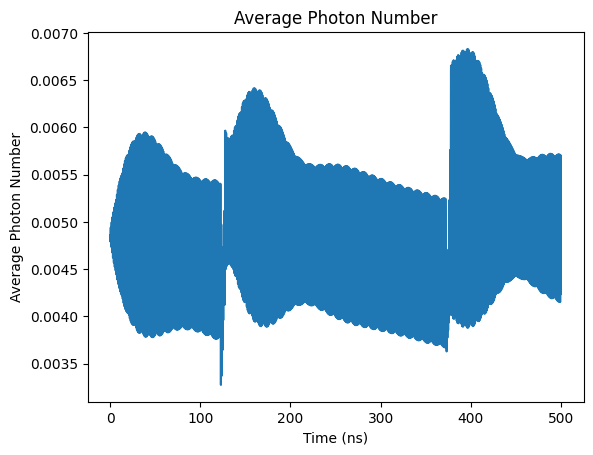

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

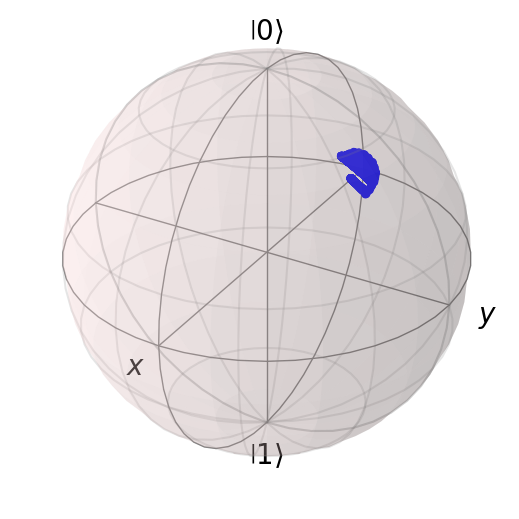

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=4)

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004937232613061849


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

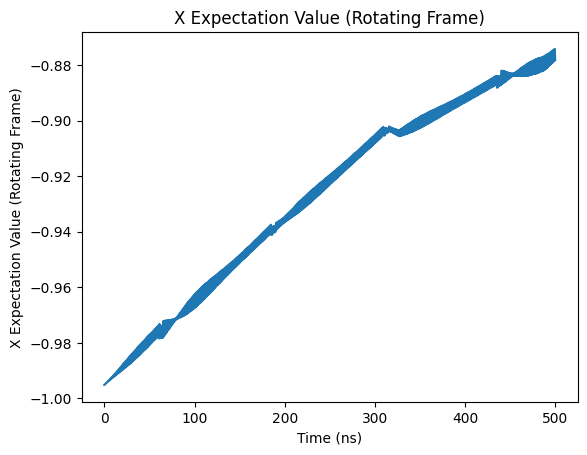

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

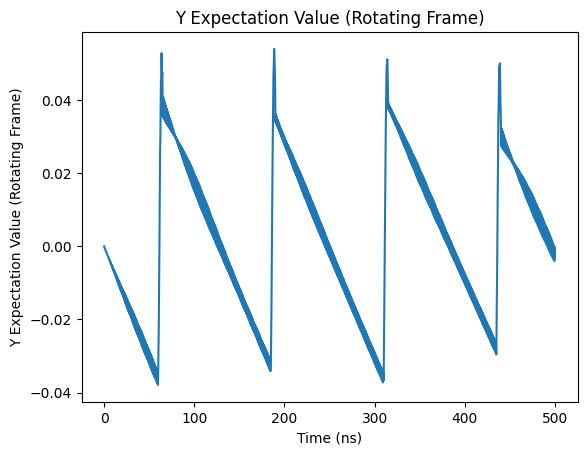

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

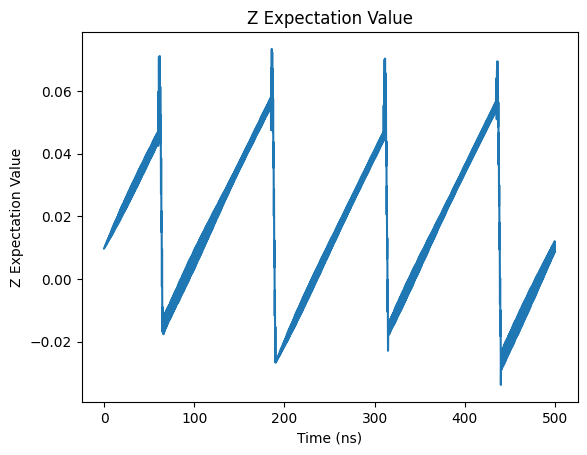

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

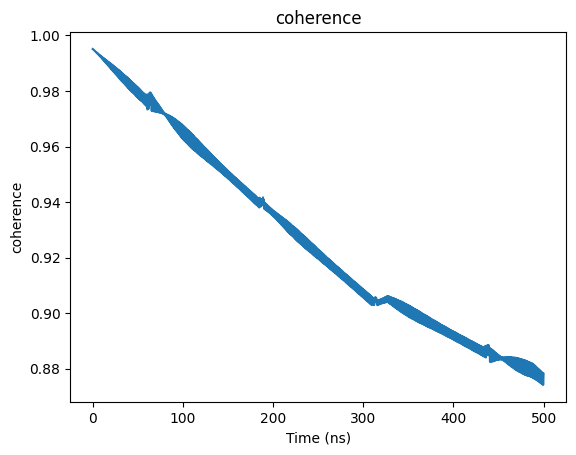

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

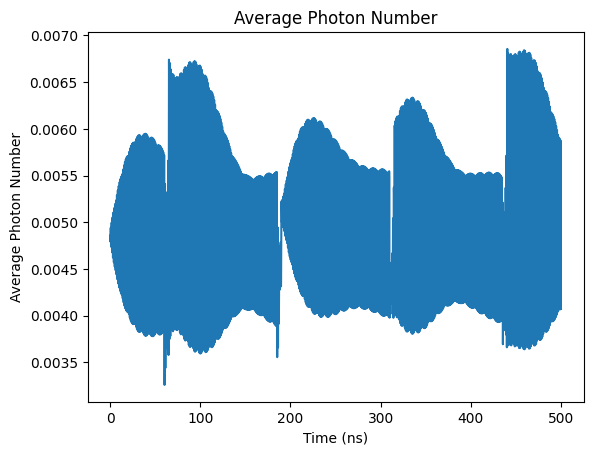

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

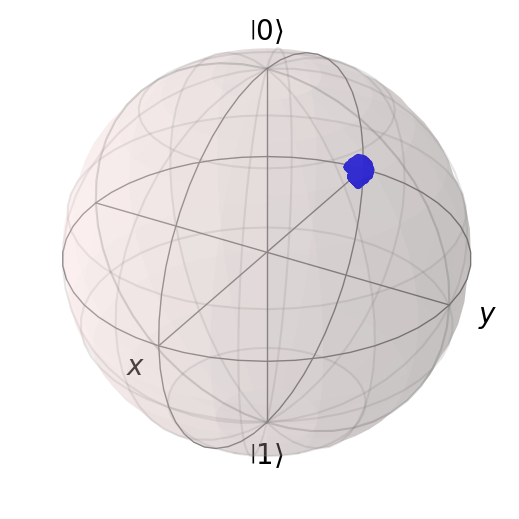

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY4

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY4_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005068619317808107


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

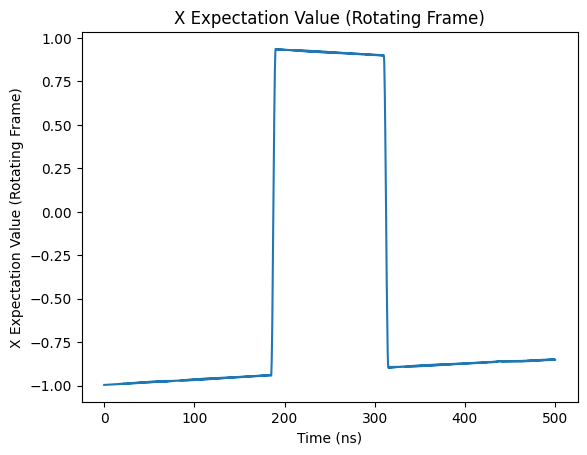

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

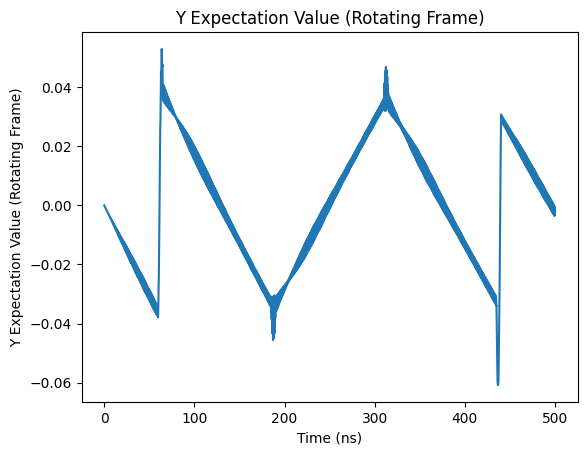

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

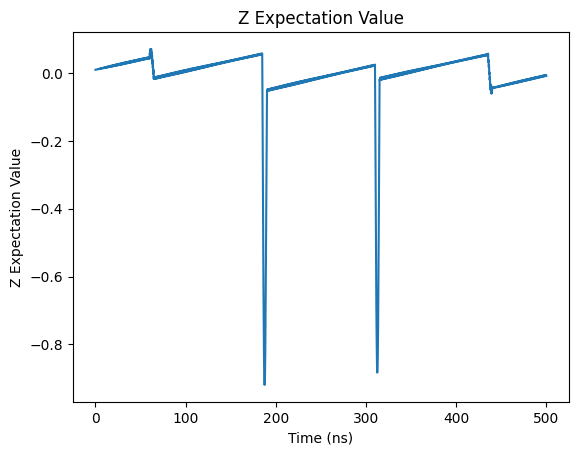

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

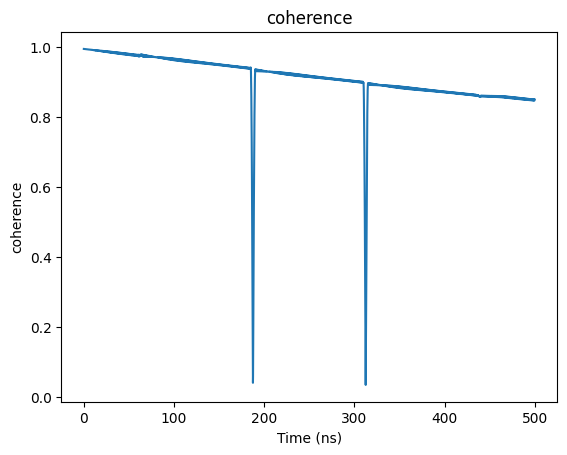

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

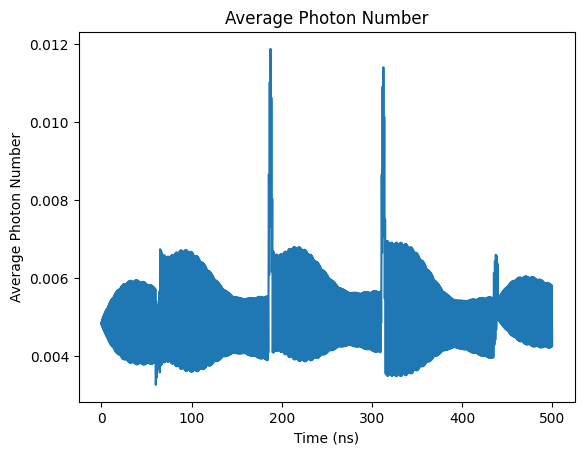

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

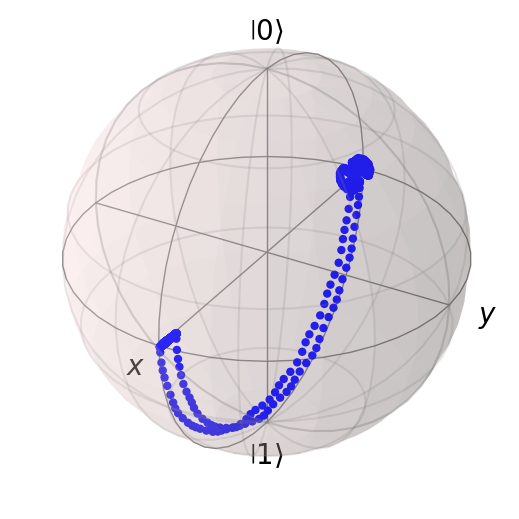

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=8)

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004980209068635254


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

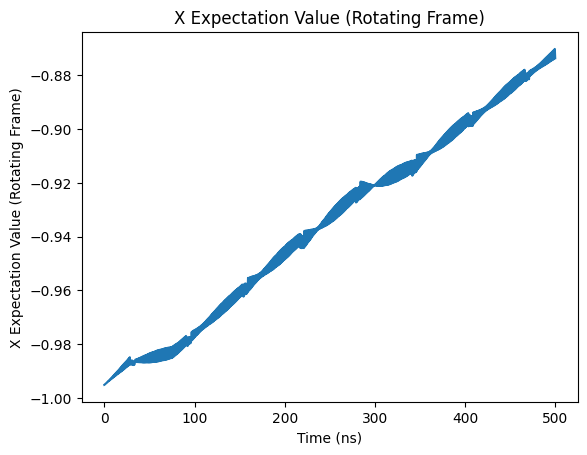

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

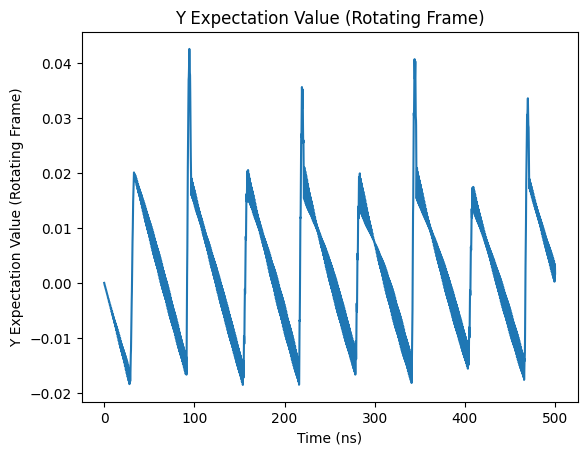

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

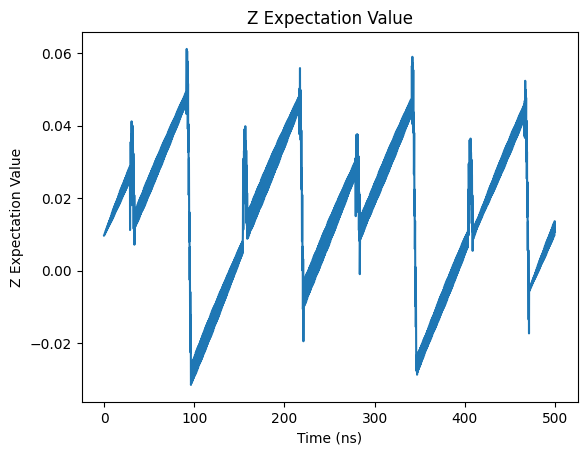

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

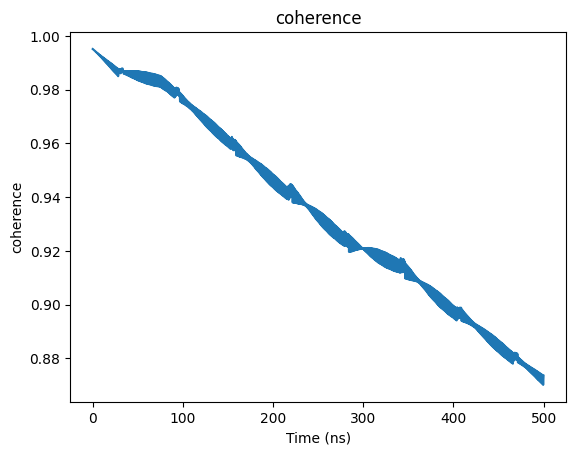

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

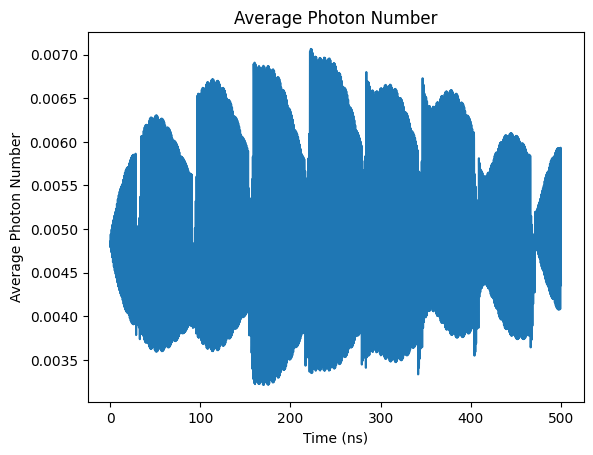

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

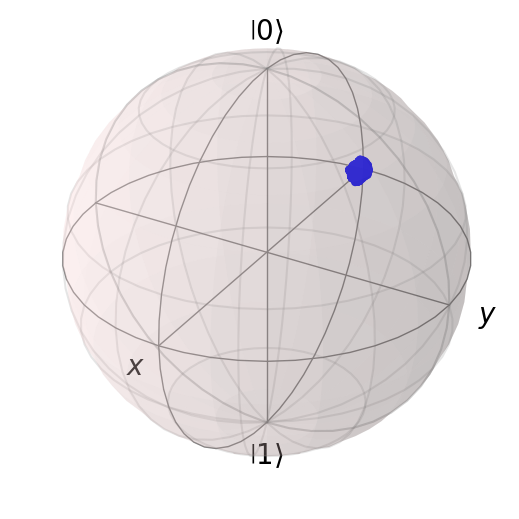

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY8

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY8_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.0050075057957243655


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

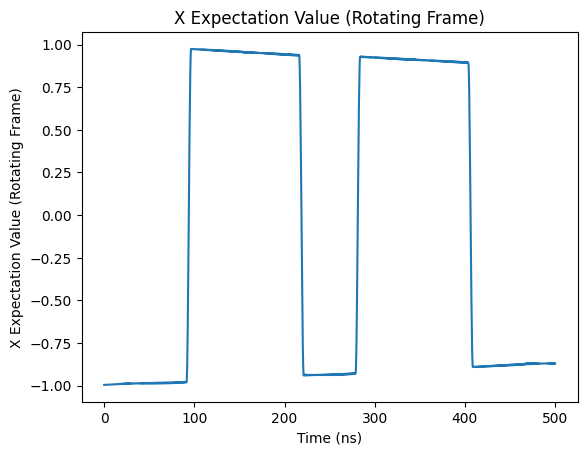

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

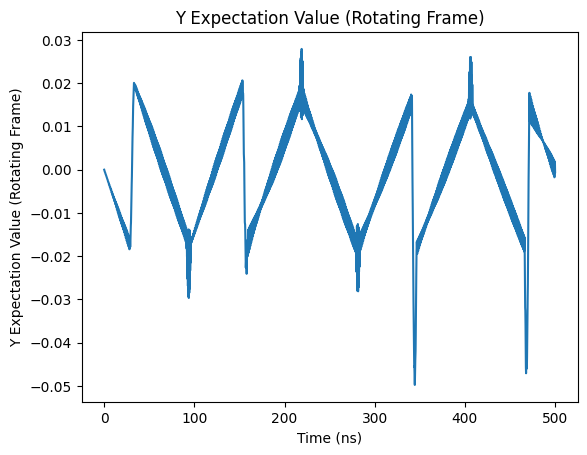

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

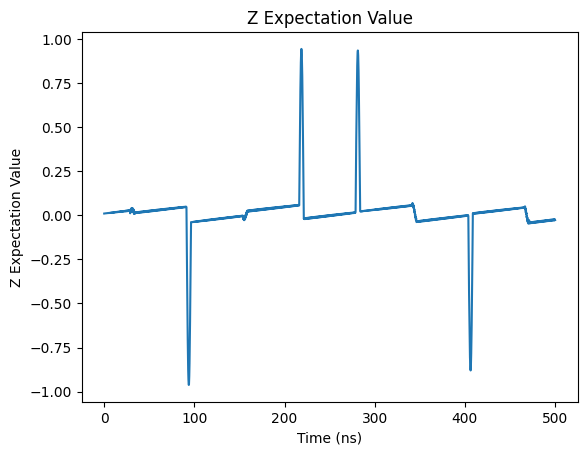

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

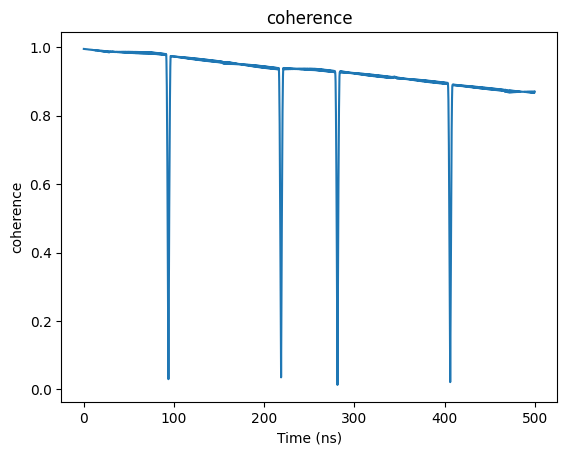

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

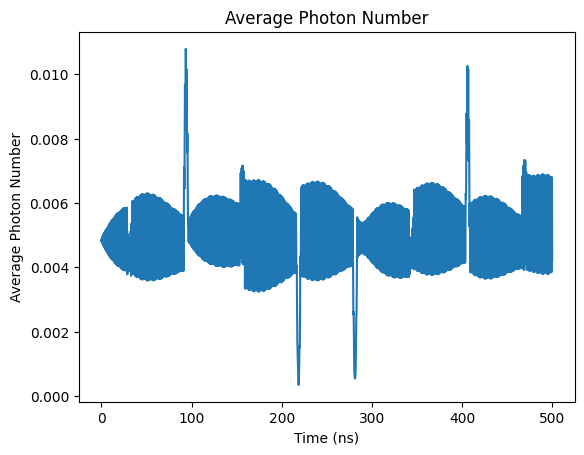

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

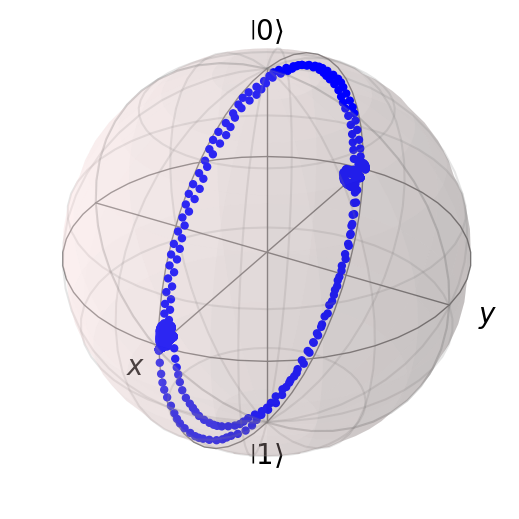

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=16)

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005067413042950347


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

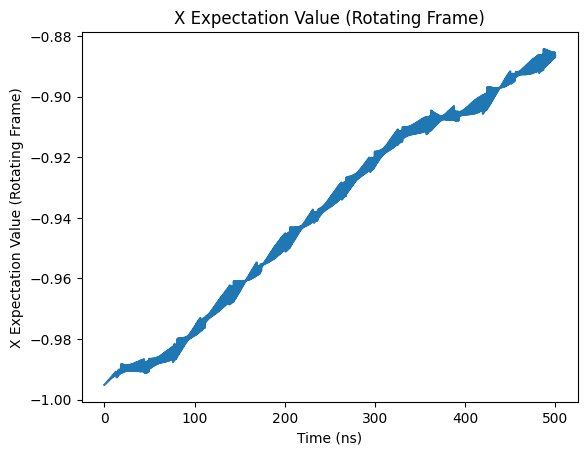

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

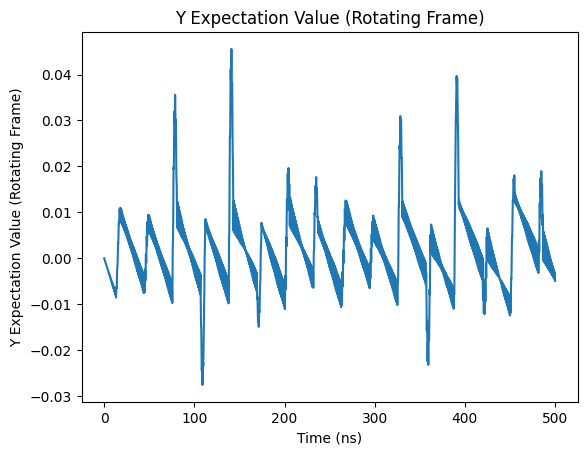

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

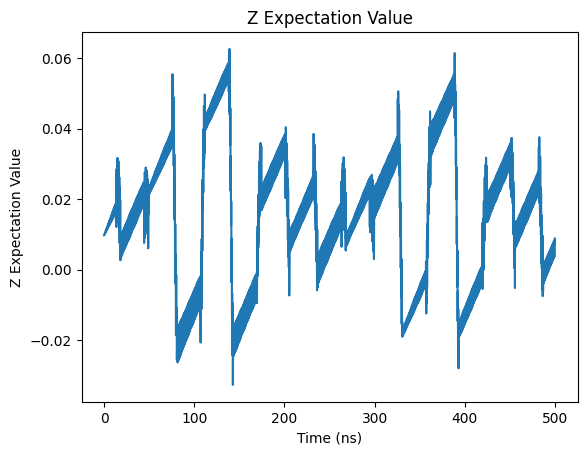

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

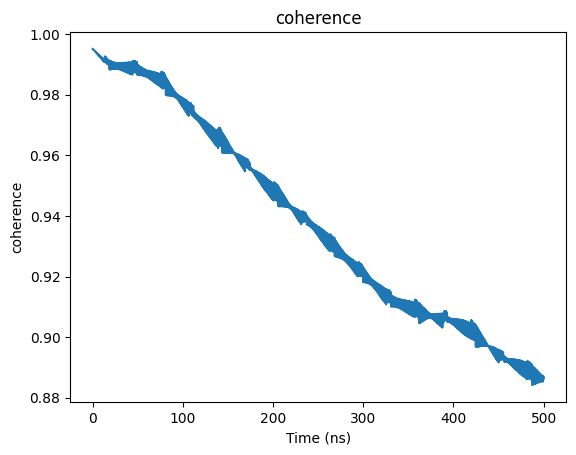

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

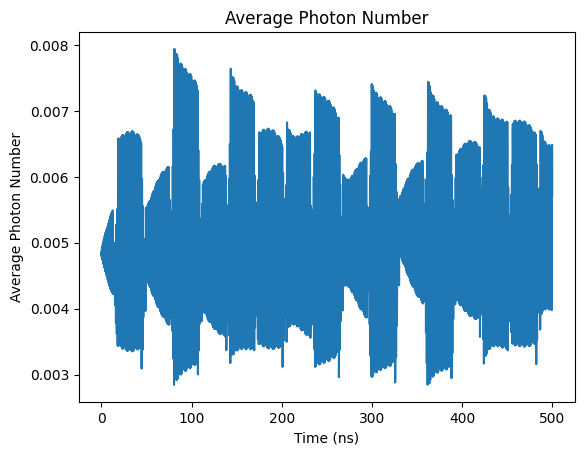

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

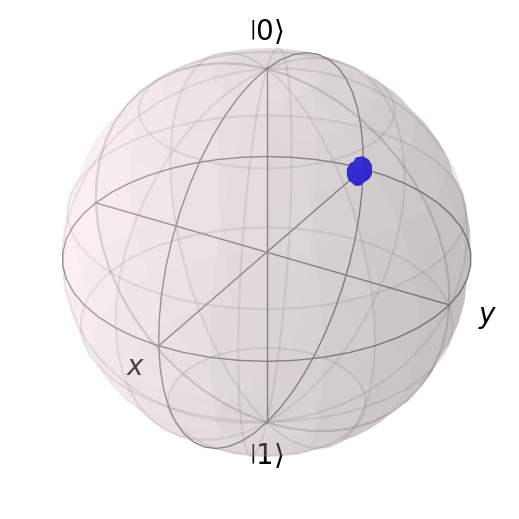

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY16

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY16_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005247757437271386


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

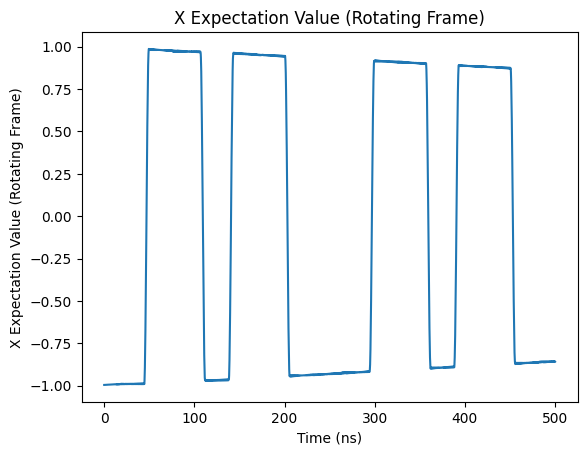

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

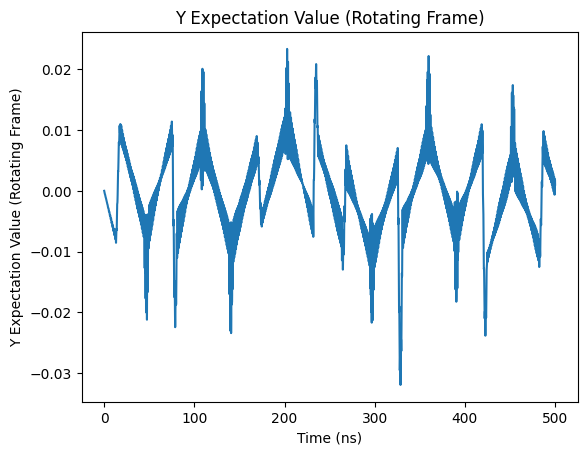

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

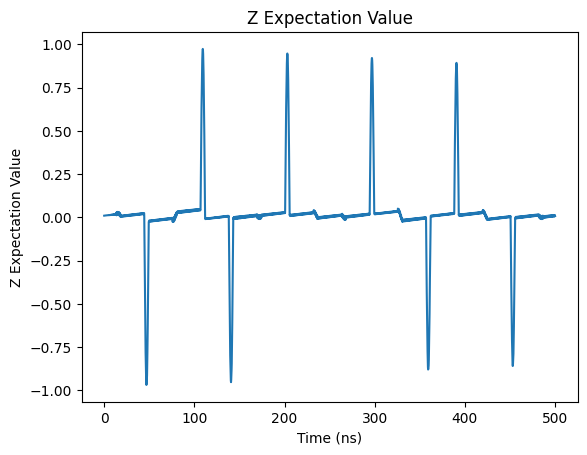

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

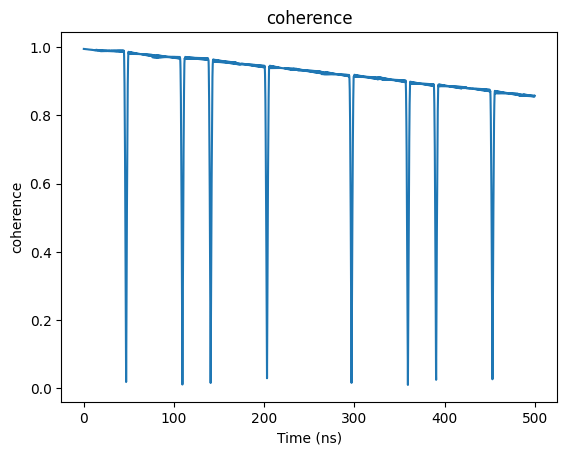

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

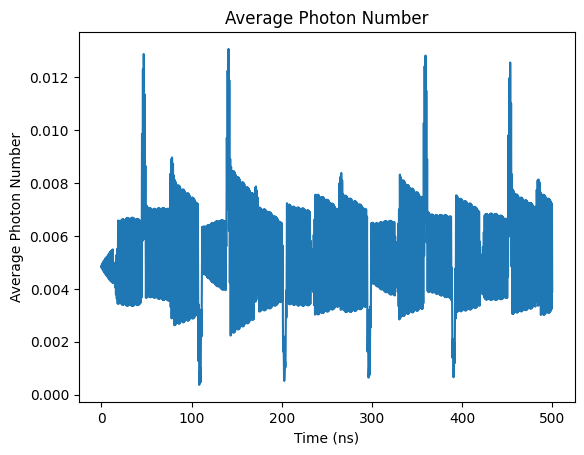

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

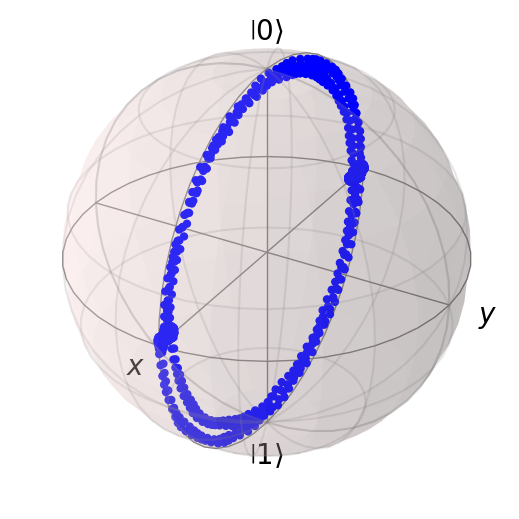

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## Print Coherence & Z

In [ ]:
x_list

[-0.8085006409047839,
 -0.8564597940767771,
 -0.87627594237545,
 -0.8488940380304101,
 -0.8719323785817874,
 -0.8684320403253889,
 -0.8862014508530823,
 -0.8567090333044705]

In [ ]:
y_list

[-0.2603954146326093,
 0.004152005802372886,
 -0.0021766697110132986,
 -0.0020802115937719814,
 0.0018267320022655944,
 -9.876168316721307e-06,
 -0.0038704686768260784,
 0.0006363663490915744]

In [ ]:
z_list

[0.2698532267774185,
 0.011837065522780838,
 0.010234771323799938,
 -0.007015855327084974,
 0.011746144893898478,
 -0.025441929010731713,
 0.0062022311613716494,
 0.0096981251756112]

# Dynamical Decoupling Simulation

$ \omega_{qd} = \omega_q^b + \chi $

Evolution time 1000ns

Initial state $ \cos(\frac{1\pi}{4}) |0\rangle + e^{j\frac{5\pi}{4}} \sin(\frac{1\pi}{4}) |1\rangle $

In [ ]:
N = 5

omega_r = 2 * np.pi * 7.0     # resonator frequency in units of GHz
omega_q = 2 * np.pi * 6.0     # qubit frequency in units of GHz

g = 2 * np.pi * 0.1           # qubit-resonator coupling in units of GHz
kappa = 2 * np.pi * 0.01      # resonator linewidth in units of GHz

detune = omega_q-omega_r
chi = g*g/(detune)

omega_rd = omega_r            # qubit frequency in units of GHz
omega_qd = omega_q + chi      # qubit frequency in units of GHz

sx = sigmax()
sy = sigmay()
sz = sigmaz()
sp = basis(2,1)*basis(2,0).dag()
sm = basis(2,0)*basis(2,1).dag()
a = destroy(N)

sx_composite = tensor(sx, qeye(N))
sy_composite = tensor(sy, qeye(N))
sz_composite = tensor(sz, qeye(N))
sp_composite = tensor(sp, qeye(N))
number_composite = tensor(qeye(2), a.dag()*a)

op_list = [sx_composite, sy_composite, sz_composite, sp_composite, number_composite]

tlist = np.linspace(0, 500, 5000)
T_end_q = 500

cos = np.sqrt(0.5 + 0.5*5/np.sqrt(26))
sin = np.sqrt(0.5 - 0.5*5/np.sqrt(26))


psi_20 = tensor(basis(2,0), basis(N,0))
psi_21 = cos*tensor(basis(2,1), basis(N,0)) - sin*tensor(basis(2,0), basis(N,1))
psi_2s = np.cos(1*np.pi/4) * psi_20 + np.exp(1j*np.pi*5/4) * np.sin(1*np.pi/4) * psi_21


H0 = -0.5*omega_q*sz_composite + omega_r*number_composite + g*(tensor(sm, a.dag()) + tensor(sp, a))
H1 = tensor(qeye(2), a + a.dag())
H2 = sx_composite

A = 0.0002 * 2 * np.pi
B = 0.1 * 2 * np.pi

x_list = []
y_list = []
z_list = []

## Ramsey

In [ ]:
# Simulation

N_seq = 0

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))
print([x_rot[0], y_rot[0], result.expect[2][0]])

0.004267792654426617
[-0.7036655234717204, 0.7036655234717201, 0.00970966215454]


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

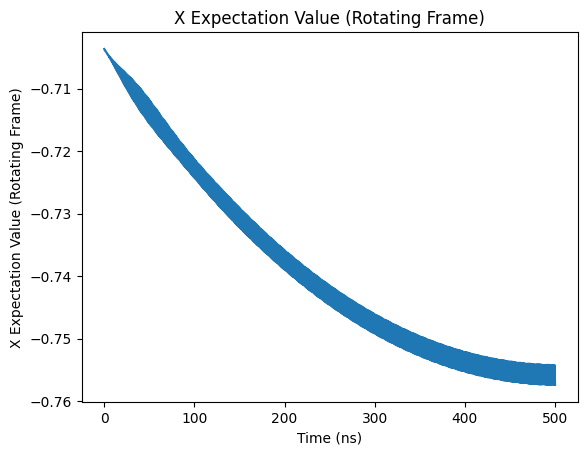

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

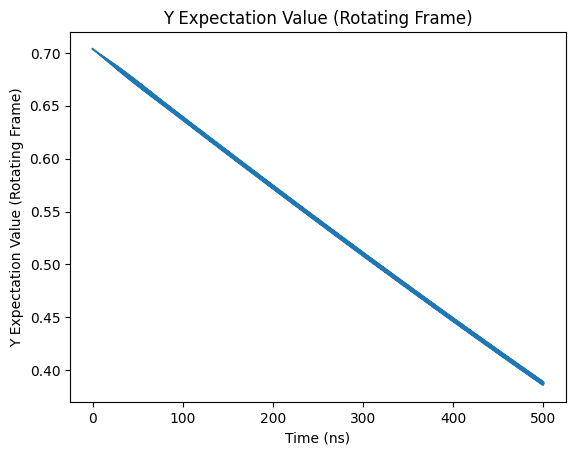

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

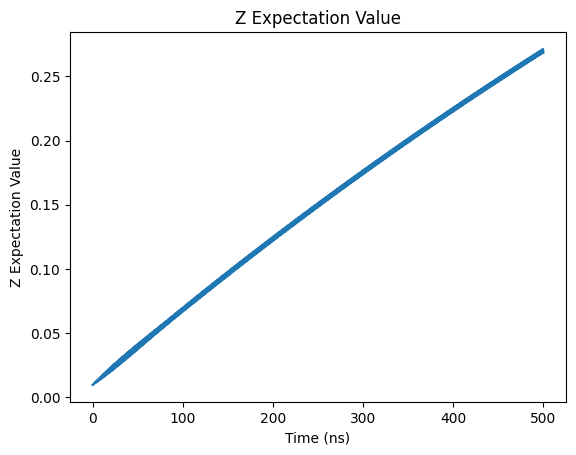

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

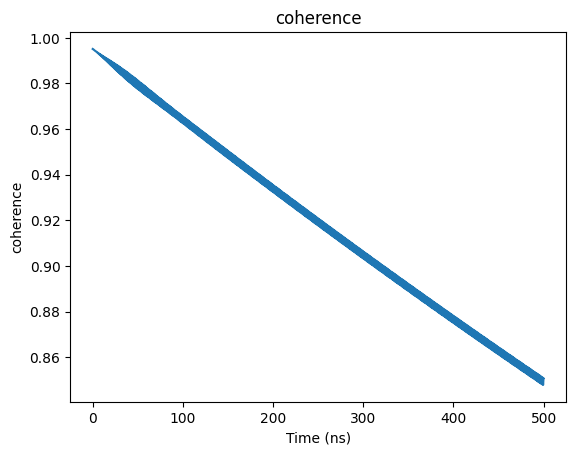

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

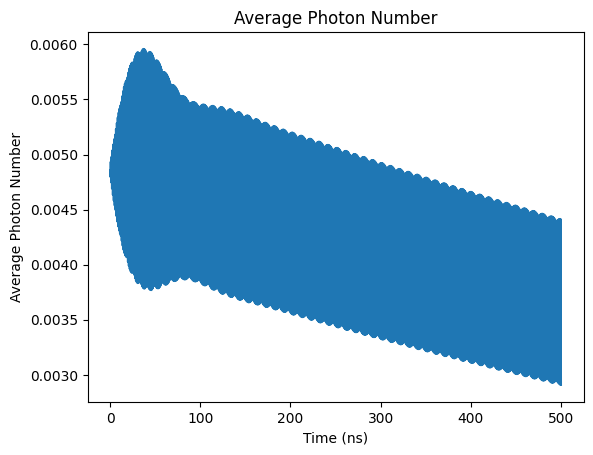

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

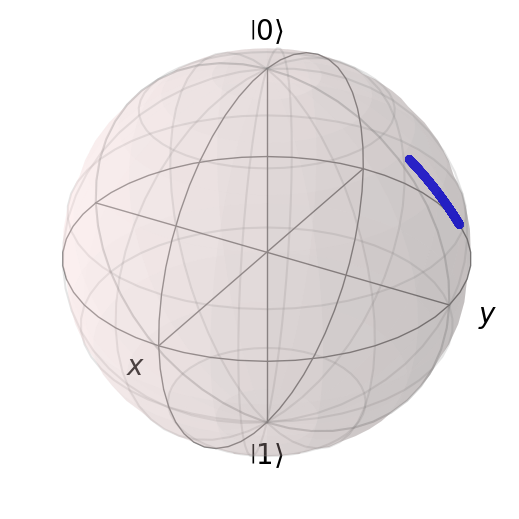

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=2)

In [ ]:
# Simulation

N_seq = 2

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004902142763899626


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

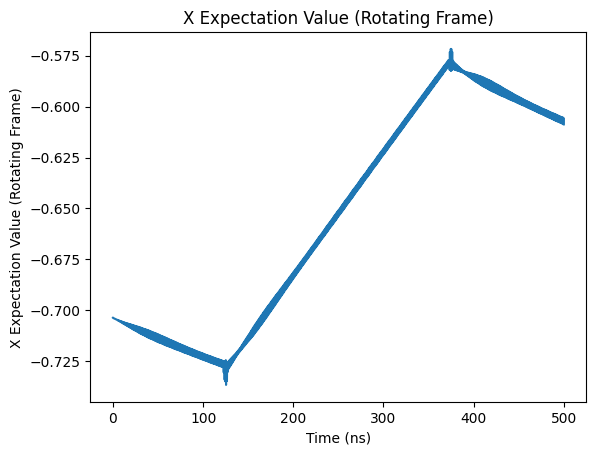

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

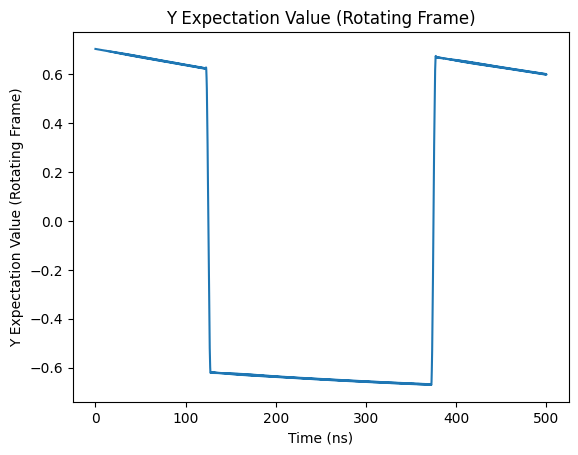

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

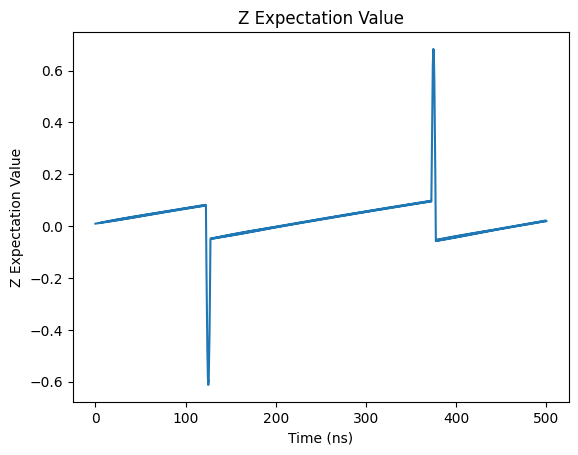

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

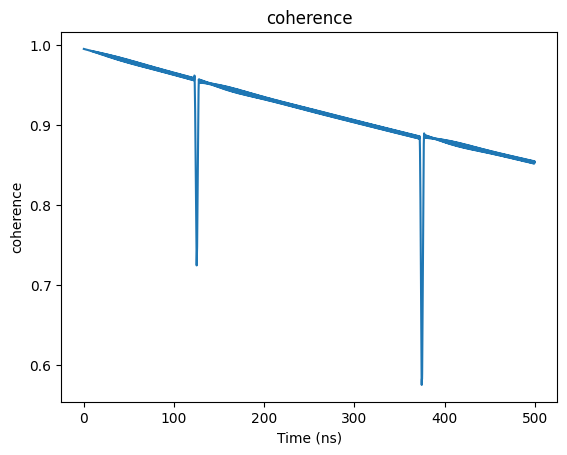

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

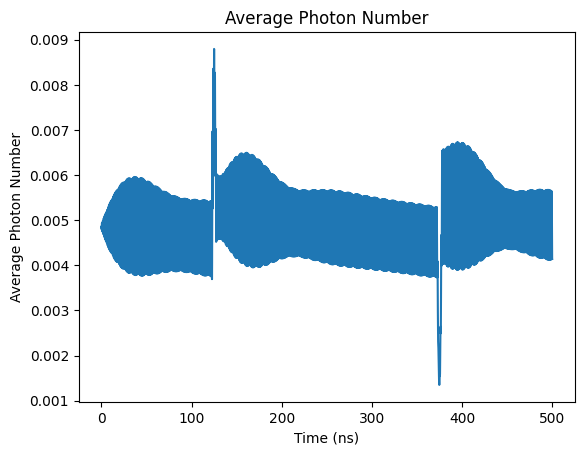

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

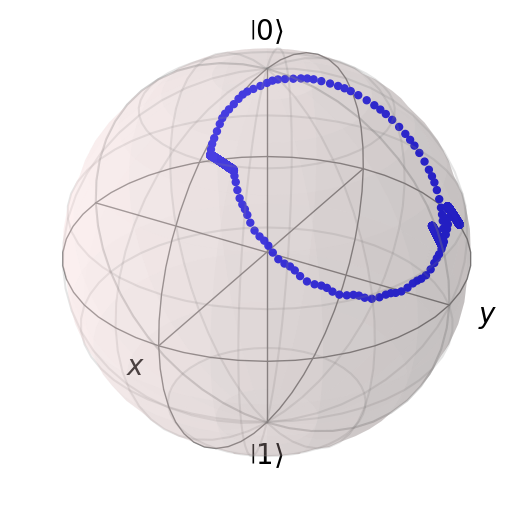

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=4)

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004953657881276433


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

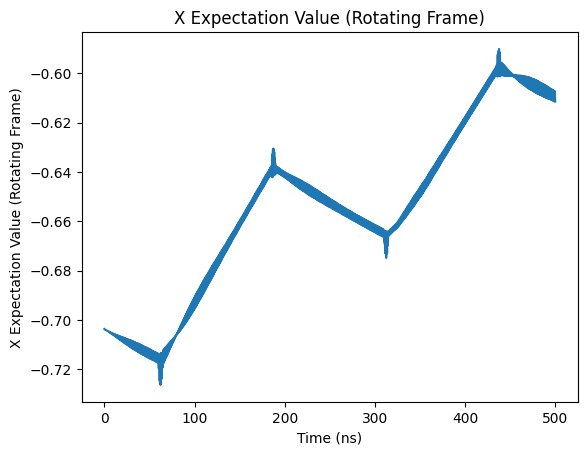

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

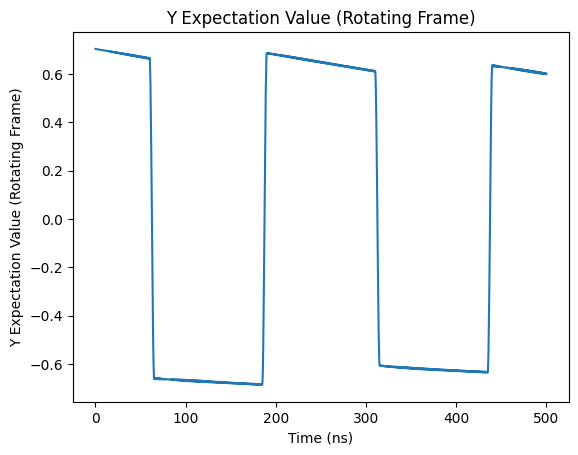

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

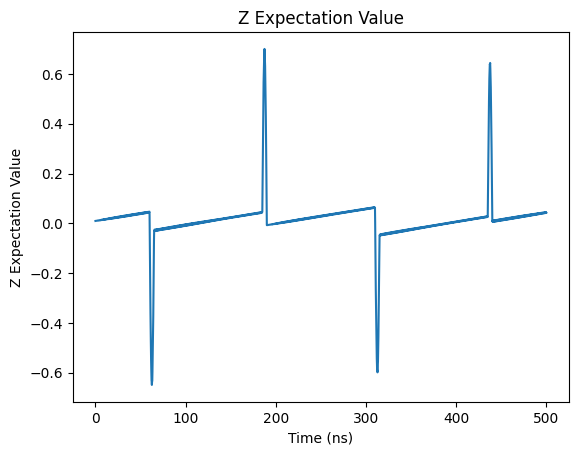

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

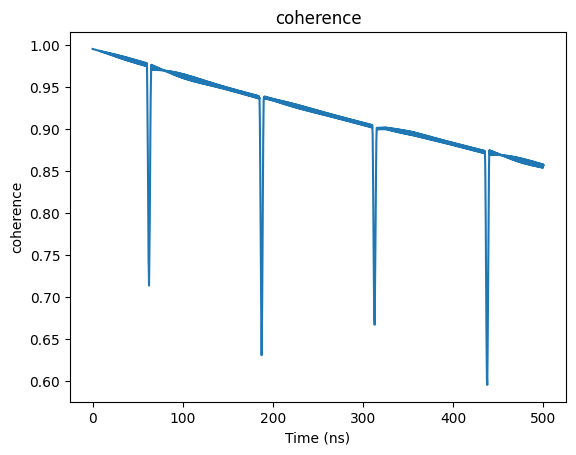

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

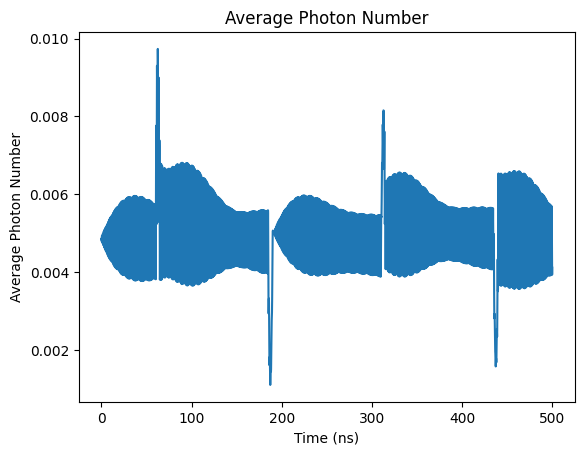

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

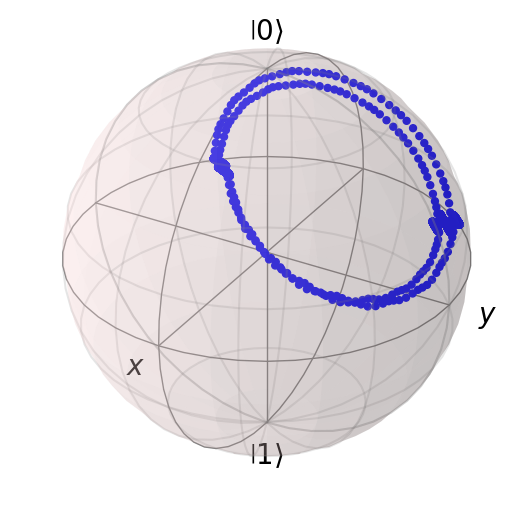

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY4

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY4_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.0050994884327011545


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

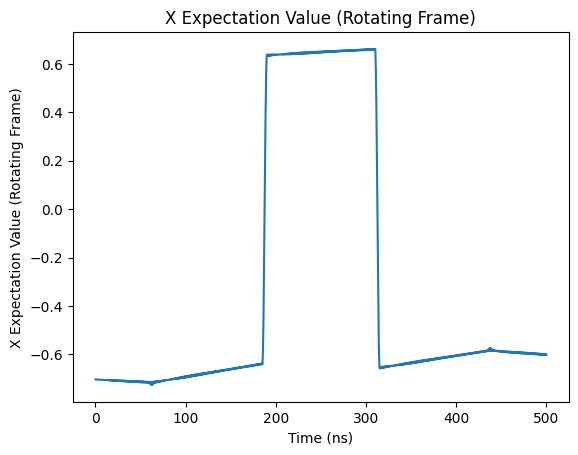

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

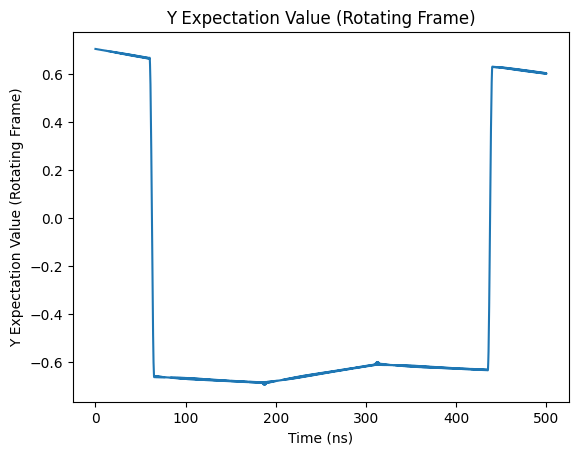

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

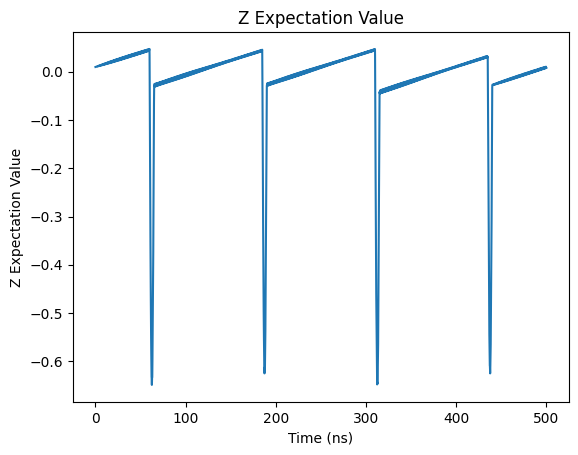

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

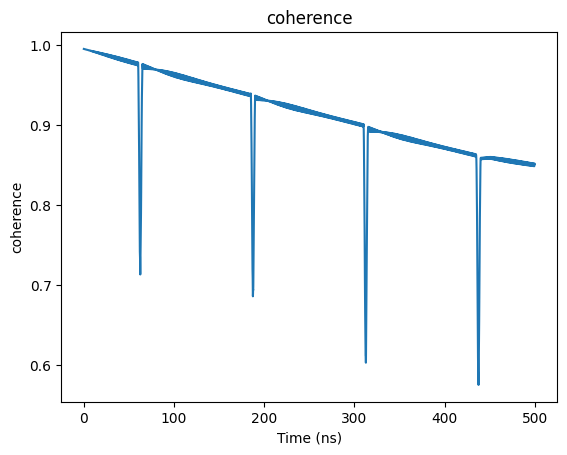

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

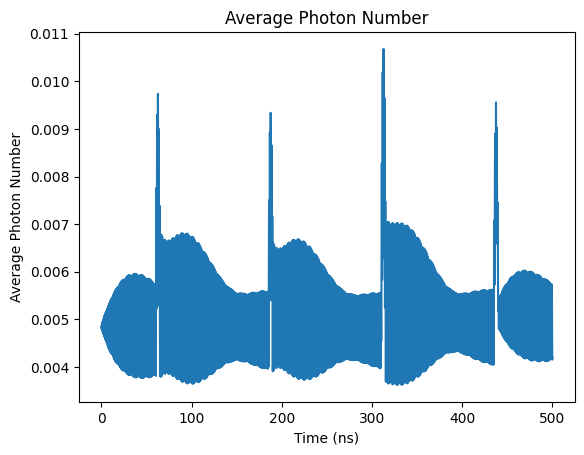

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

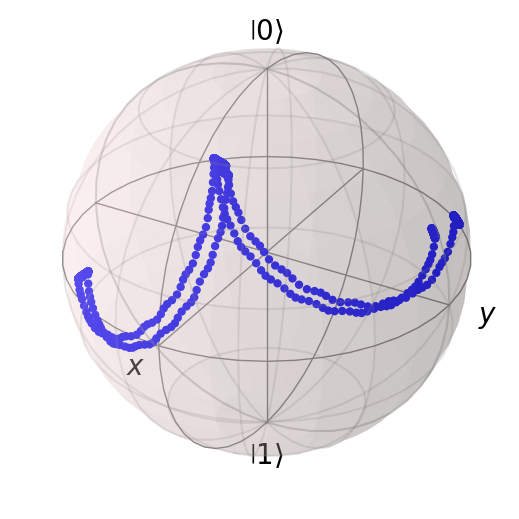

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=8)

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.00500316862244445


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

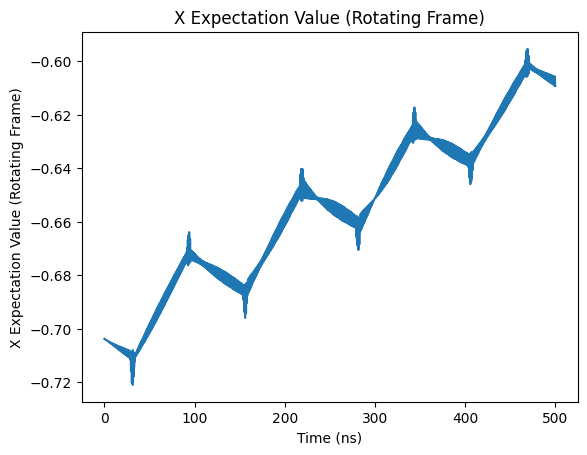

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

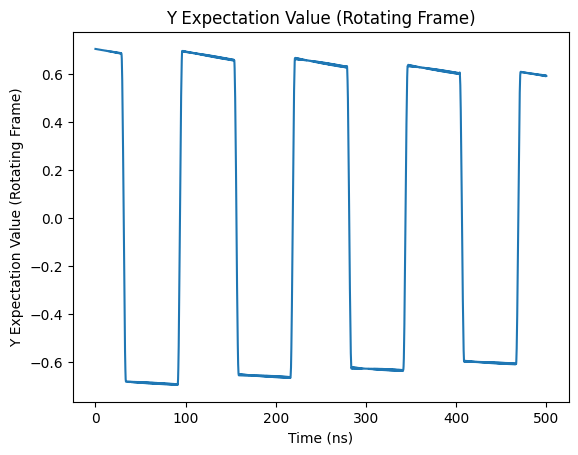

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

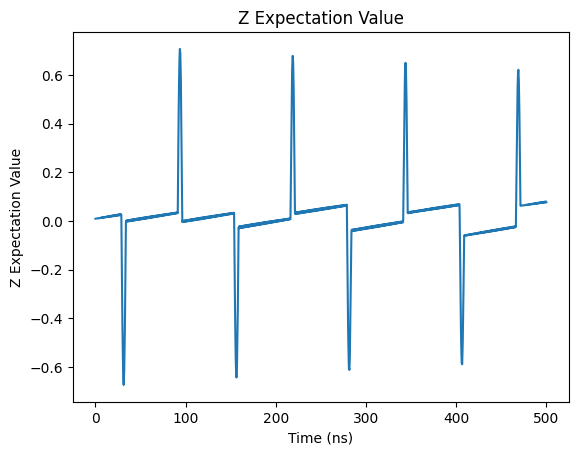

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

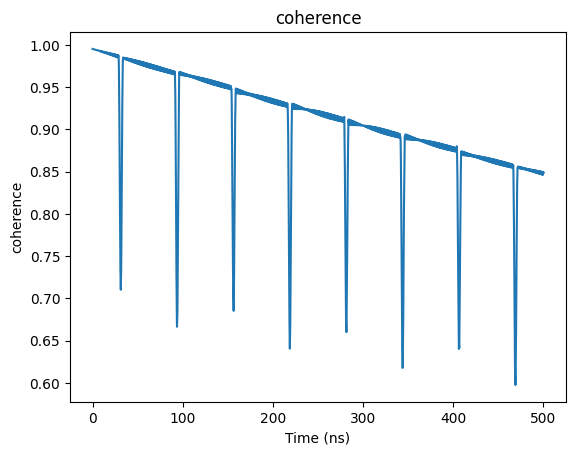

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

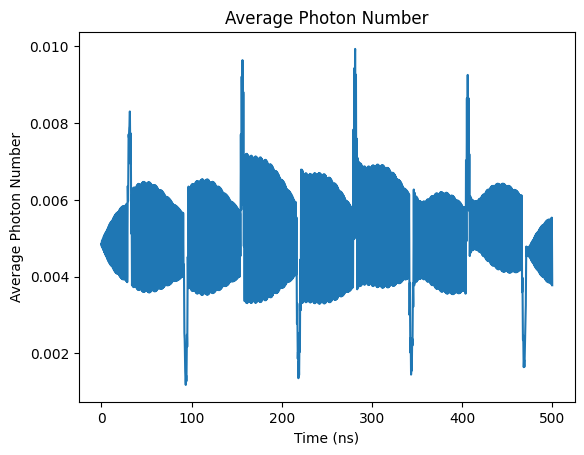

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

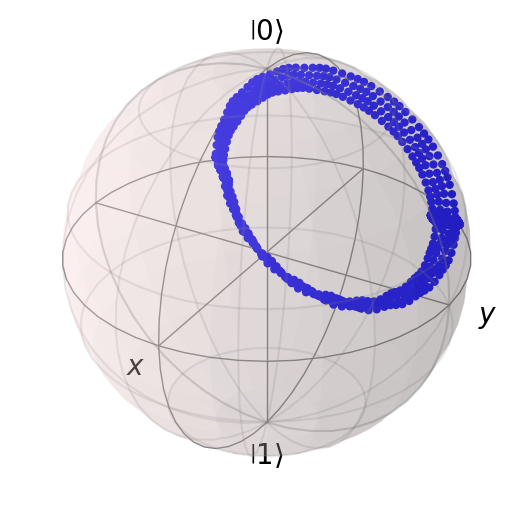

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY8

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY8_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005004616722005974


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

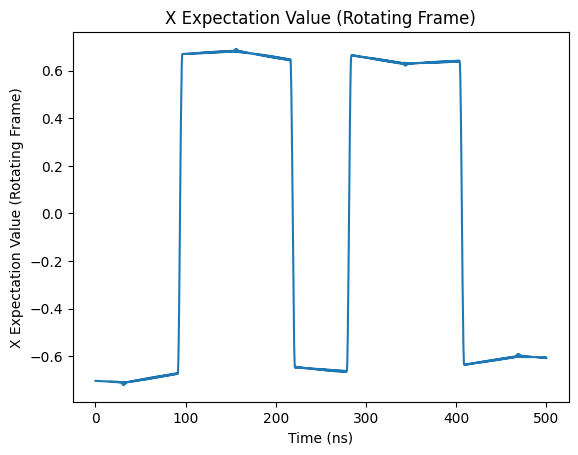

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

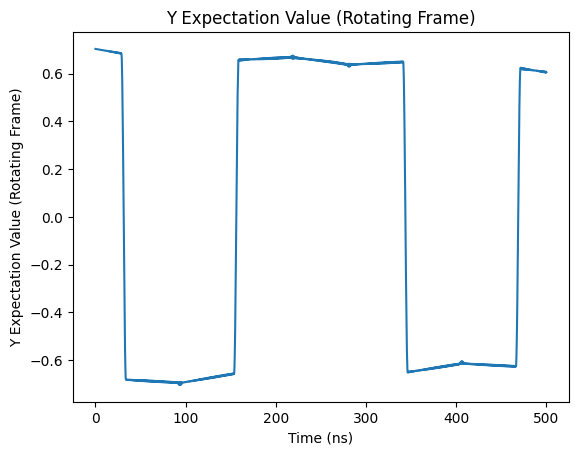

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

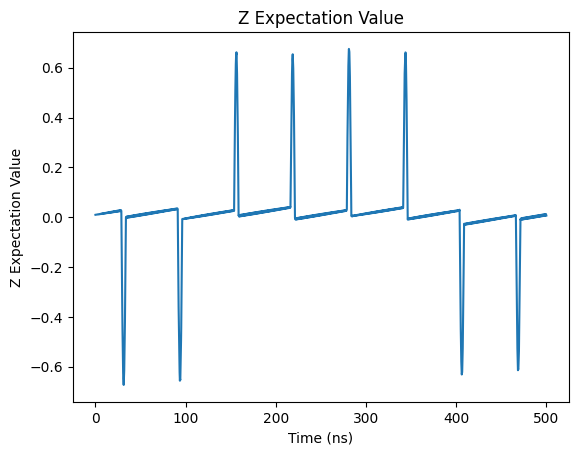

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

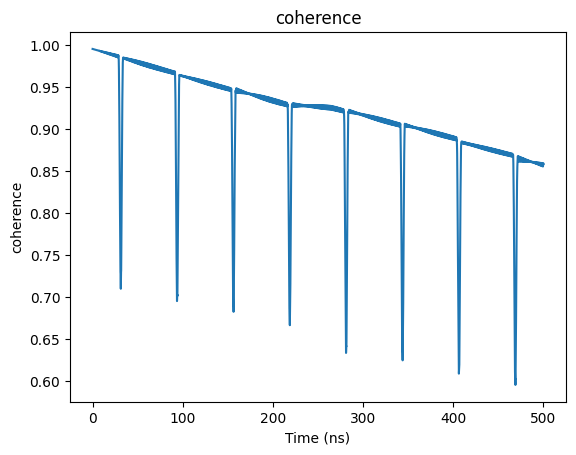

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

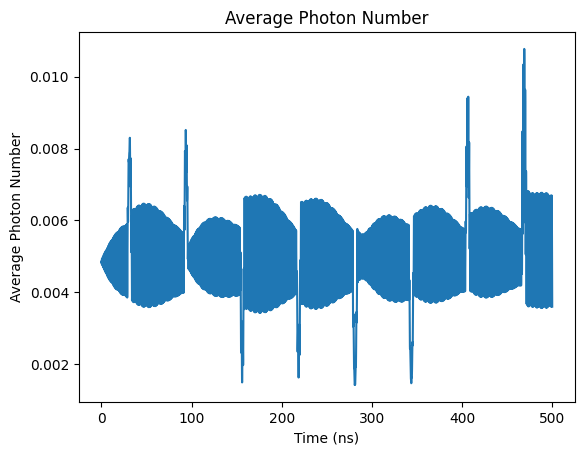

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

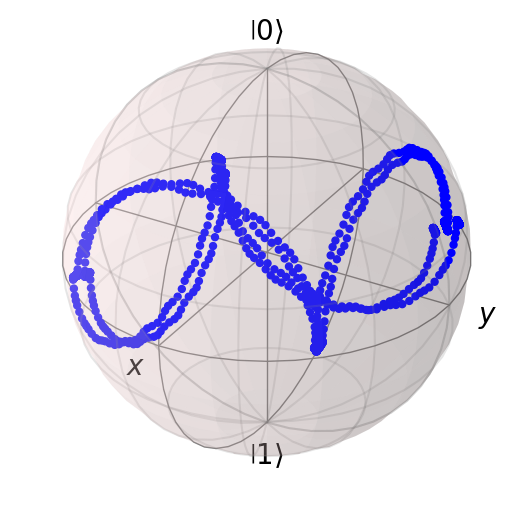

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=16)

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005102689051423765


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

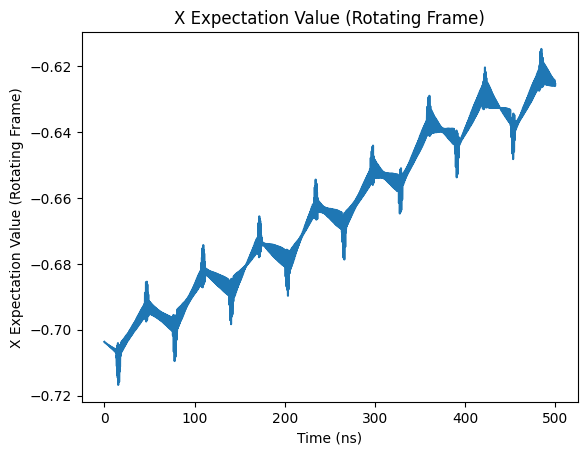

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

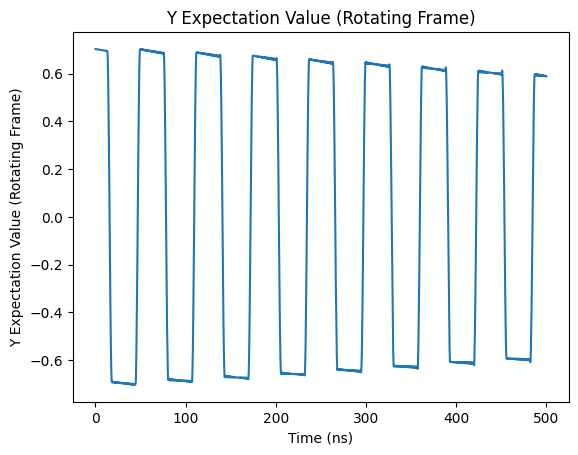

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

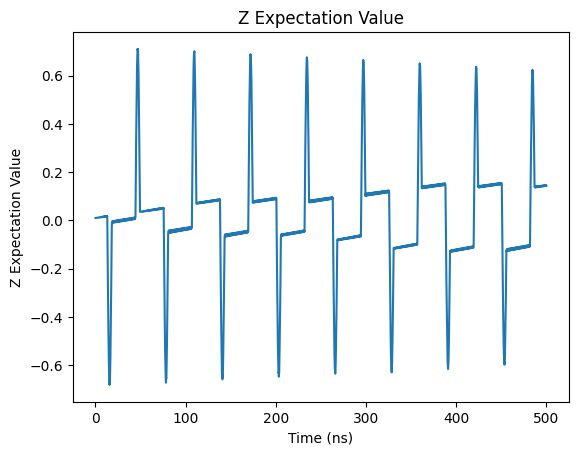

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

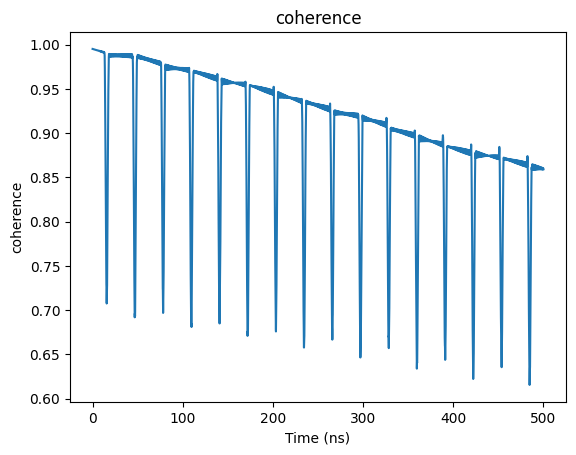

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

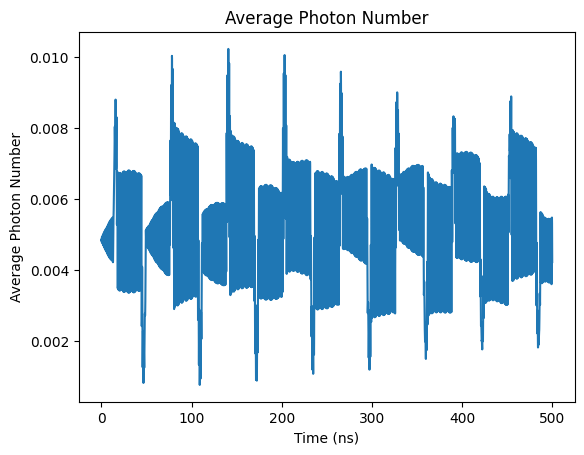

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

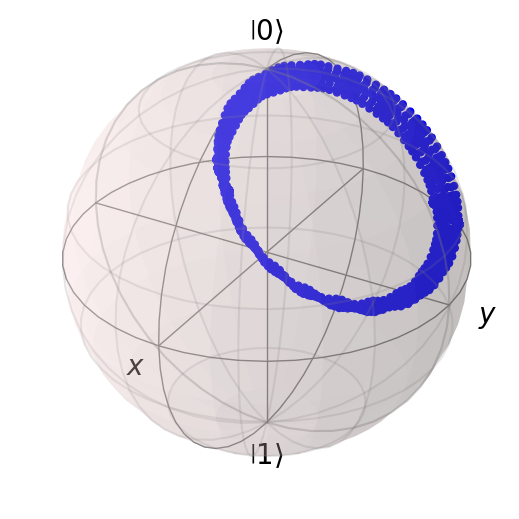

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY16

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY16_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005247724543574356


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

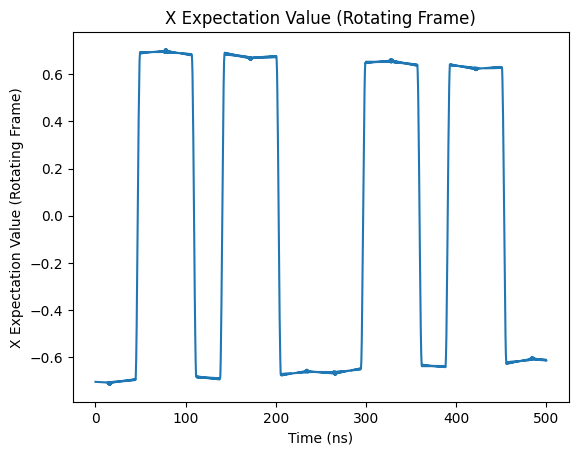

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

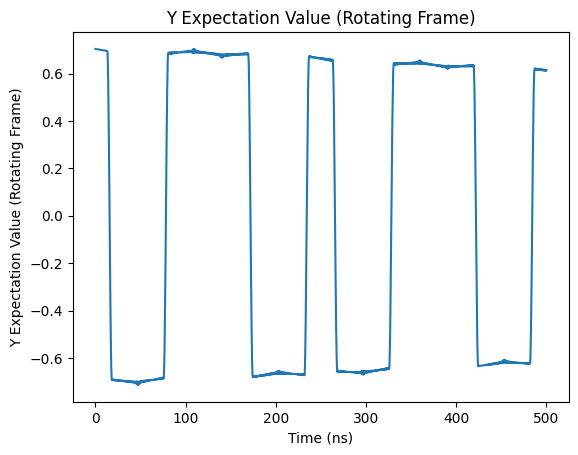

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

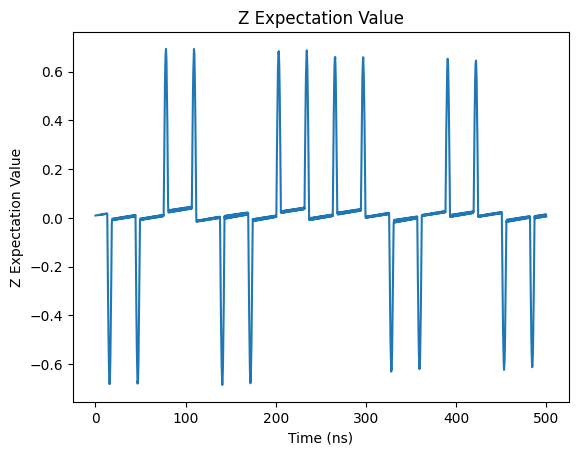

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

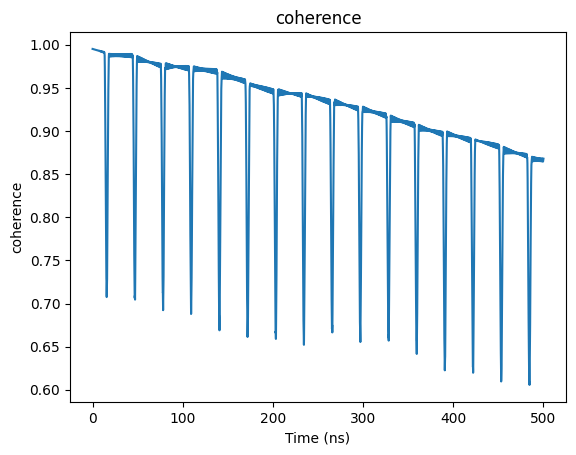

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

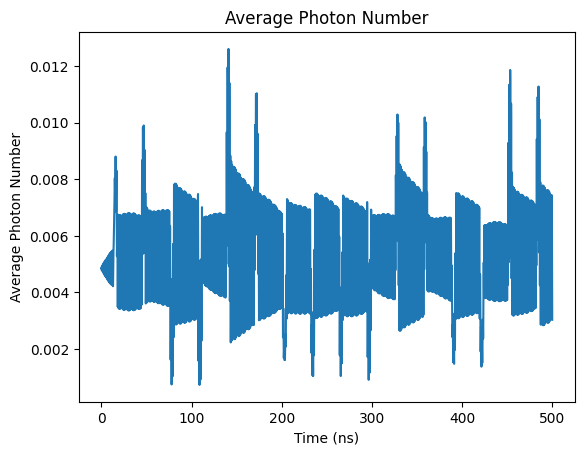

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

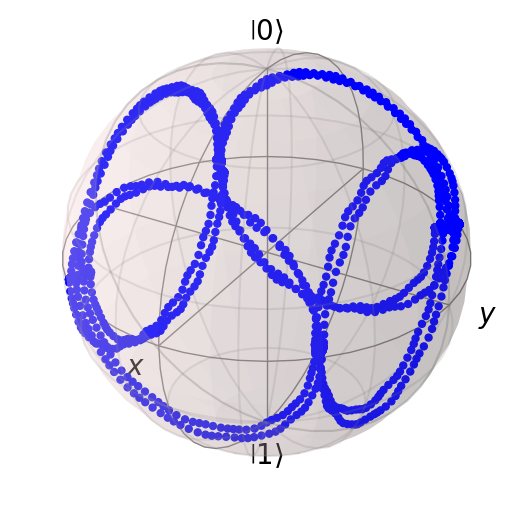

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## Print Coherence & Z

In [ ]:
x_list

[-0.7558270910484205,
 -0.6070722755225094,
 -0.6093173033956415,
 -0.601016651142986,
 -0.6073734629686037,
 -0.6061056766462541,
 -0.6250886622997631,
 -0.6116073264918084]

In [ ]:
y_list

[0.38755947246248423,
 0.5997194040781957,
 0.6007238379191449,
 0.6015217325181632,
 0.5915056220548501,
 0.6063639784293076,
 0.5901266523733157,
 0.6135428084096893]

In [ ]:
z_list

[0.26984833347632425,
 0.020409530543500833,
 0.043474468467130024,
 0.008902571647535159,
 0.0786833739836714,
 0.009594332743530599,
 0.14437374119005292,
 0.010185141101588387]

# Dynamical Decoupling Simulation

$ \omega_{qd} = \omega_q^b + \chi $

Evolution time 1000ns

Initial state $ \cos(\frac{1\pi}{4}) |0\rangle + e^{j\frac{6\pi}{4}} \sin(\frac{1\pi}{4}) |1\rangle $

In [ ]:
N = 5

omega_r = 2 * np.pi * 7.0     # resonator frequency in units of GHz
omega_q = 2 * np.pi * 6.0     # qubit frequency in units of GHz

g = 2 * np.pi * 0.1           # qubit-resonator coupling in units of GHz
kappa = 2 * np.pi * 0.01      # resonator linewidth in units of GHz

detune = omega_q-omega_r
chi = g*g/(detune)

omega_rd = omega_r            # qubit frequency in units of GHz
omega_qd = omega_q + chi      # qubit frequency in units of GHz

sx = sigmax()
sy = sigmay()
sz = sigmaz()
sp = basis(2,1)*basis(2,0).dag()
sm = basis(2,0)*basis(2,1).dag()
a = destroy(N)

sx_composite = tensor(sx, qeye(N))
sy_composite = tensor(sy, qeye(N))
sz_composite = tensor(sz, qeye(N))
sp_composite = tensor(sp, qeye(N))
number_composite = tensor(qeye(2), a.dag()*a)

op_list = [sx_composite, sy_composite, sz_composite, sp_composite, number_composite]

tlist = np.linspace(0, 500, 5000)
T_end_q = 500

cos = np.sqrt(0.5 + 0.5*5/np.sqrt(26))
sin = np.sqrt(0.5 - 0.5*5/np.sqrt(26))


psi_20 = tensor(basis(2,0), basis(N,0))
psi_21 = cos*tensor(basis(2,1), basis(N,0)) - sin*tensor(basis(2,0), basis(N,1))
psi_2s = np.cos(1*np.pi/4) * psi_20 + np.exp(1j*np.pi*6/4) * np.sin(1*np.pi/4) * psi_21


H0 = -0.5*omega_q*sz_composite + omega_r*number_composite + g*(tensor(sm, a.dag()) + tensor(sp, a))
H1 = tensor(qeye(2), a + a.dag())
H2 = sx_composite

A = 0.0002 * 2 * np.pi
B = 0.1 * 2 * np.pi

x_list = []
y_list = []
z_list = []

## Ramsey

In [ ]:
# Simulation

N_seq = 0

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))
print([x_rot[0], y_rot[0], result.expect[2][0]])

0.004267700615108879
[-1.8280302648433644e-16, 0.9951333266680702, 0.009709662154540055]


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

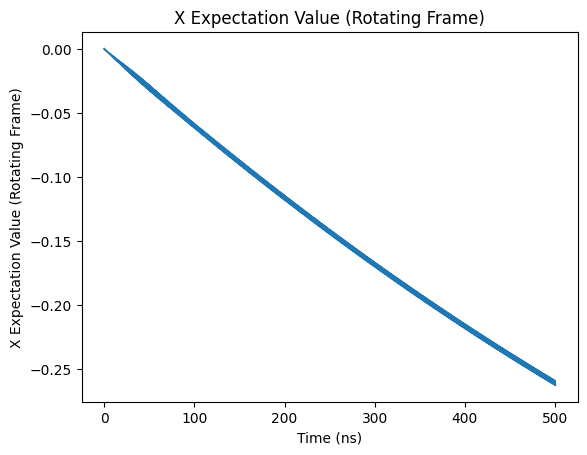

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

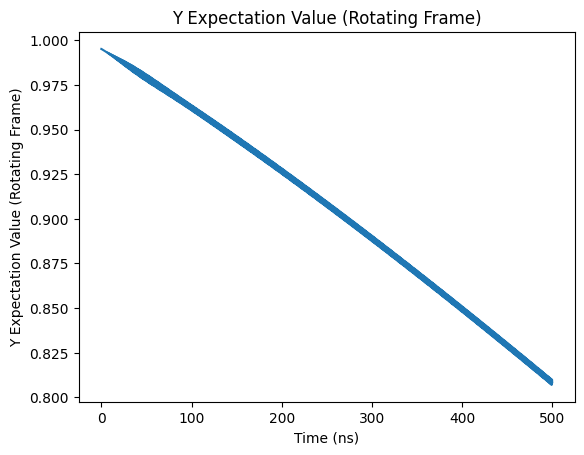

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

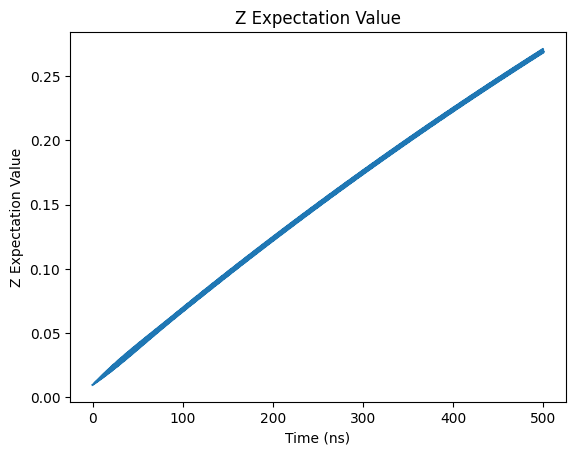

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

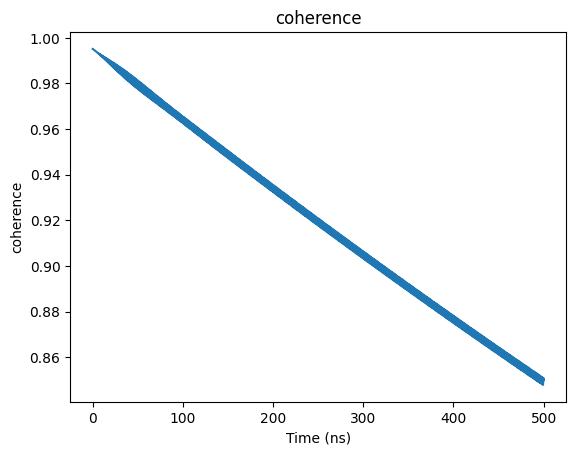

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

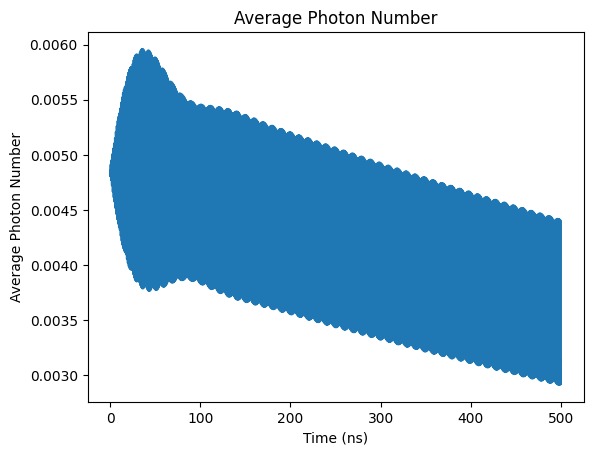

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

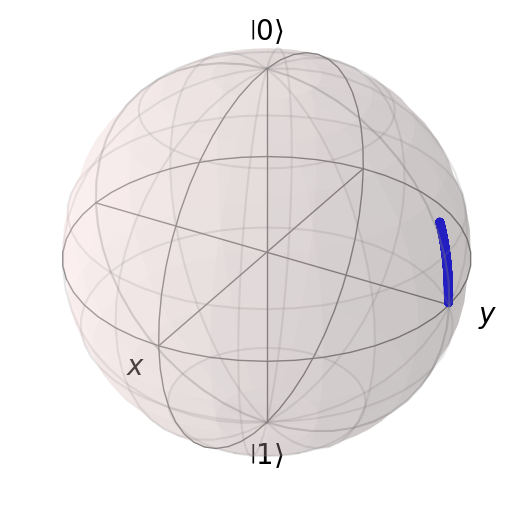

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=2)

In [ ]:
# Simulation

N_seq = 2

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004955451214083908


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

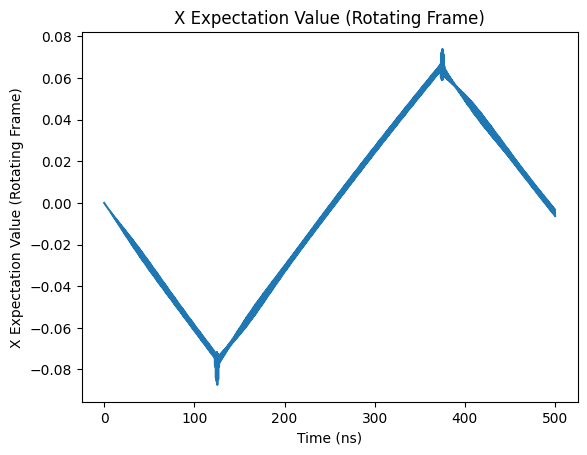

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

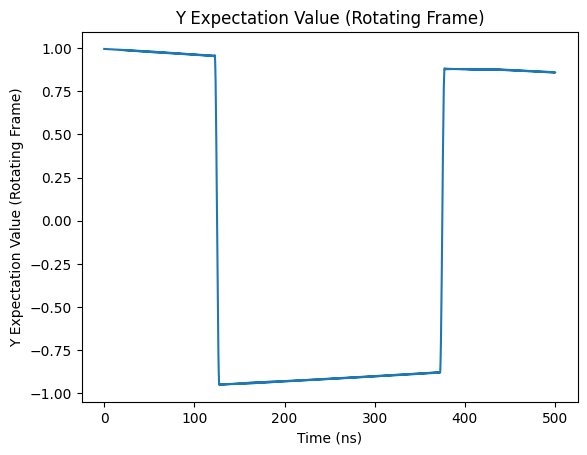

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

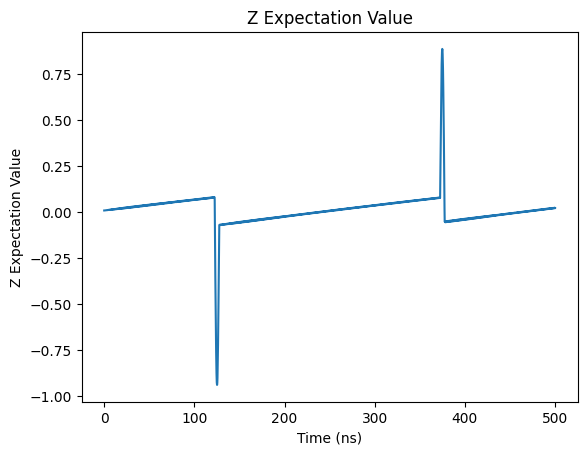

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

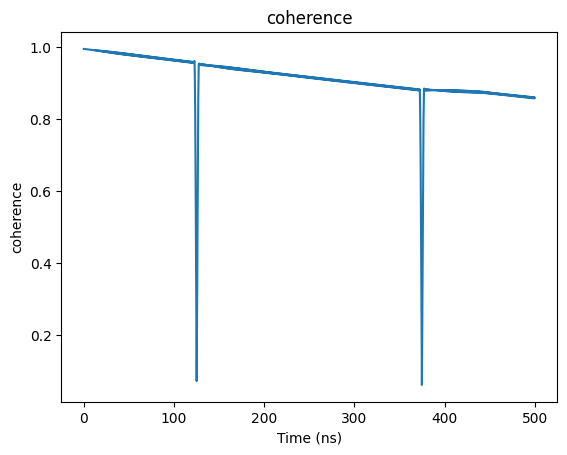

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

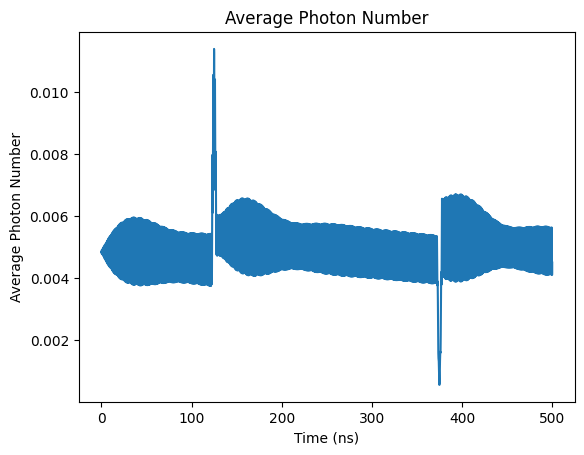

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

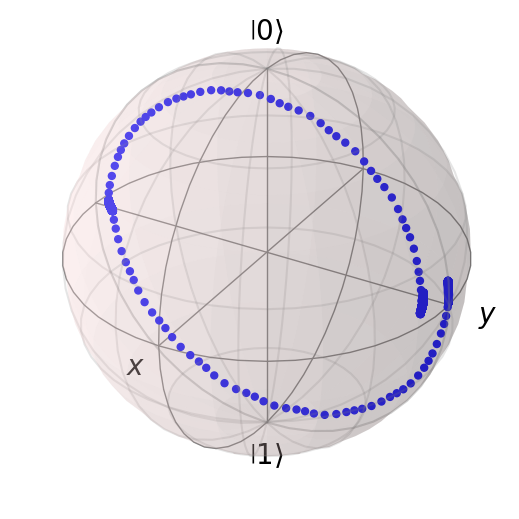

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=4)

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.004989099041787028


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

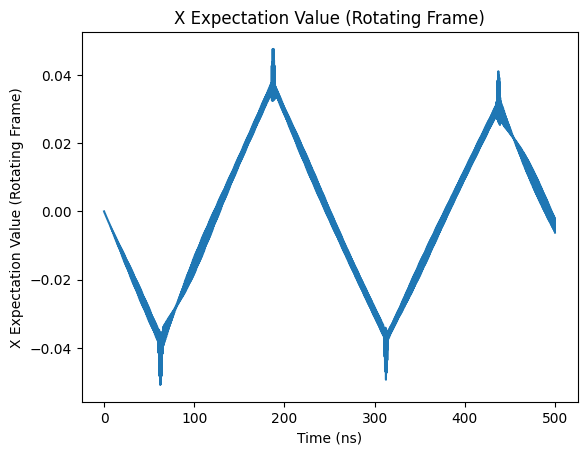

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

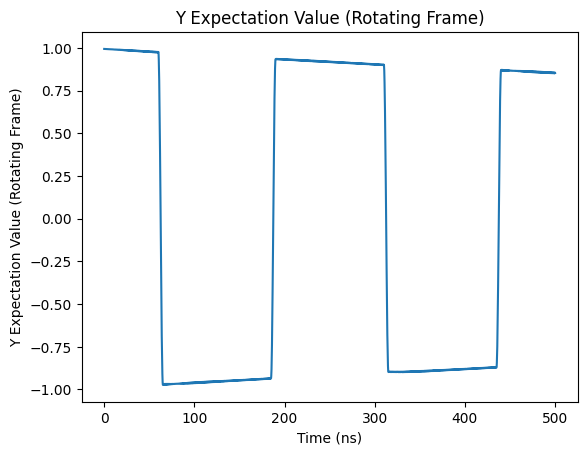

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

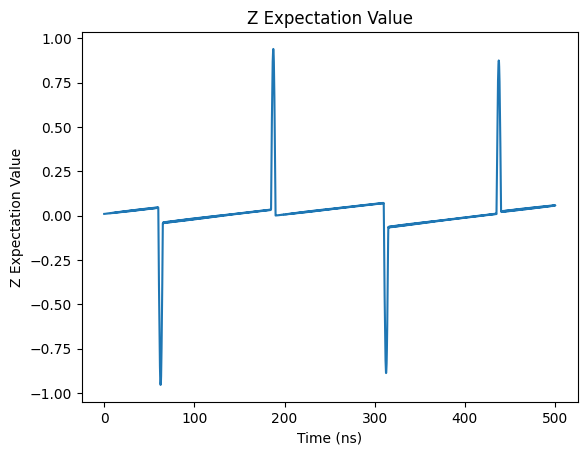

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

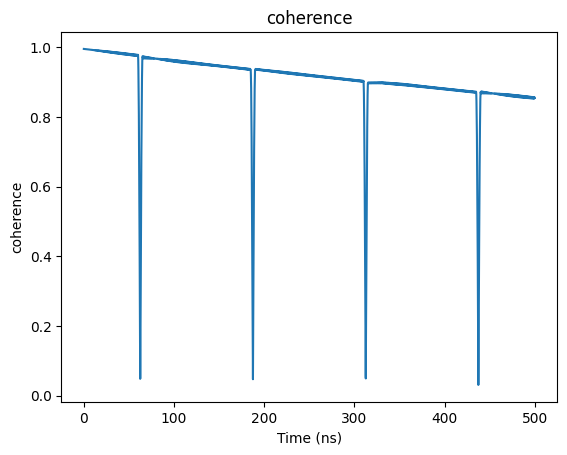

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

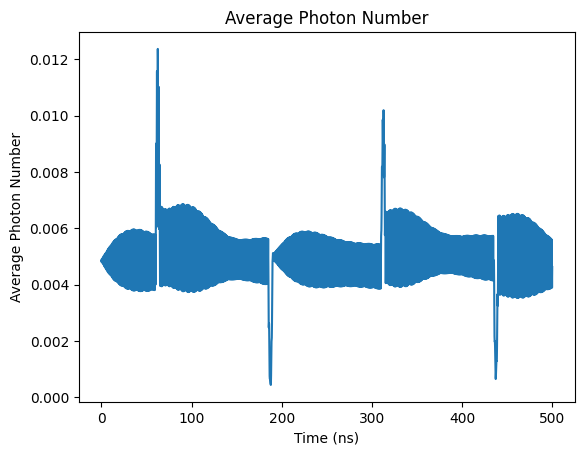

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

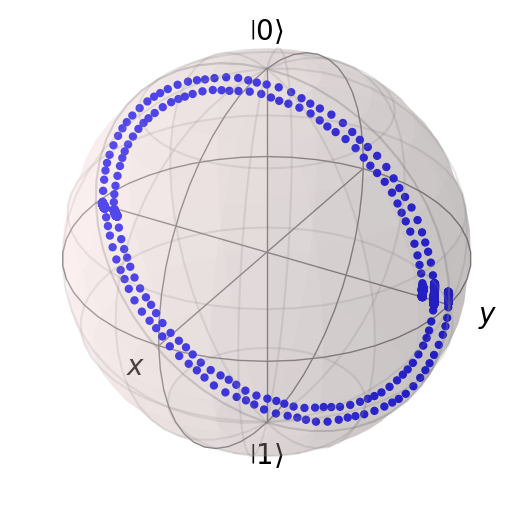

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY4

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY4_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005071604131605987


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

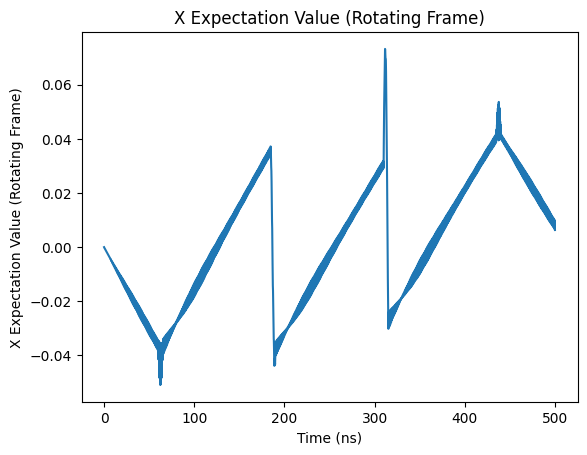

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

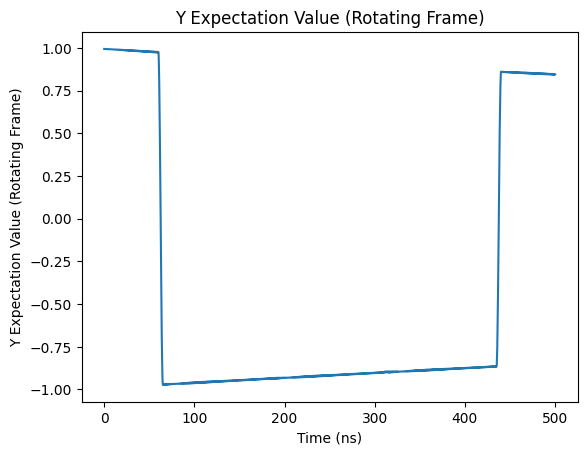

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

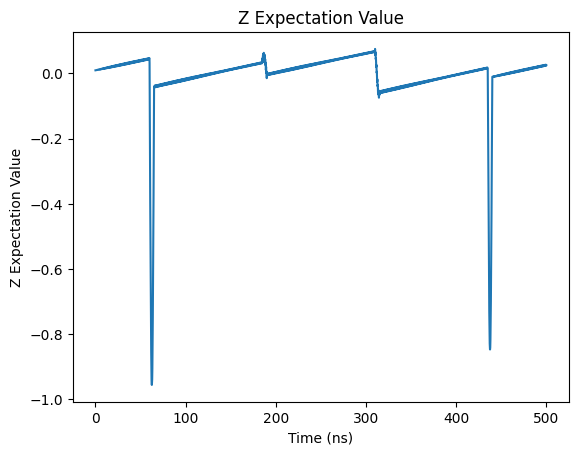

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

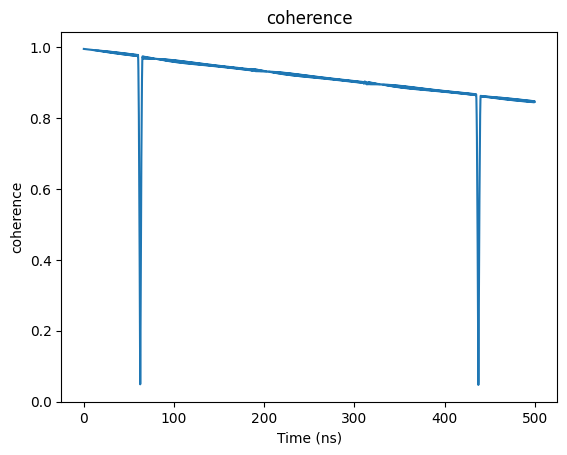

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

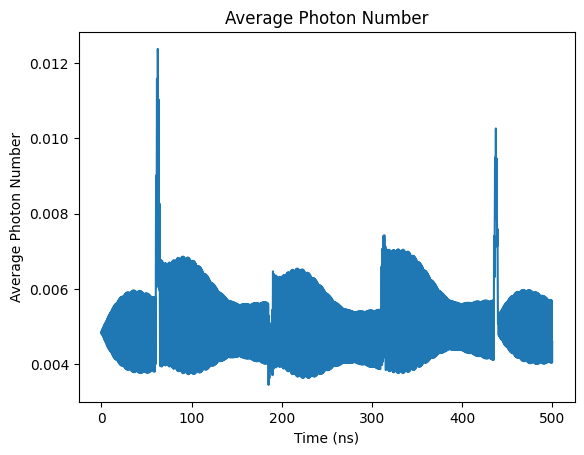

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

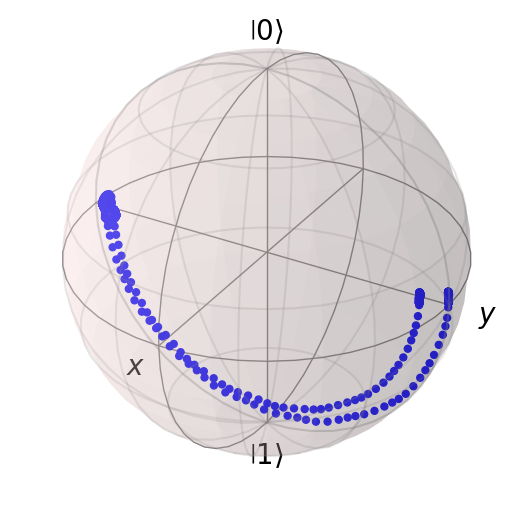

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=8)

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005053096073231146


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

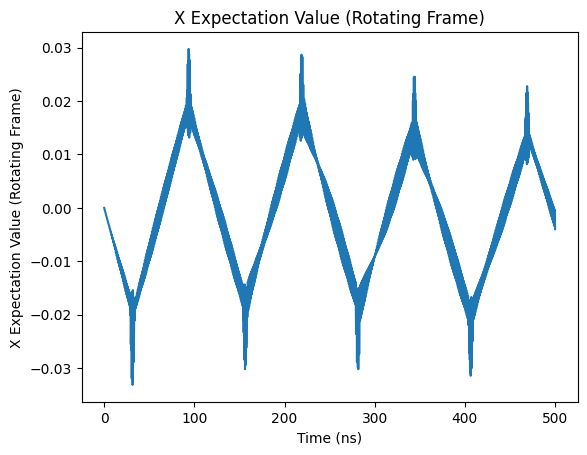

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

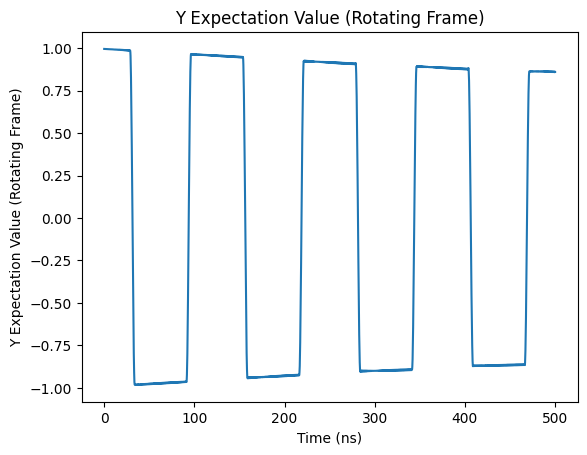

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

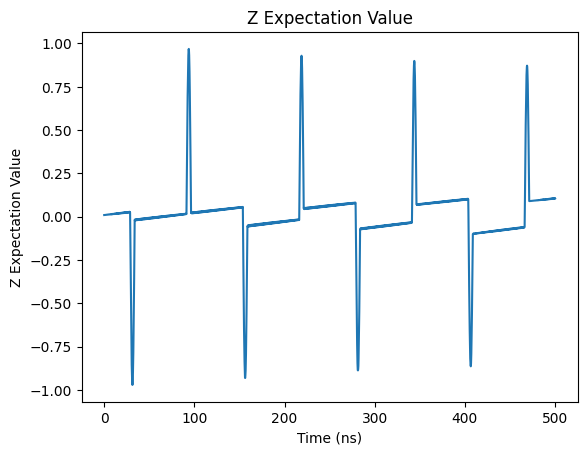

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

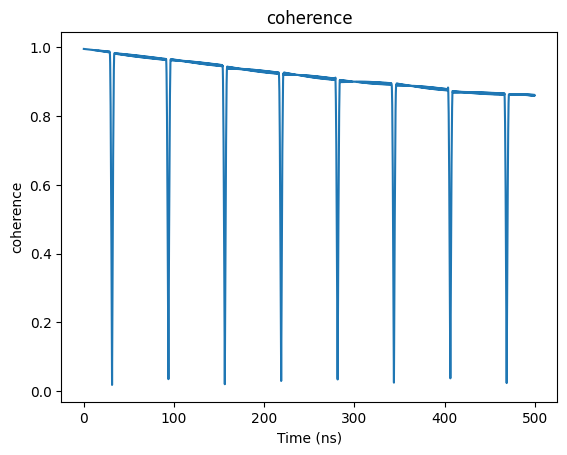

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

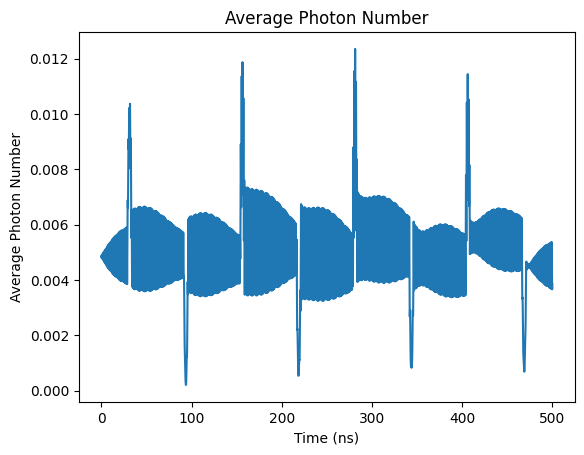

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

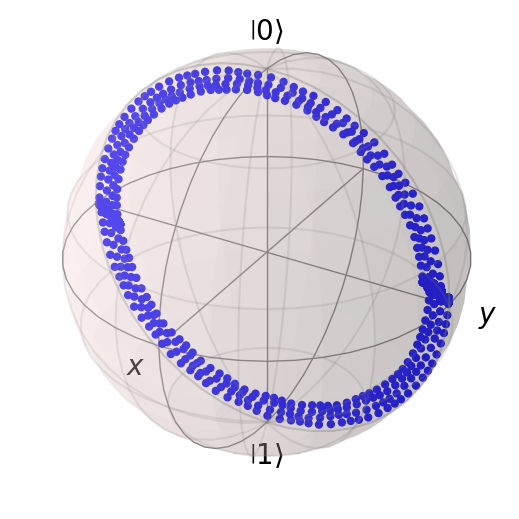

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY8

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY8_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005005258840832087


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

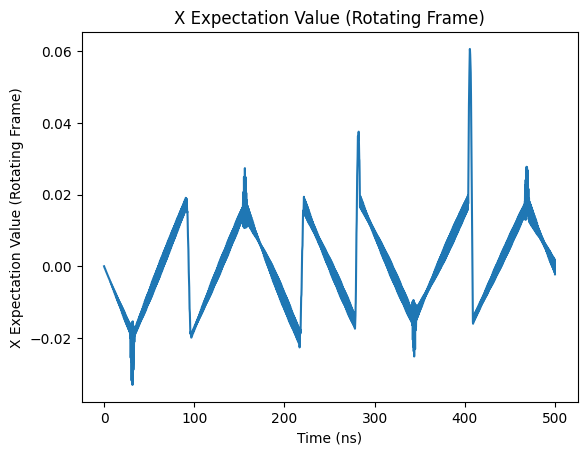

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

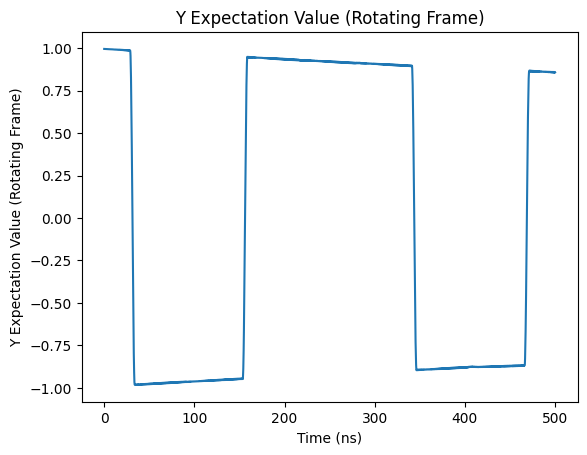

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

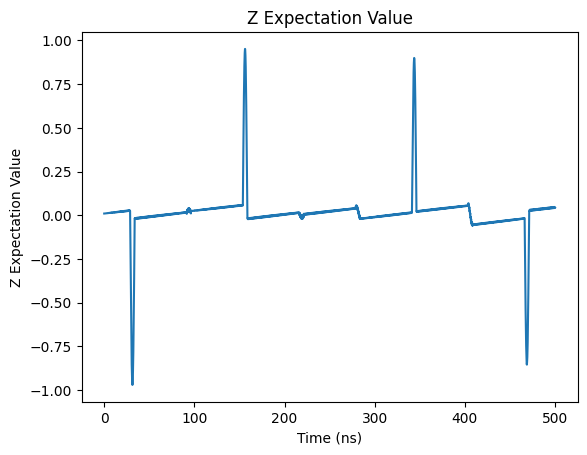

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

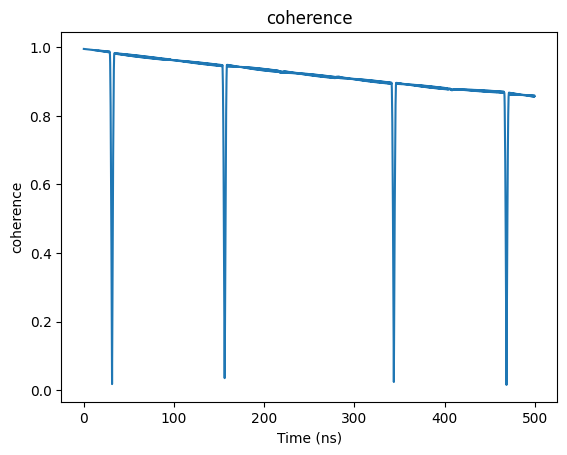

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

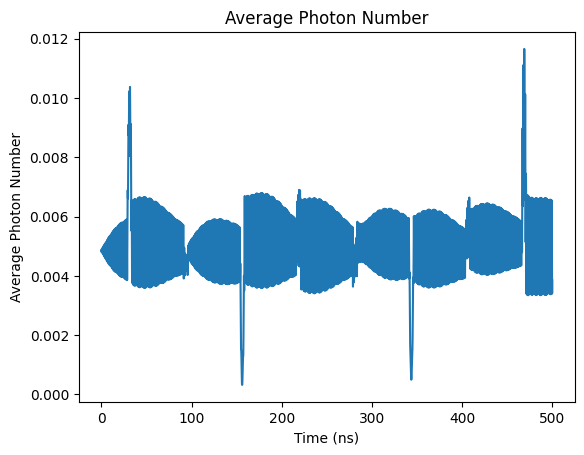

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

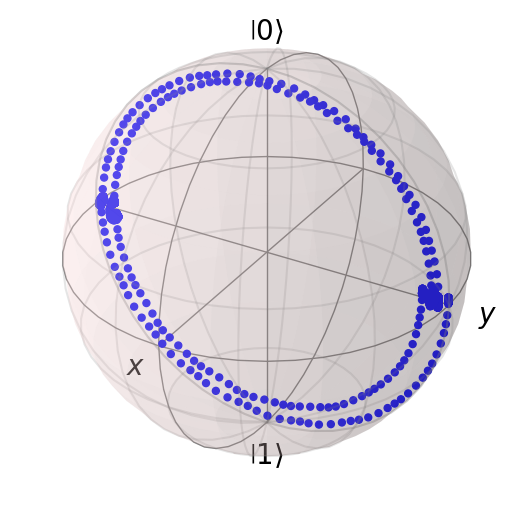

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=16)

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.0051817234026632665


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

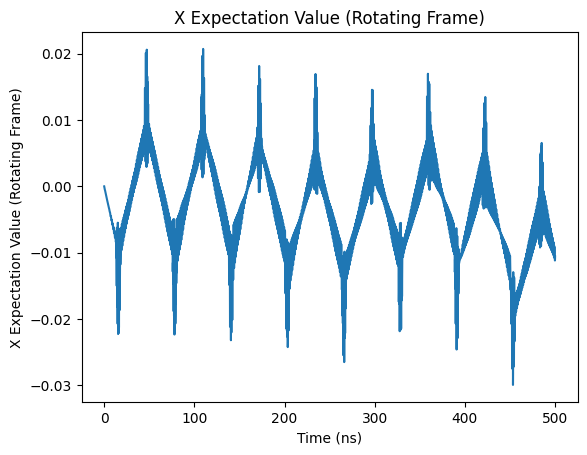

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

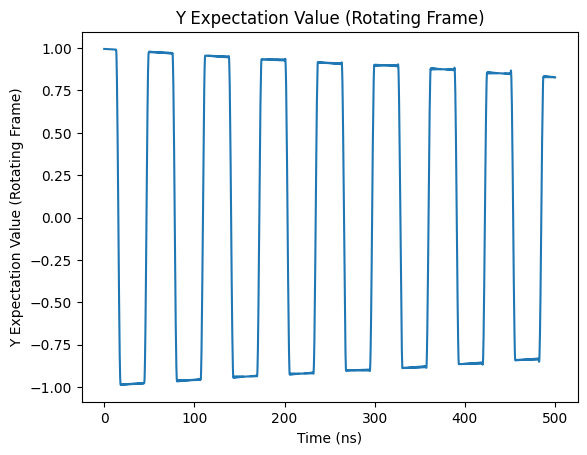

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

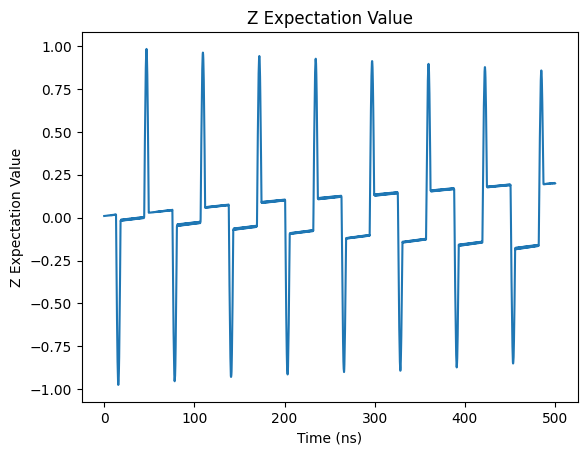

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

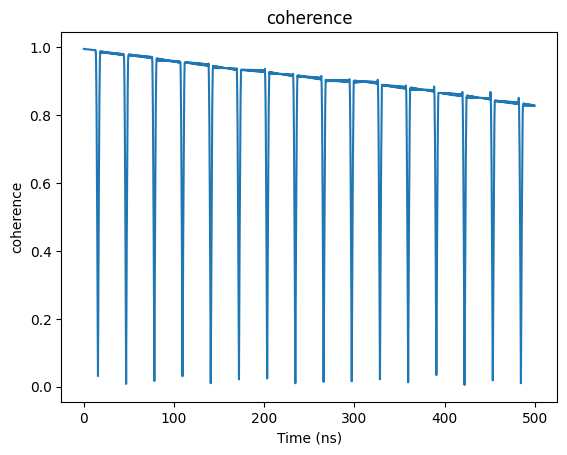

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

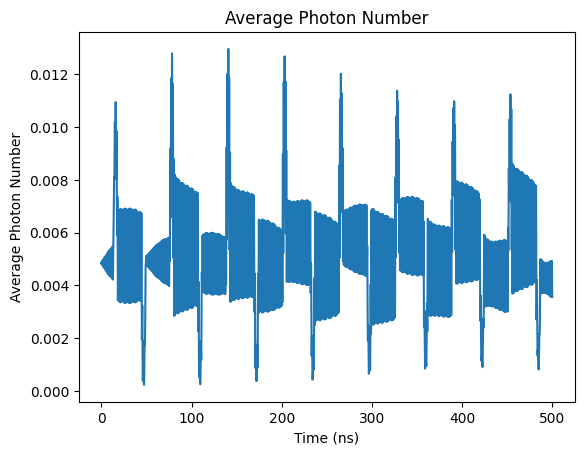

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

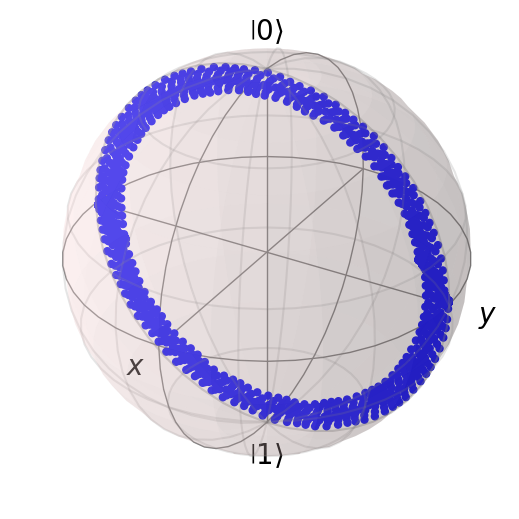

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY16

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY16_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005246918218270515


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

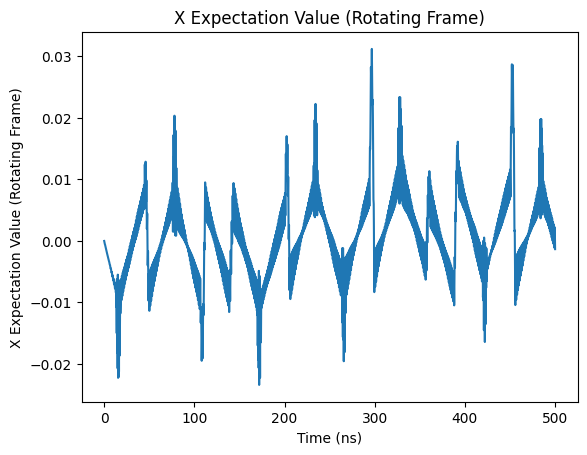

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

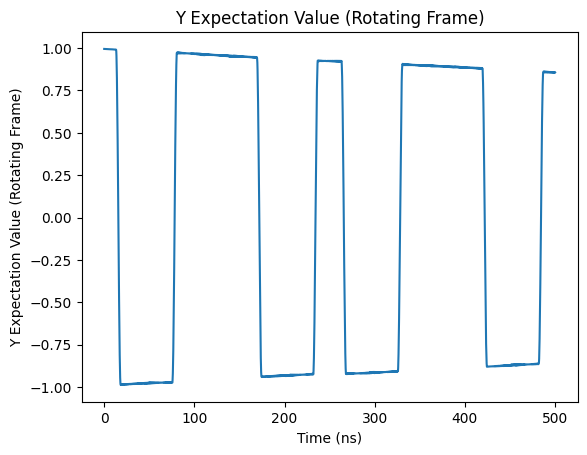

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

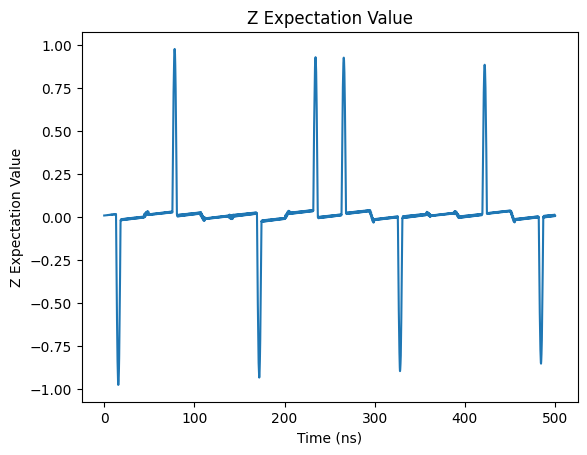

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

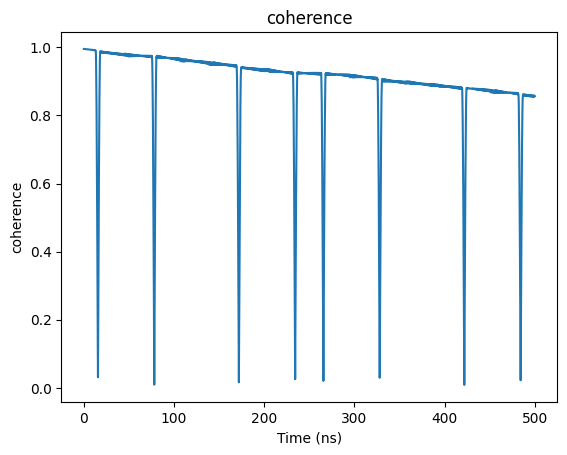

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

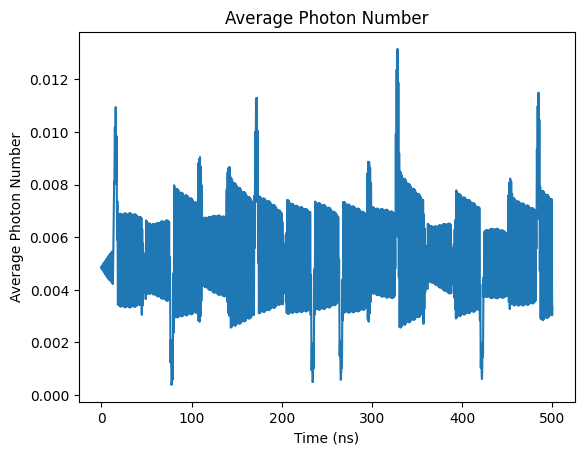

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

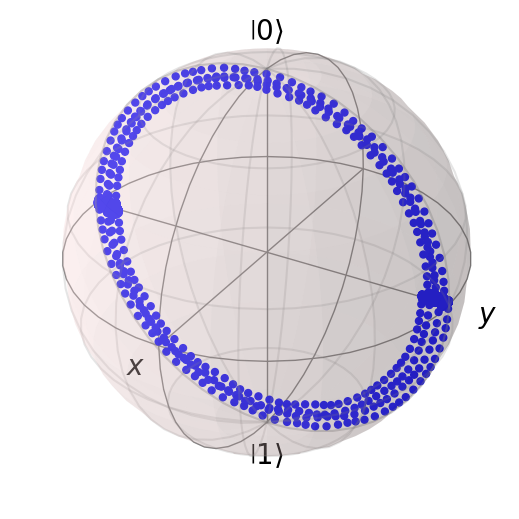

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## Print Coherence & Z

In [ ]:
x_list

[-0.26040795340105294,
 -0.004510851869356602,
 -0.0039044121646934866,
 0.008284687831935745,
 -0.0020261229217742216,
 -3.1415920979431523e-06,
 -0.010106324232312626,
 0.0003928254739470862]

In [ ]:
y_list

[0.8084911773869858,
 0.8590733798514938,
 0.8544728911275421,
 0.8460129969356283,
 0.8600505781894972,
 0.8574643837217973,
 0.8284144186466881,
 0.8562844330030227]

In [ ]:
z_list

[0.26984661749068595,
 0.0232238477677084,
 0.05724807259501395,
 0.025508924005131262,
 0.10552530729004192,
 0.04444107750113642,
 0.20115716195151312,
 0.01022298828149413]

# Dynamical Decoupling Simulation

$ \omega_{qd} = \omega_q^b + \chi $

Evolution time 1000ns

Initial state $ \cos(\frac{1\pi}{4}) |0\rangle + e^{j\frac{7\pi}{4}} \sin(\frac{1\pi}{4}) |1\rangle $

In [ ]:
N = 5

omega_r = 2 * np.pi * 7.0     # resonator frequency in units of GHz
omega_q = 2 * np.pi * 6.0     # qubit frequency in units of GHz

g = 2 * np.pi * 0.1           # qubit-resonator coupling in units of GHz
kappa = 2 * np.pi * 0.01      # resonator linewidth in units of GHz

detune = omega_q-omega_r
chi = g*g/(detune)

omega_rd = omega_r            # qubit frequency in units of GHz
omega_qd = omega_q + chi      # qubit frequency in units of GHz

sx = sigmax()
sy = sigmay()
sz = sigmaz()
sp = basis(2,1)*basis(2,0).dag()
sm = basis(2,0)*basis(2,1).dag()
a = destroy(N)

sx_composite = tensor(sx, qeye(N))
sy_composite = tensor(sy, qeye(N))
sz_composite = tensor(sz, qeye(N))
sp_composite = tensor(sp, qeye(N))
number_composite = tensor(qeye(2), a.dag()*a)

op_list = [sx_composite, sy_composite, sz_composite, sp_composite, number_composite]

tlist = np.linspace(0, 500, 5000)
T_end_q = 500

cos = np.sqrt(0.5 + 0.5*5/np.sqrt(26))
sin = np.sqrt(0.5 - 0.5*5/np.sqrt(26))


psi_20 = tensor(basis(2,0), basis(N,0))
psi_21 = cos*tensor(basis(2,1), basis(N,0)) - sin*tensor(basis(2,0), basis(N,1))
psi_2s = np.cos(1*np.pi/4) * psi_20 + np.exp(1j*np.pi*7/4) * np.sin(1*np.pi/4) * psi_21


H0 = -0.5*omega_q*sz_composite + omega_r*number_composite + g*(tensor(sm, a.dag()) + tensor(sp, a))
H1 = tensor(qeye(2), a + a.dag())
H2 = sx_composite

A = 0.0002 * 2 * np.pi
B = 0.1 * 2 * np.pi

x_list = []
y_list = []
z_list = []

## Ramsey

In [ ]:
# Simulation

N_seq = 0

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))
print([x_rot[0], y_rot[0], result.expect[2][0]])

0.004267662120861873
[0.7036655234717201, 0.7036655234717204, 0.009709662154540055]


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

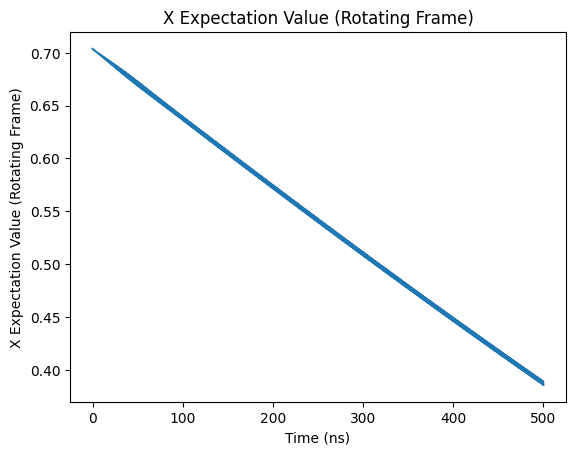

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

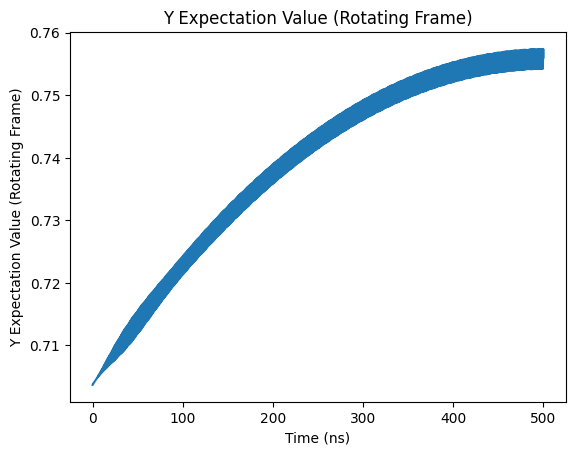

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

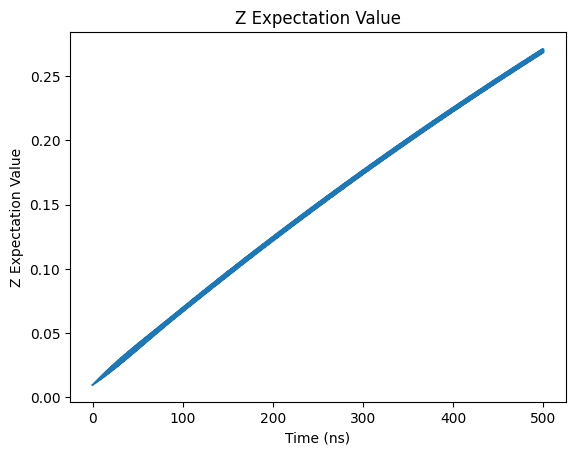

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

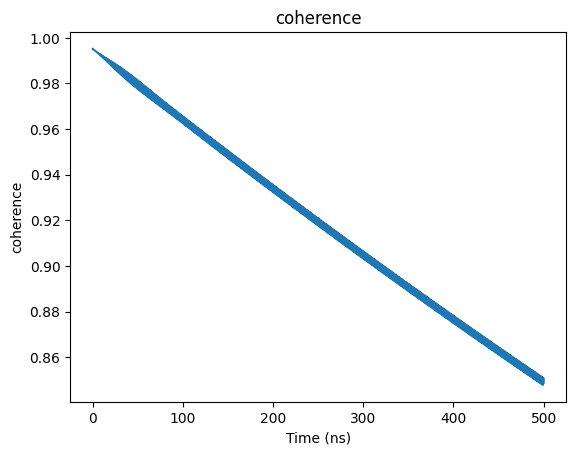

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

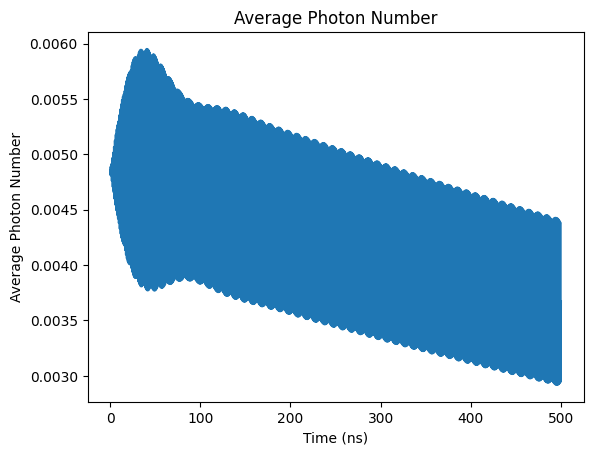

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

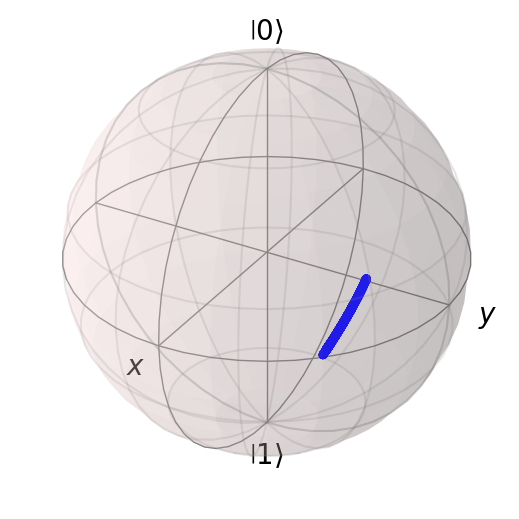

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=2)

In [ ]:
# Simulation

N_seq = 2

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005006470745235959


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

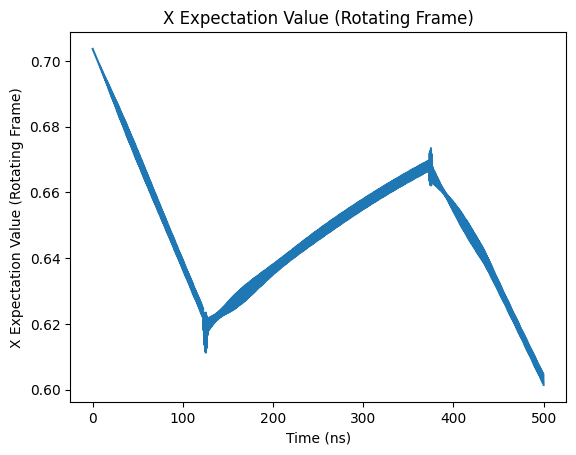

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

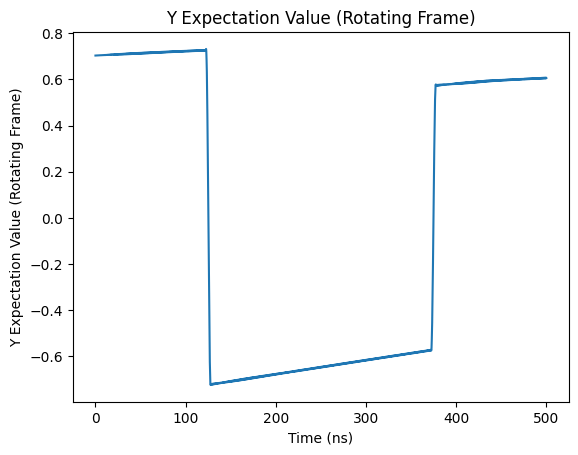

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

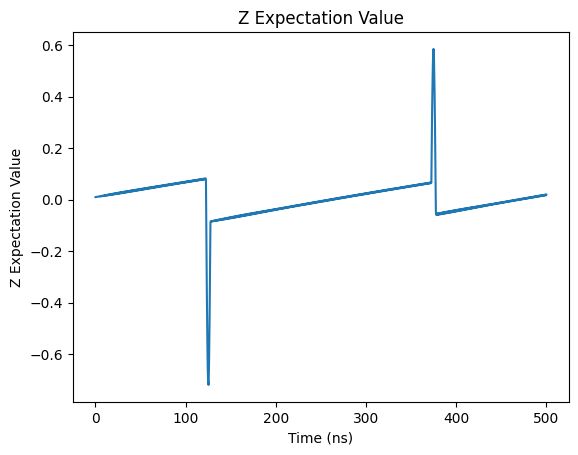

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

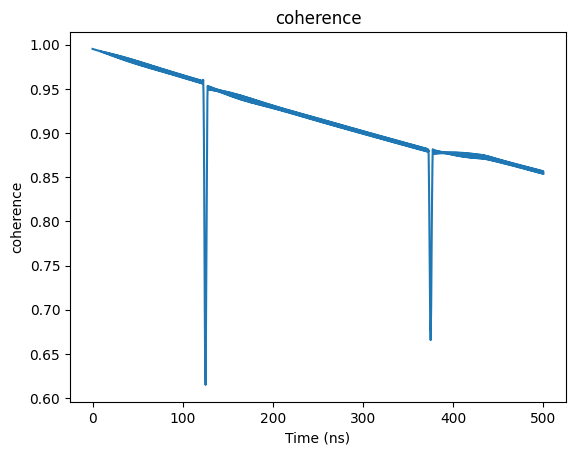

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

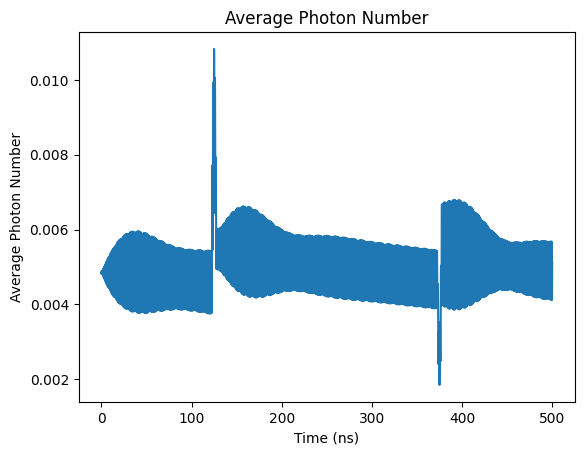

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

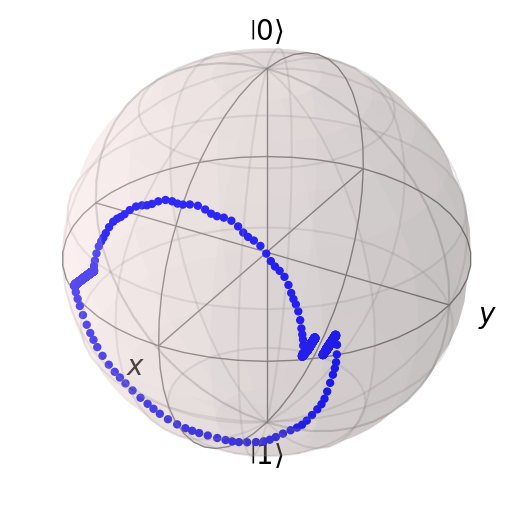

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=4)

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005022658868170556


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

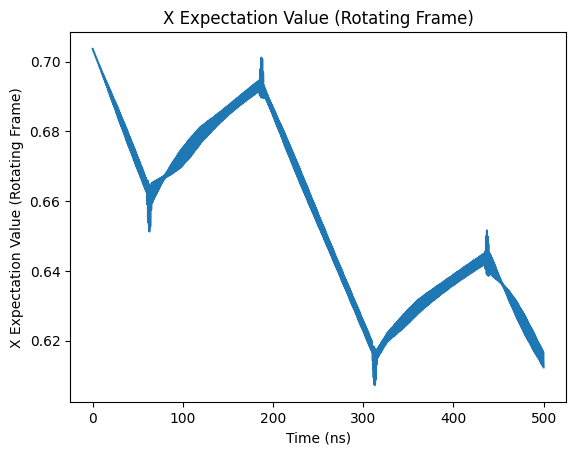

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

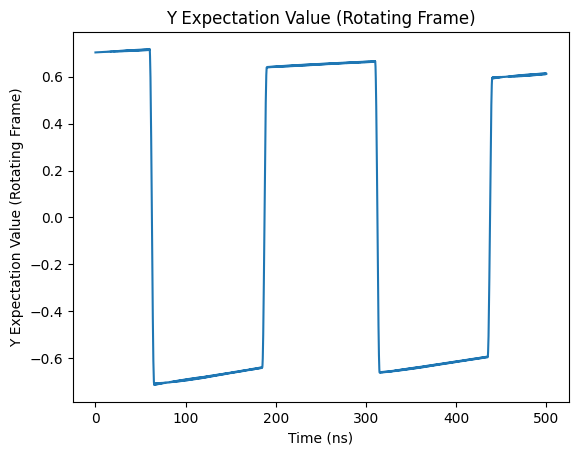

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

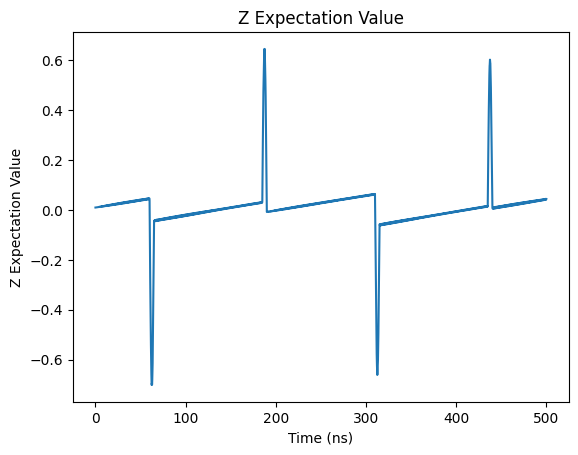

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

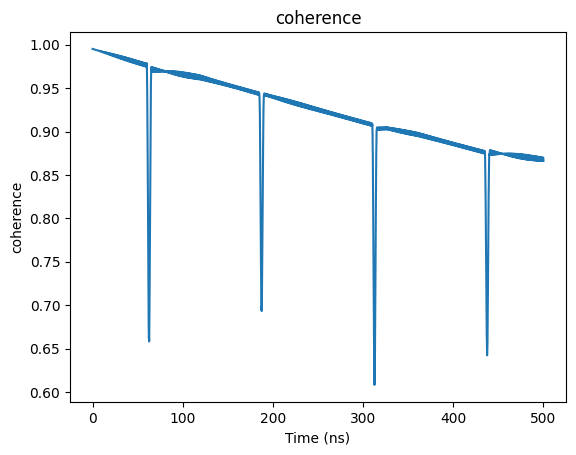

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

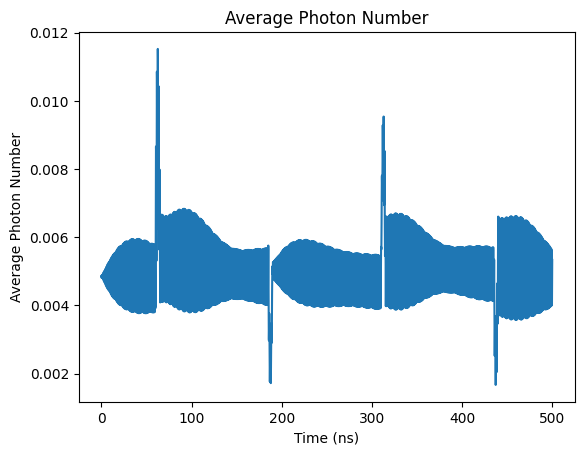

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

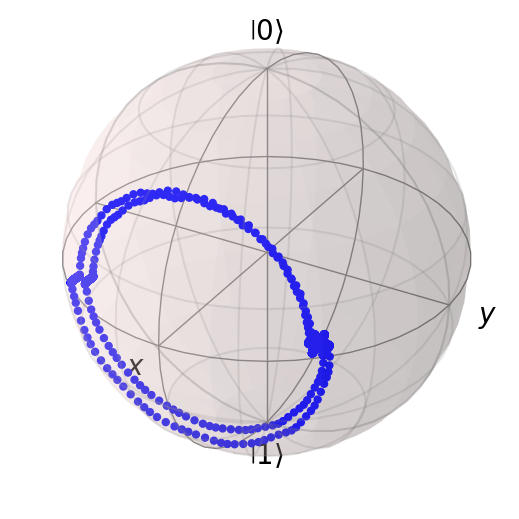

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY4

In [ ]:
# Simulation

N_seq = 4

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY4_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005001155654552575


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

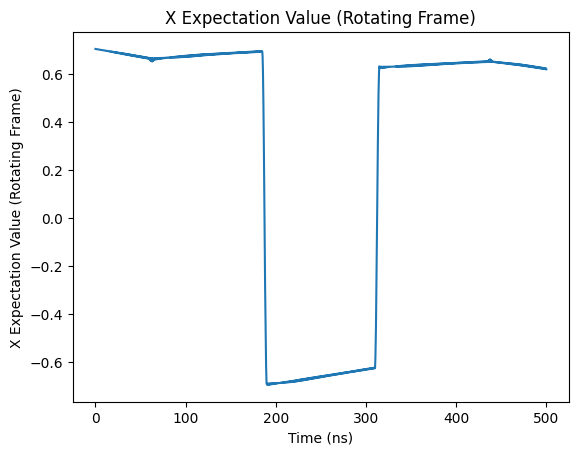

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

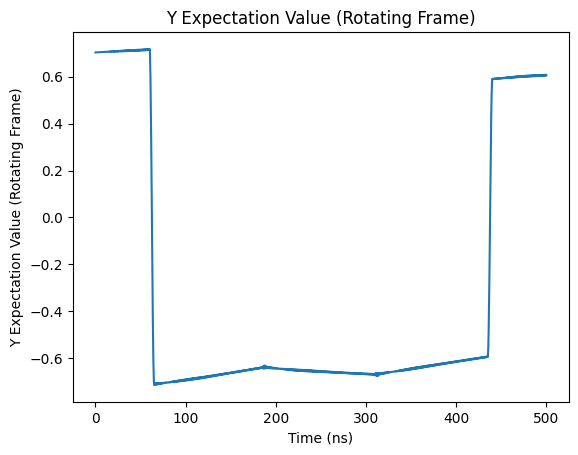

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

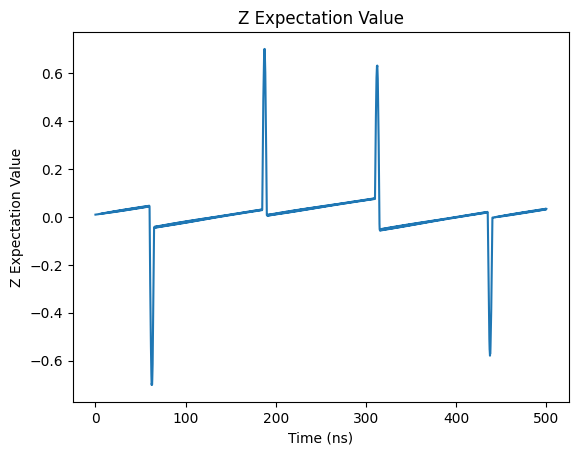

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

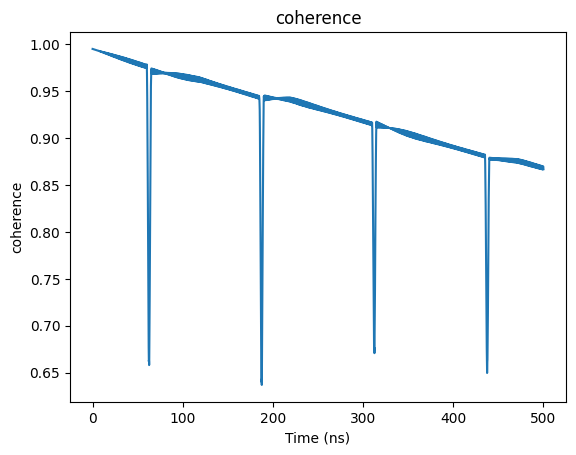

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

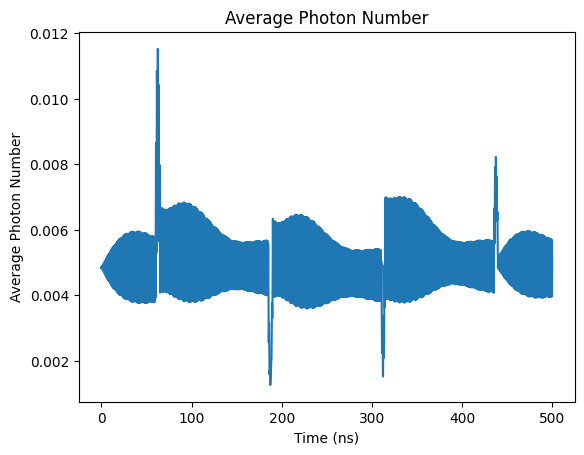

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

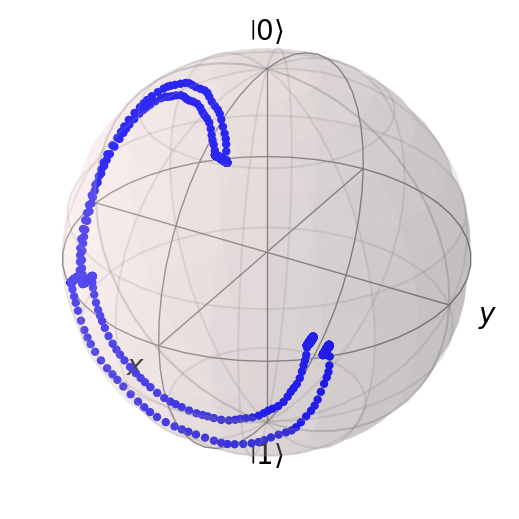

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=8)

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005101876038852012


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

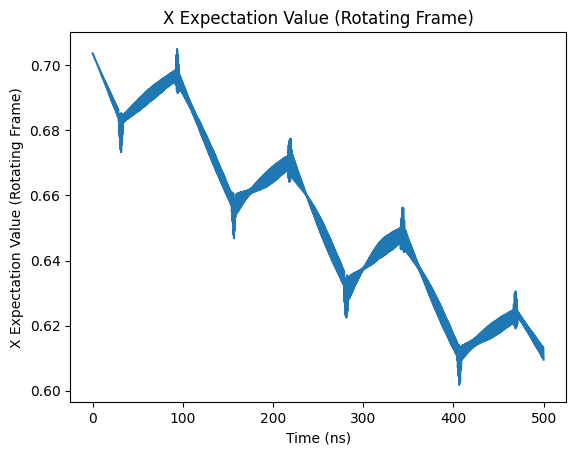

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

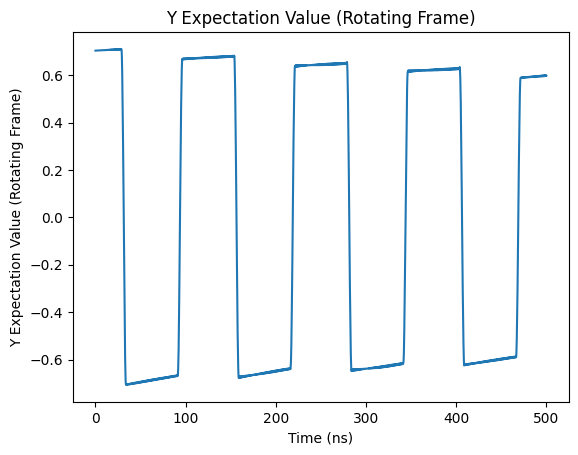

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

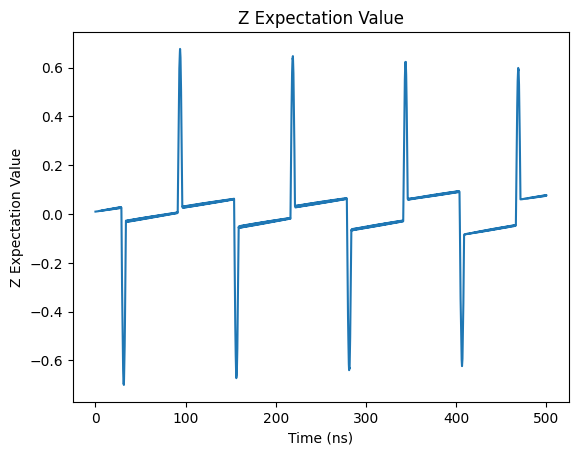

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

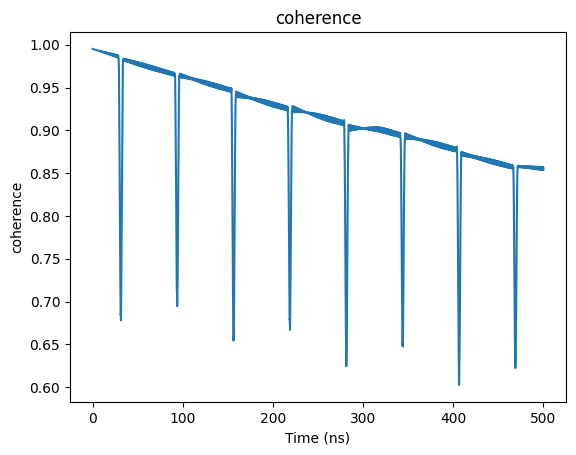

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

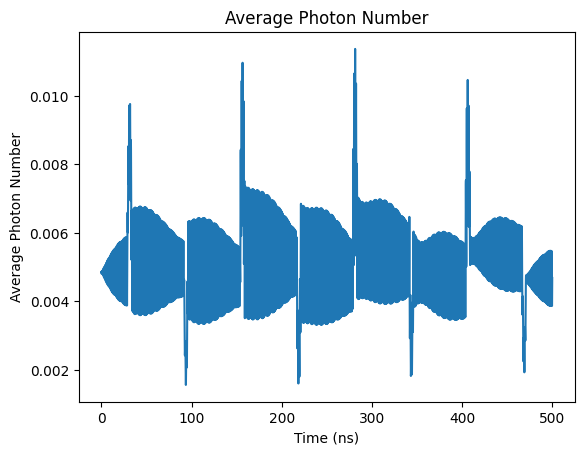

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

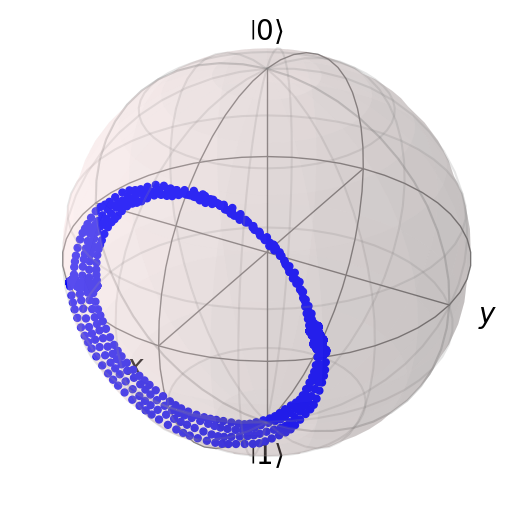

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY8

In [ ]:
# Simulation

N_seq = 8

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY8_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005007536107996441


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

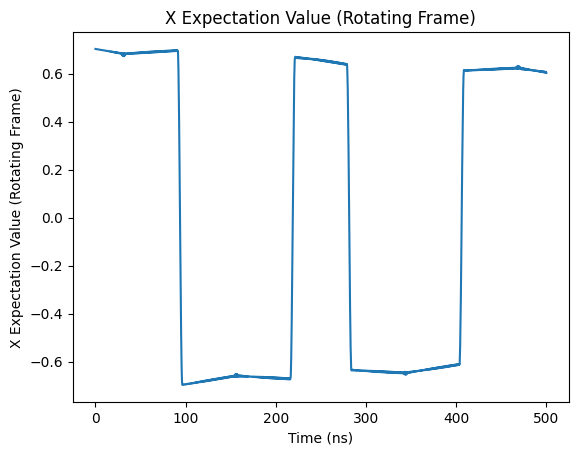

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

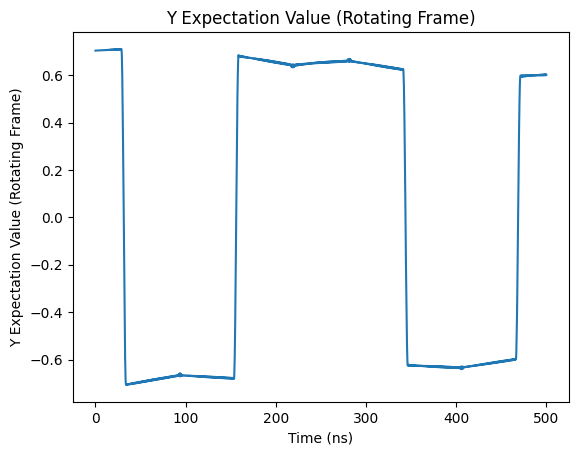

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

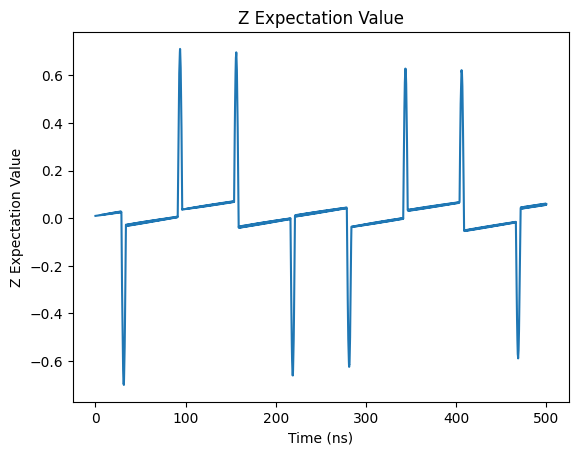

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

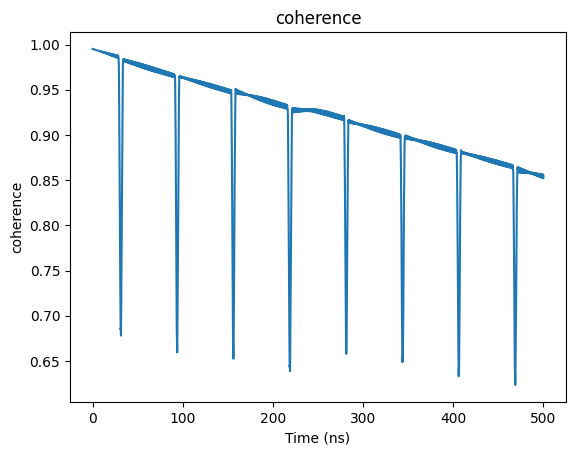

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

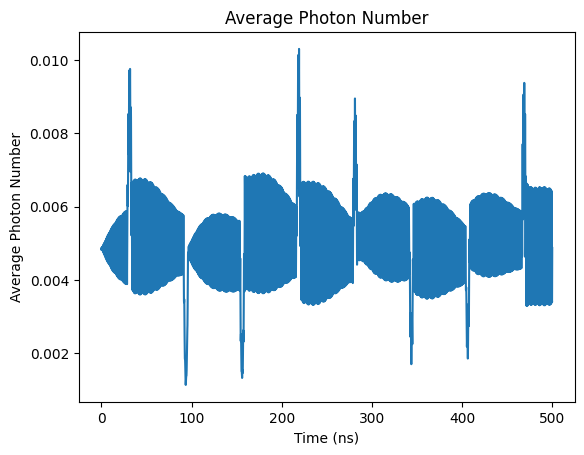

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

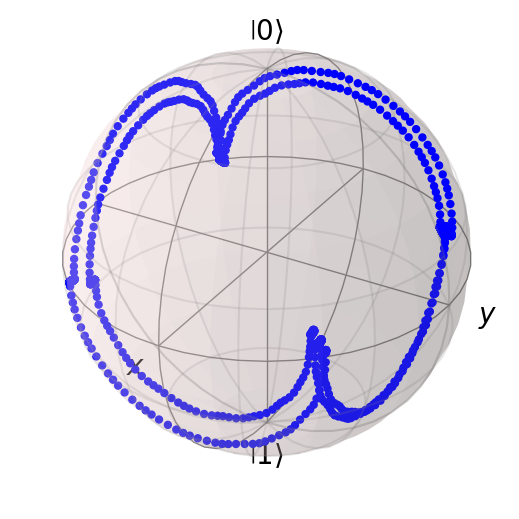

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## CP (N=16)

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, CP_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005258459059695086


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

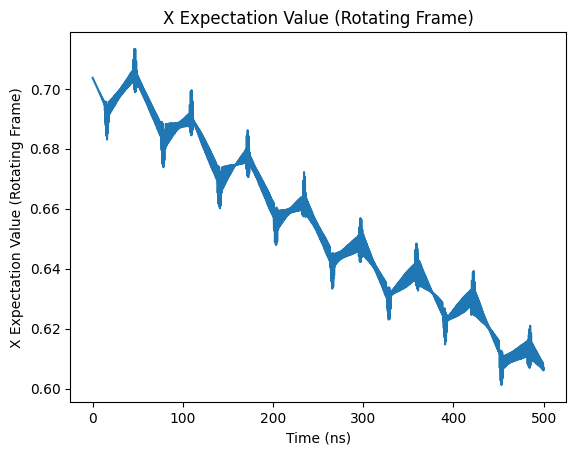

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

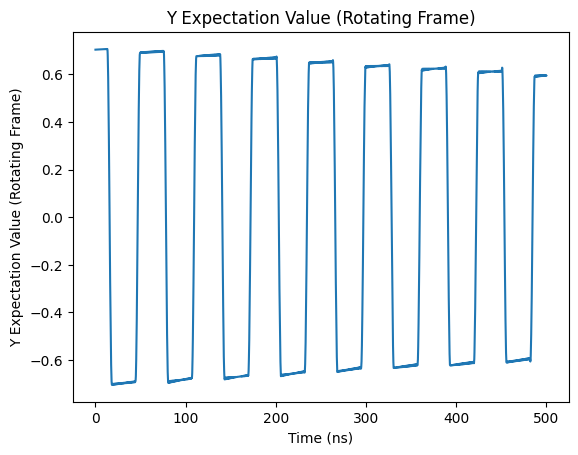

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

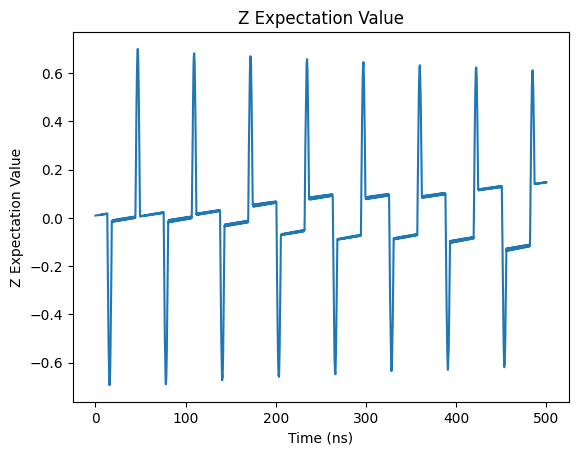

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

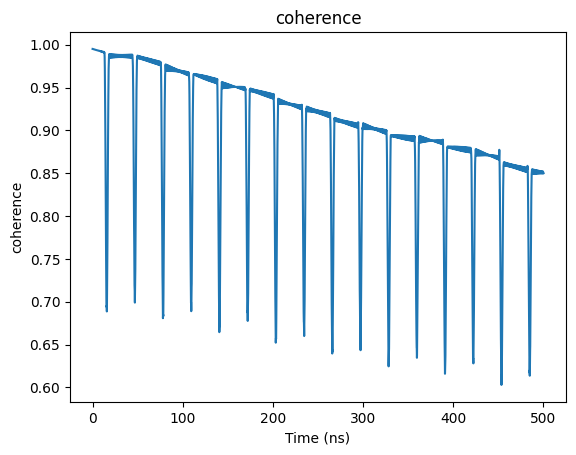

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

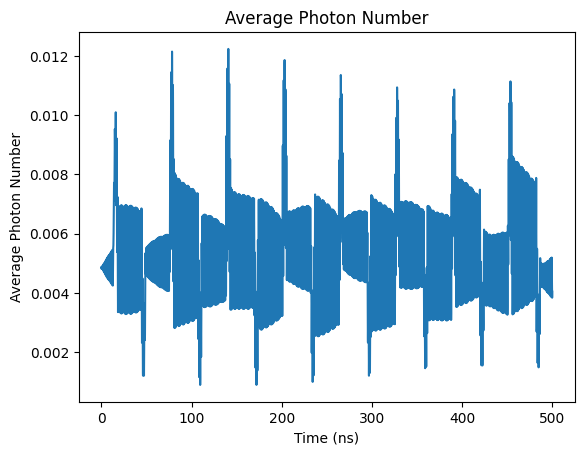

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

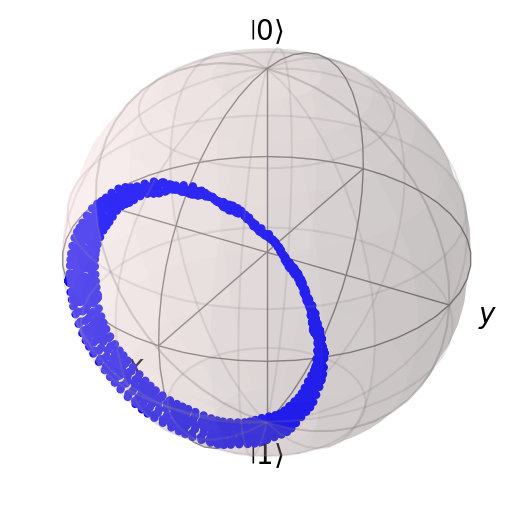

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## XY16

In [ ]:
# Simulation

N_seq = 16

result = mesolve(
    [H0, [H1, Hrd_lab_frame], [H2, XY16_lab_frame]],
    psi_2s,
    tlist,
    c_ops = [np.sqrt(kappa) * tensor(qeye(2), a)],
    args = {'A': A, 'T_srt_r': 0, 'T_end_r': 50000, 'Omega_rd': omega_rd, 'B': B, 'T_srt_q': 0, 'T_end_q': T_end_q, 'N_seq': N_seq, 'Omega_qd': omega_qd},
    e_ops = op_list,
)

x_rot = + np.cos(omega_qd*tlist) * result.expect[0] - np.sin(omega_qd*tlist) * result.expect[1]
y_rot = - np.sin(omega_qd*tlist) * result.expect[0] - np.cos(omega_qd*tlist) * result.expect[1]

print(np.mean(result.expect[4]))

0.005245869365500754


Text(0, 0.5, 'X Expectation Value (Rotating Frame)')

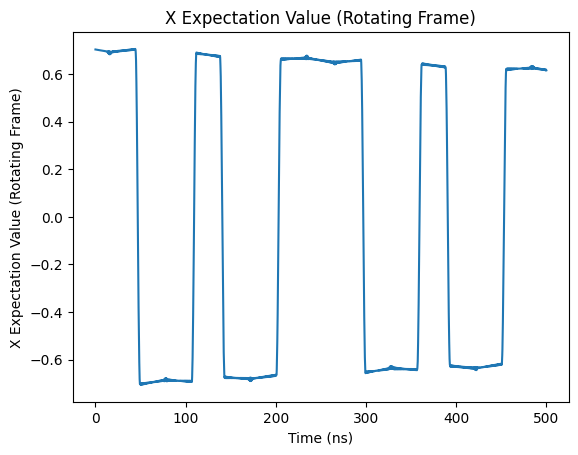

In [ ]:
# Plot Results

plt.plot(tlist, x_rot)

plt.title('X Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('X Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Y Expectation Value (Rotating Frame)')

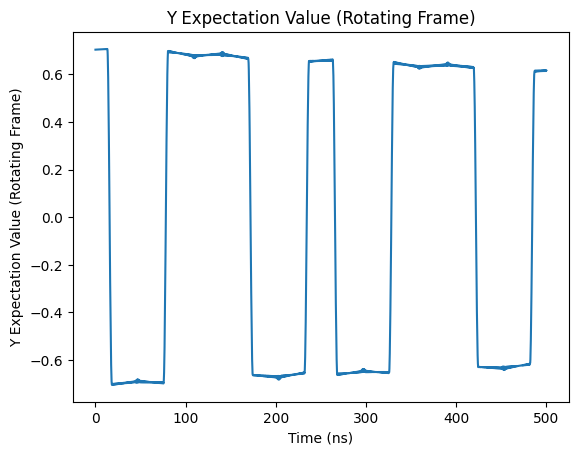

In [ ]:
# Plot Results

plt.plot(tlist, y_rot)

plt.title('Y Expectation Value (Rotating Frame)')
plt.xlabel('Time (ns)')
plt.ylabel('Y Expectation Value (Rotating Frame)')

Text(0, 0.5, 'Z Expectation Value')

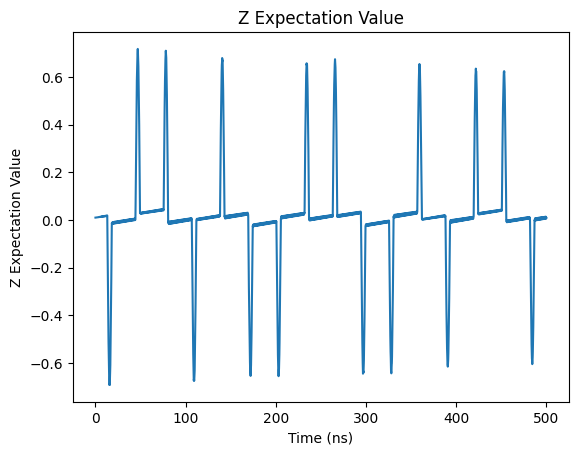

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[2])

plt.title('Z Expectation Value')
plt.xlabel('Time (ns)')
plt.ylabel('Z Expectation Value')

Text(0, 0.5, 'coherence')

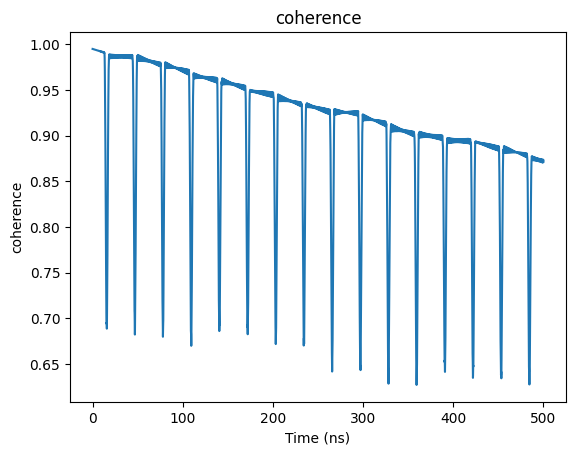

In [ ]:
# Plot Results

plt.plot(tlist, 2*np.abs(result.expect[3]), label = 'average photon number 0.0005')

plt.title('coherence')
plt.xlabel('Time (ns)')
plt.ylabel('coherence')

Text(0, 0.5, 'Average Photon Number')

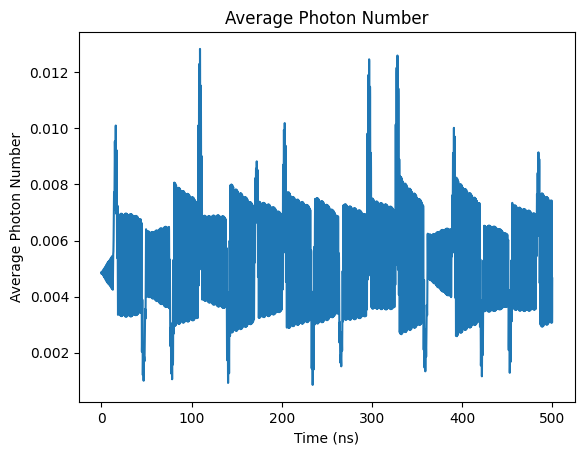

In [ ]:
# Plot Results

plt.plot(tlist, result.expect[4])

plt.title('Average Photon Number')
plt.xlabel('Time (ns)')
plt.ylabel('Average Photon Number')

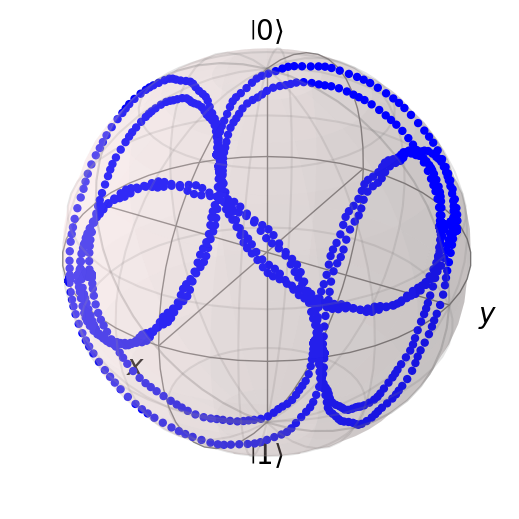

In [ ]:
sphere = Bloch()
sphere.zlabel = [r'$\left|0\right>$', r'$\left|1\right>$']
sphere.add_points(np.array([x_rot, y_rot, result.expect[2]]), meth="s")
sphere.show()

In [ ]:
avg = 0
for i in range(10):
  avg = avg + x_rot[-1-i]
avg = avg/10

x_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + y_rot[-1-i]
avg = avg/10

y_list.append(avg)


avg = 0
for i in range(10):
  avg = avg + result.expect[2][-1-i]
avg = avg/10

z_list.append(avg)

## Print Coherence & Z

In [ ]:
x_list

[0.3875540130277291,
 0.6032610433853887,
 0.6146743834620191,
 0.6209102057027738,
 0.6114785387412779,
 0.6062205846965896,
 0.6073552255680199,
 0.6176442701779389]

In [ ]:
y_list

[0.7558206930968472,
 0.6063336458321267,
 0.6127259268814764,
 0.6068095809004621,
 0.5981382779743158,
 0.6017252002861435,
 0.5959754379207942,
 0.6156681957601533]

In [ ]:
z_list

[0.2698490841577611,
 0.01838608308768405,
 0.04255810040796497,
 0.032784609684446755,
 0.07575023038297465,
 0.058633544123075344,
 0.14751036530072711,
 0.009575319292618466]